In [1]:
import pandas as pd
import numpy as np
import scipy
from pykalman.pykalman import *
import control

import matplotlib.pyplot as plt
import seaborn as sns
sns.set(font_scale=1.5)
from statannotations.Annotator import Annotator
import statsmodels.formula.api as smf
import statsmodels as stats

import prep_emotioncon 
import emotioncon_modelling
import emotioncon_stats
import auxiliary

In [2]:
emo = emotioncon_modelling.Modelling()
emostats = emotioncon_stats.Statistics()
prep = prep_emotioncon.PrepEmotioncon()
aux = auxiliary.Auxiliary()
attention_cr = np.array([1, 0, 0, 1, 1, 1, 1, 0, 0, 0])
mood_categories = ['disgusted', 'amused', 'calm', 'anxious', 'sad']
filepath = '../'
savefig = True
palette= {0: "plum", 1: "purple", 2: "lightgrey", 3: "grey"}

In [3]:
# make inputs ready
input_df = pd.read_csv(filepath + 'experiment/public/prep/videosForExperiment.csv')
inp_dummies = pd.get_dummies(input_df['category'])
inp_dummies = inp_dummies.reindex(columns=['Disgust', 'Amusement', 'Calmness', 'Anxiety', 'Sadness'])
inp = inp_dummies.values
inp = np.vstack([np.zeros(np.shape(inp)[1]), inp, np.zeros(np.shape(inp)[1]), inp])

In [4]:
# define option for modelling
def define_kf_options(data, inp):
    options = {'cov': 'diagonal', 'inputs' : True, 'inp': inp}
    options['n_dim_obs'] = np.shape(data)[1]
    options['n_dim_state'] = options['n_dim_obs']
    options['n_dim_control'] = np.shape(inp)[1]
    options['maxiter'] = 100
    options['constraint control'] = False
    options['em_vars'] = ['transition_matrices', 'transition_offsets', 'control_matrix', \
                          'observation_covariance', 'transition_covariance']
    options['A'] = np.zeros((options['n_dim_state'],options['n_dim_state']))
    options['h'] = np.zeros(options['n_dim_state'])
    options['C'] = np.zeros((options['n_dim_state'],options['n_dim_control']))
    return options

In [5]:
sns.set(font_scale=1.5)
data = np.load(filepath + 'results/data_experiment.npy',allow_pickle='TRUE')
df, mood_ratings, foo = prep.create_df_from_dict(data)
Nsj = len(data)
print('N = ' + str(Nsj))

N = 108


In [6]:
v1 = data[0]['datadoc']['video_path'][1:-1].split(',')
v2 = data[1]['datadoc']['video_path'][1:-1].split(',')

In [7]:
cowen_ratings = pd.read_csv(filepath + '/experiment/public/videos/videosRatingsCowenKeltner.csv')
cr = np.zeros((5,108,2))
for j, i in enumerate(v1):
        cr[:, j, 0] = \
        cowen_ratings[['Disgust', 'Amusement', 'Calmness', 'Anxiety', 'Sadness']]\
        [cowen_ratings['videoID'] == i[9:-2]].values[0]
for j, i in enumerate(v2):
    cr[:,j,1] = \
    cowen_ratings[['Disgust', 'Amusement', 'Calmness', 'Anxiety', 'Sadness']]\
    [cowen_ratings['videoID'] == i[9:-2]].values[0]
    
# np.insert(a, 1, np.array((1, 1)), 0) 

In [8]:
new_cr = np.zeros((5, 110, 2))

# Insert the original matrix into the new matrix
new_cr[:, 1:55, :] = cr[:, :54, :]
new_cr[:, 56:, :] = cr[:, 54:, :]

In [9]:
cr = new_cr
cr.shape

(5, 110, 2)

----------------------------------------------------------------------------------------------------
Model Comparison:
--
- only noise: S and G diag, no transition matrix, no control
- dynamics + noise: S and G diag, control matrix
- control + noise: S and G diag, control matrix
- control, dynamics + noise: S and G, transition and control matrix

In [10]:
# fit KF using different parameter constellations
fitting_combinations = [['S', 'G'], ['A', 'S', 'G'], ['A', 'h', 'S', 'G'], ['C', 'S', 'G'], \
                        ['A', 'C', 'S', 'G'], ['A', 'h', 'C', 'S', 'G']]
fitting_combinations_C = [i for i in fitting_combinations if 'C' in i]   
Nsj = np.shape(mood_ratings)[2]
ll_all_subjects = np.empty((len(fitting_combinations + fitting_combinations_C),Nsj))
results = []
for sj in range(Nsj):
    if df['randomized_videoset'][sj] == 0:
        inp = cr[:,:,0].T
    else:
        inp = cr[:,:,1].T
    data_to_fit = mood_ratings[:,:,sj]
    T = np.shape(data_to_fit)[0]
    opt = define_kf_options(data_to_fit, inp)
    results = []
    for j,i in enumerate(fitting_combinations):
        opt['em_vars'] = emo.parameter_short(i)
        kf_alldata = emo.run_KF(data_to_fit, opt)
        ll_all_subjects[j,sj] = kf_alldata.loglikelihood(data_to_fit, control_inputs=inp)
        results.append(kf_alldata)
        
    for j,i in enumerate(fitting_combinations_C):
        opt['constraint control'] = True
        opt['em_vars'] = emo.parameter_short(i)
        kf_alldata = emo.run_KF(data_to_fit, opt)
        ll_all_subjects[j+len(fitting_combinations),sj] = kf_alldata.loglikelihood(data_to_fit, control_inputs=inp)
        results.append(kf_alldata)

    data[sj]['results'] = results
    data[sj]['ll'] = ll_all_subjects[:,sj]

# np.save(filepath + 'results/fit_experiment.npy', data)

In [11]:
# loglikelihood
ll_all_subjects = np.empty((len(data[0]['ll']),Nsj))
for i in range(Nsj):
    ll_all_subjects[:,i] = data[i]['ll']
np.mean(ll_all_subjects,axis=1)

array([-2724.98361113, -2350.73165471, -2343.31716843, -2380.23078374,
       -2213.67875471, -2208.23752358, -2559.34850355, -2326.13536664,
       -2322.73994118])

In [12]:
# bestmodel mainly driven by only a few participants
Ndatapoints = np.prod(np.shape(data[0]['ratings']))
bic,bestmodel=[],[]
for i in range(Nsj):
    a, b = emo.AICBIC_calc(ll_all_subjects[:,i], Ndatapoints*np.ones(len(data[0]['ll'])), \
                np.array([10, 35, 40, 35, 60, 65, 40, 45, 50]))
    bestmodel.append(np.where(b==min(b))[0])
    bic.append(b)
np.histogram(bestmodel,range=(0,len(data[0]['ll'])), bins=len(data[0]['ll']))

(array([ 0, 25,  0, 18, 59,  2,  0,  4,  0]),
 array([0., 1., 2., 3., 4., 5., 6., 7., 8., 9.]))

In [13]:
# calculate AIC and BIC 
Ndatapoints = np.prod(np.shape(mood_ratings)[:2])
aic, bic = emo.AICBIC_calc(np.nanmean(ll_all_subjects,axis=1), Ndatapoints*np.ones(len(data[0]['ll'])), \
                np.array([10, 35, 40, 35, 60, 65, 40, 45, 50]))
np.round(bic,2)

array([5513.07, 4922.31, 4939.03, 4981.31, 4805.95, 4826.62, 5371.09,
       4936.22, 4960.98])

In [15]:
# evidence ratio 
for i in range(len(bic)):
    print(np.round(np.exp(-0.5*(bic[i]-min(bic))))/np.exp(-0.5*(bic[i]-min(bic))))

0.0
0.0
0.0
0.0
1.0
0.0
0.0
0.0
0.0


In [16]:
# accumulative weight
for i in range(len(bic)):
    print(np.exp(-(bic[i]-min(bic)))/sum(np.exp(-(bic-min(bic)))))

8.023780609002168e-308
2.9270547073352403e-51
1.602353529292673e-58
6.979316948607165e-77
0.9999999989422577
1.0577422627609453e-09
3.6502686099975985e-246
2.6721959758518967e-57
4.723717753086333e-68


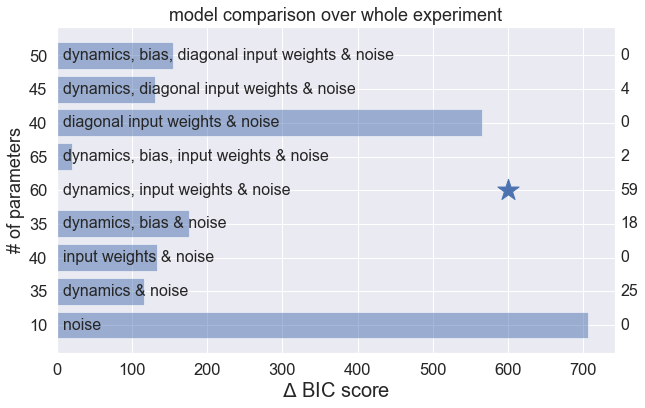

In [17]:
# plot BIC 
sns.set(font_scale=1.5)

fitting_labels = ['dynamics, bias, diagonal input weights & noise', \
                  'dynamics, diagonal input weights & noise', \
                  'diagonal input weights & noise', \
                  'dynamics, bias, input weights & noise', \
                  'dynamics, input weights & noise', \
                  'dynamics, bias & noise', \
                  'input weights & noise', \
                  'dynamics & noise', \
                  'noise']
fig, ax = plt.subplots(figsize=(10, 6))
b = ax.barh(np.arange(len(bic)), np.squeeze(np.array(bic - min(bic))), align='center', alpha=0.5)
ax.set_yticks(range(len(data[0]['ll'])))
ax.set_yticks(range(len(fitting_labels)))
ax.set_yticklabels([10, 35, 40, 35, 60, 65, 40, 45, 50])
ax.set_ylabel('# of parameters')
ax.set_xlabel('$\Delta$ BIC score', fontsize=20);
for bar, label in zip(ax.patches, fitting_labels[::-1]):
    ax.text(8, bar.get_y()+bar.get_height()/2, label, ha = 'left', va = 'center', size=16) 
for i in range(len(fitting_labels)):
    ax.text(750, i, sum(np.array(bestmodel)==i)[0], ha = 'left', va = 'center', size=16) 
ax.set_xlabel('$\Delta$ BIC score', fontsize=20);
ax.scatter(600, np.where(np.squeeze(np.array(bic - min(bic)))==0), marker = '*', s=500, \
          color=b.patches[0].get_facecolor()[:-1])
ax.set_title('model comparison over whole experiment');

----------------------------------------------------------------------------------------------------
Model Comparison before and after:
--
- all parameter same
- dynamics matrix differs before and after
- control matrix differs before and after
- control and dynamics matrices differ before and after
- noise covariances differ before and after
- dynamics matrix and noise covariances differ before and after
- control matrix and noise covariances differ before and after
- control, dynamics matrices, and noise covariances differ before and after

In [20]:
# fit KF using different parameter constellations before and after intervention
fitting_combinations =  [['A'], ['C'], ['A', 'C'], ['S', 'G'], ['A', 'S', 'G'], ['C', 'S', 'G'], ['A', 'C', 'S', 'G']]
Nsj = np.shape(mood_ratings)[2]
ll_all_subjects = np.empty((len(fitting_combinations)+1,Nsj))
for sj in range(Nsj):
    if df['randomized_videoset'][sj] == 0:
        inp = cr[:,:,0].T
    else:
        inp = cr[:,:,1].T
    data_to_fit = mood_ratings[:,:,sj]
    T = np.shape(data_to_fit)[0]
    opt = define_kf_options(data_to_fit, inp)
    opt['em_vars'] = emo.parameter_short(['A', 'C', 'S', 'G'])
    kf_alldata = emo.run_KF(data_to_fit, opt)
    ll = [kf_alldata.loglikelihood(data_to_fit, control_inputs=inp)]
    results = [kf_alldata]
    opt = emo.save_kf_options(kf_alldata, opt)
    for i in fitting_combinations:
        ll_split = 0
        for t in range(2):
            mood_ratings_split = data_to_fit[t*int(T/2):t*int(T/2) + int(T/2),:]
            inputs_split = inp[t*int(T/2):t*int(T/2) + int(T/2),:]
            opt['inp'] = inputs_split 
            opt['em_vars'] = emo.parameter_short(i)
            kf = emo.run_KF(mood_ratings_split, opt)
            ll_split += kf.loglikelihood(mood_ratings_split, control_inputs=inputs_split)
            results.append(kf)
        ll.append(ll_split)
    
    ll_all_subjects[:,sj] = np.asarray(ll)
    data[sj]['results_split'] = results
    data[sj]['ll_split'] = ll_all_subjects[:,sj]
    
# np.save(filepath + 'results/fit_experiment.npy', data)

In [21]:
# loglikelihood
ll_all_subjects = np.empty((len(data[0]['ll_split']),Nsj))
for i in range(Nsj):
    ll_all_subjects[:,i] = data[i]['ll_split']
np.mean(ll_all_subjects,axis=1)

array([-2213.67875471, -2186.90951457, -2184.40573419, -2153.62379241,
       -2187.6444804 , -2150.70054318, -2135.21497148, -2048.70959744])

In [22]:
# bestmodel mainly driven by only a few participants
Ndatapoints = np.prod(np.shape(data[0]['ratings']))
bic,bestmodel=[],[]
for i in range(Nsj):
    a, b = emo.AICBIC_calc(ll_all_subjects[:,i], Ndatapoints*np.ones(len(data[0]['ll_split'])), \
                np.array([60, 85, 85, 110, 70, 95, 95, 120]))
    bestmodel.append(np.where(b==min(b))[0])
    bic.append(b)
for g in range(2):
    print(np.histogram(np.array(bestmodel)[df['randomized_condition']==g], range=(0,len(data[0]['ll_split'])), bins=len(data[0]['ll_split'])))

(array([44,  0,  0,  0,  6,  0,  1,  0]), array([0., 1., 2., 3., 4., 5., 6., 7., 8.]))
(array([28,  0,  0,  0,  9,  1,  7, 12]), array([0., 1., 2., 3., 4., 5., 6., 7., 8.]))


In [23]:
# those participants on average seem to successfully apply the strategy based on self-report
x = np.squeeze(np.array(bestmodel) > 5)
df['intervention_success'][x & (df['randomized_condition']==0)].mean(), \
df['intervention_success'][~x & (df['randomized_condition']==0)].mean()

(4.0, 2.14)

In [24]:
# calculate AIC and BIC
aic, bic = emo.AICBIC_calc(np.nanmean(ll_all_subjects,axis=1), Ndatapoints*np.ones(len(data[0]['ll_split'])), \
                np.array([60, 85, 85, 110, 70, 95, 95, 120]))
aic,bic

(array([4547.35750941, 4543.81902914, 4538.81146839, 4527.24758483,
        4515.2889608 , 4491.40108635, 4460.42994296, 4337.41919489]),
 array([4805.95260611, 4910.16208278, 4905.15452204, 5001.33859543,
        4816.98324028, 4900.84332278, 4869.87217939, 4854.60938827]))

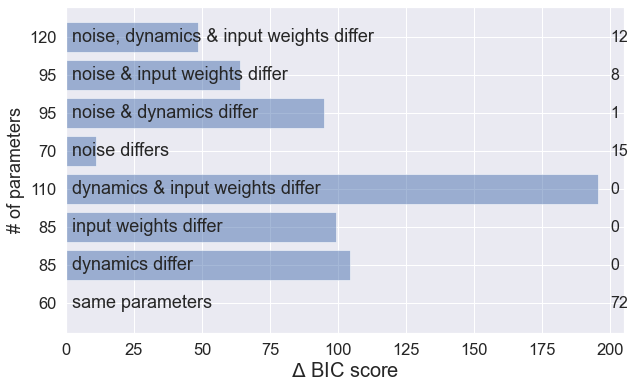

In [25]:
# bic all data
fitting_labels = ['noise, dynamics & input weights differ', \
                  'noise & input weights differ', \
                  'noise & dynamics differ', \
                  'noise differs', \
                  'dynamics & input weights differ', \
                  'input weights differ', \
                  'dynamics differ', \
                  'same parameters']
fig, ax = plt.subplots(figsize=(10, 6))
ax.barh(np.arange(len(bic)), np.squeeze(np.array(bic - min(bic))), align='center', alpha=0.5)
ax.set_yticks(range(len(fitting_labels)))
ax.set_yticklabels([60, 85, 85, 110, 70, 95, 95, 120])
ax.set_ylabel('# of parameters')
ax.set_xlabel('$\Delta$ BIC score', fontsize=20);
for bar, label in zip(ax.patches, fitting_labels[::-1]):
    ax.text(2, bar.get_y()+bar.get_height()/2, label, ha = 'left', va = 'center', size=18)
for i in range(len(fitting_labels)):
    ax.text(200, i, sum(np.array(bestmodel)==i)[0], ha = 'left', va = 'center', size=16) 

[4937.60307368 5048.42241932 5054.57994666 5160.63383025 4968.11376012
 5066.63860397 5072.42404323 5158.33672877]
[1.00000000e+00 7.44337157e-49 1.57612099e-51 1.37712426e-97
 5.61535530e-14 9.13232215e-57 2.80541349e-59 1.36959331e-96]
[4688.16008249 4786.45546588 4771.45808948 4858.81128007 4681.76119621
 4752.50017645 4688.64156437 4582.85334678]
[1.84444528e-046 3.77331595e-089 1.23027157e-082 1.42230369e-120
 1.10883462e-043 2.10531945e-074 1.13962207e-046 1.00000000e+000]


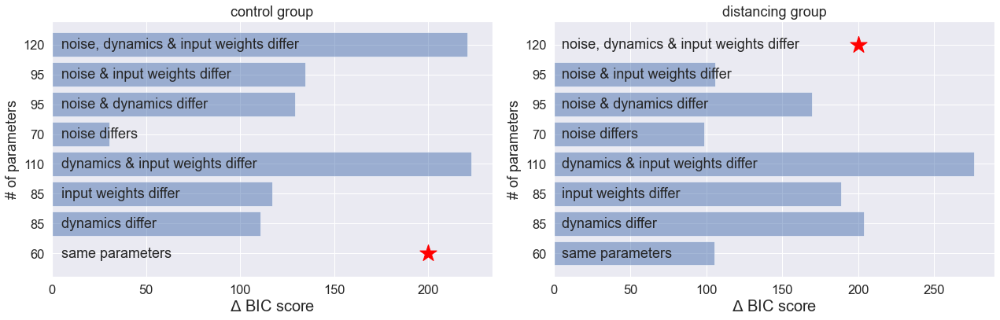

In [26]:
# bic separated for intervention condition
fig, ax = plt.subplots(1,2,figsize=(18, 6))
condition_label = ['control group', 'distancing group']
for i in range(2):
    aic, bic = emo.AICBIC_calc(np.nanmean(ll_all_subjects[:,df['randomized_condition']==i],axis=1), Ndatapoints*np.ones(len(data[0]['ll_split'])), \
                np.array([60, 85, 85, 110, 70, 95, 95, 120]))
    print(bic)
    print(np.exp(-(bic-min(bic)))/sum(np.exp(-(bic-min(bic)))))
    ax[i].barh(np.arange(len(bic)), np.squeeze(np.array(bic - min(bic))), align='center', alpha=0.5)
    ax[i].set_xlabel('$\Delta$ BIC score', fontsize=20);
    ax[i].set_title(condition_label[i])
    ax[i].set_yticks(range(len(fitting_labels)))
    ax[i].set_yticklabels([60, 85, 85, 110, 70, 95, 95, 120])
    ax[i].set_ylabel('# of parameters')
    ax[i].set_xlabel('$\Delta$ BIC score', fontsize=20);
    for bar, label in zip(ax[i].patches, fitting_labels[::-1]):
        ax[i].text(5, bar.get_y()+bar.get_height()/2, label, ha = 'left', va = 'center', size=18)
    ax[i].scatter(200, np.where(np.squeeze(np.array(bic - min(bic)))==0), marker = '*', s=500, color='red')
fig.tight_layout()

0 1.0


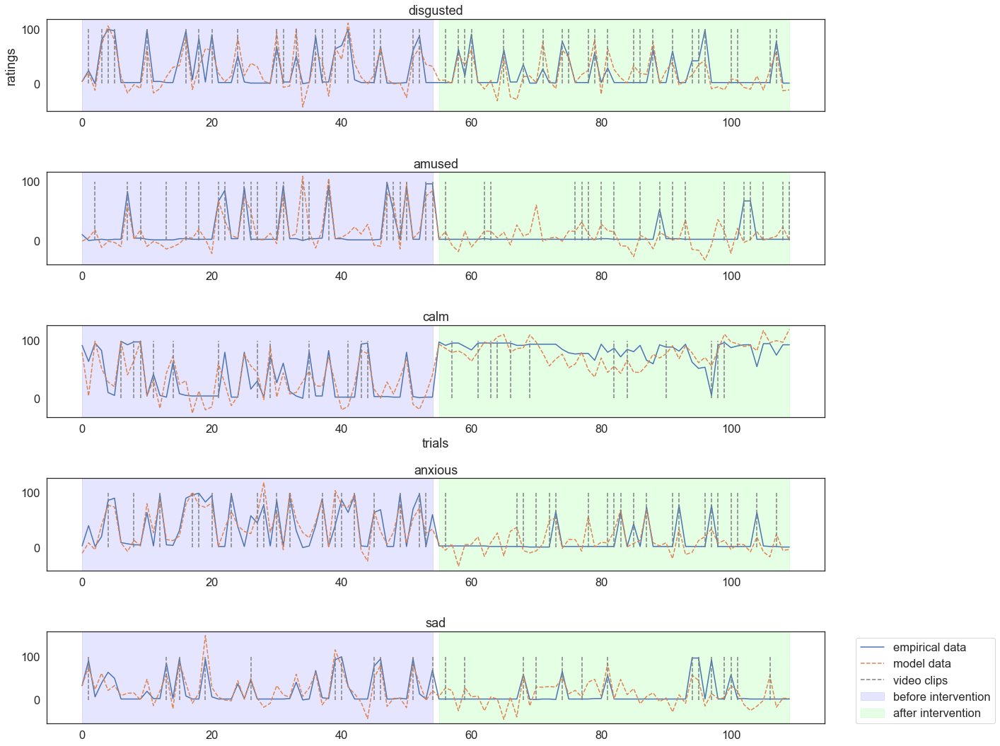

----------------------------------------------------------------------------------------------------
1 1.0


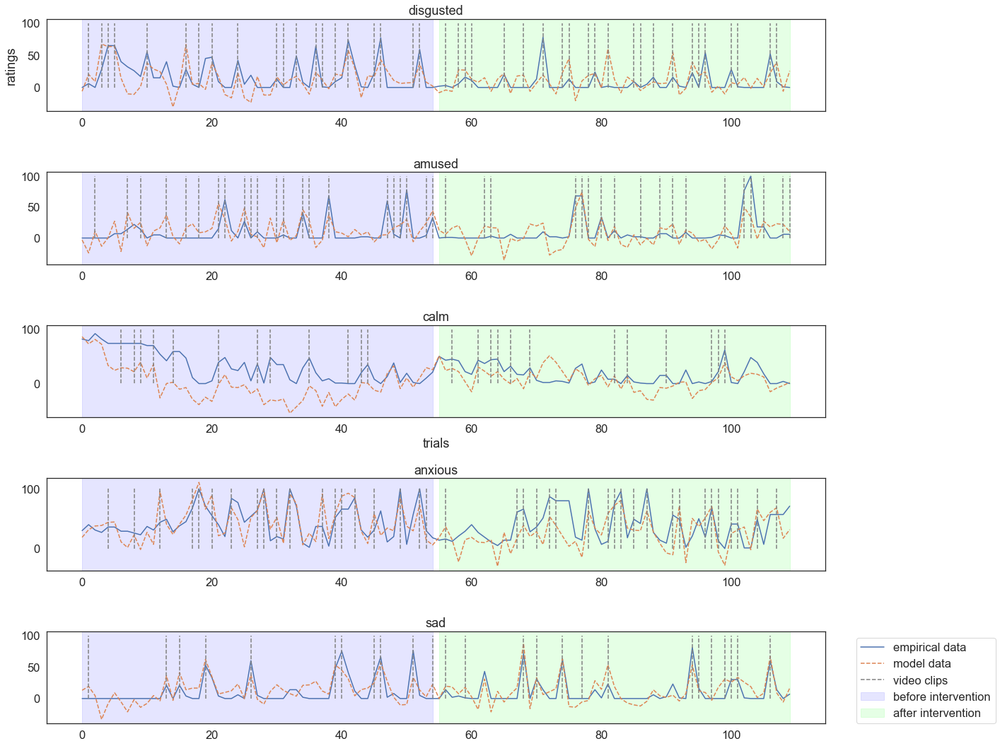

----------------------------------------------------------------------------------------------------
2 1.0


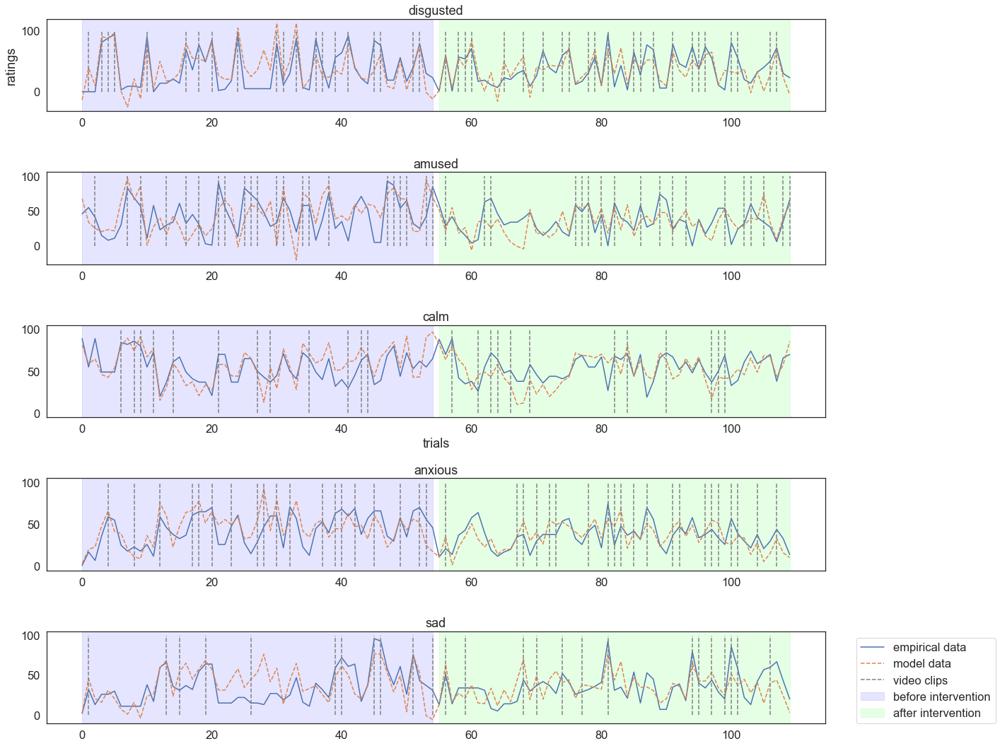

----------------------------------------------------------------------------------------------------
3 0.0


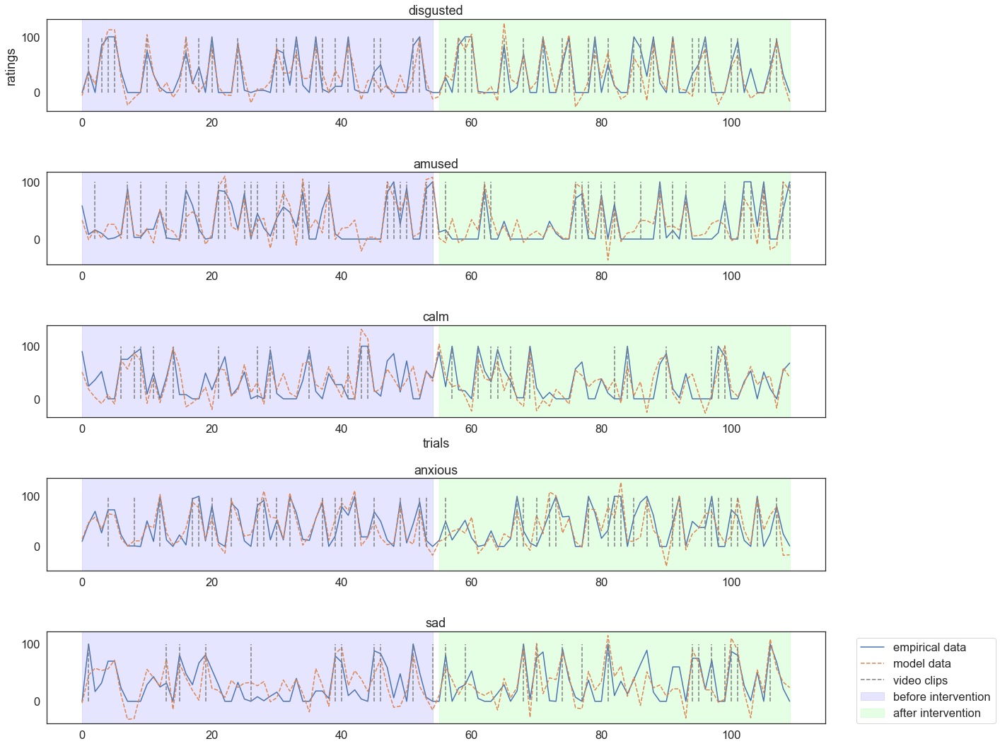

----------------------------------------------------------------------------------------------------
4 1.0


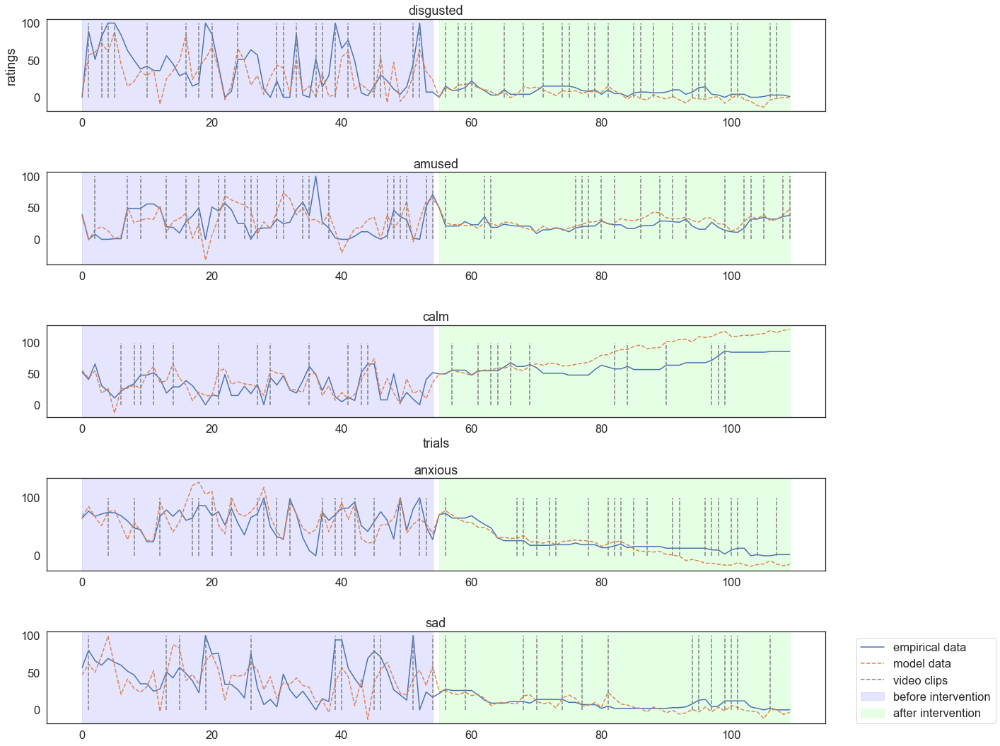

----------------------------------------------------------------------------------------------------
5 0.0


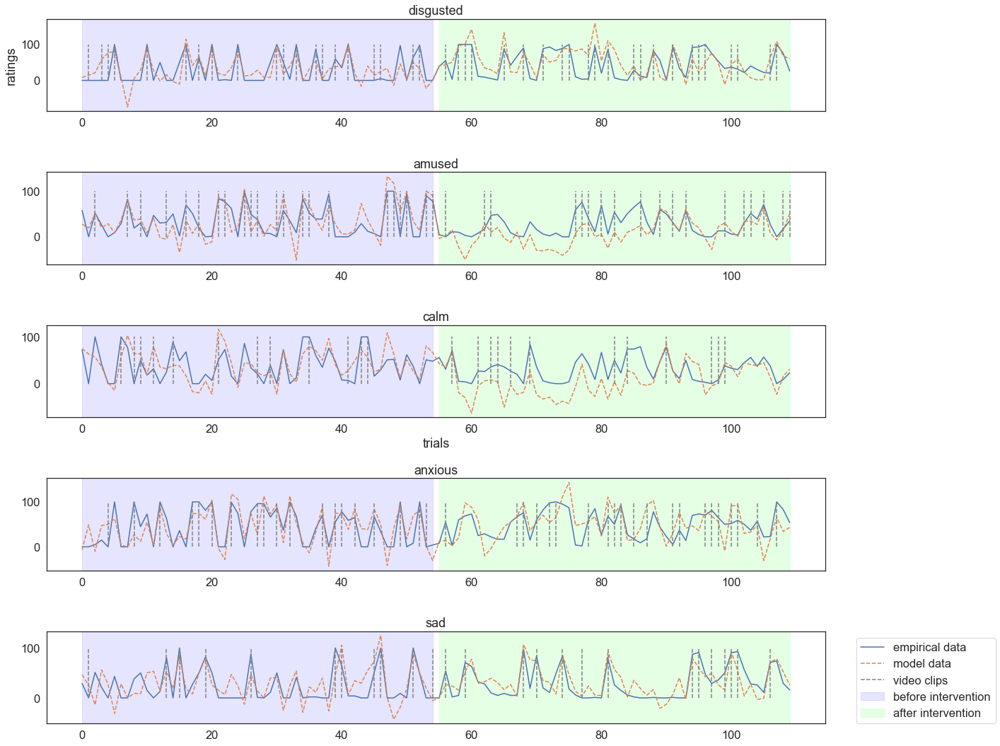

----------------------------------------------------------------------------------------------------
6 1.0


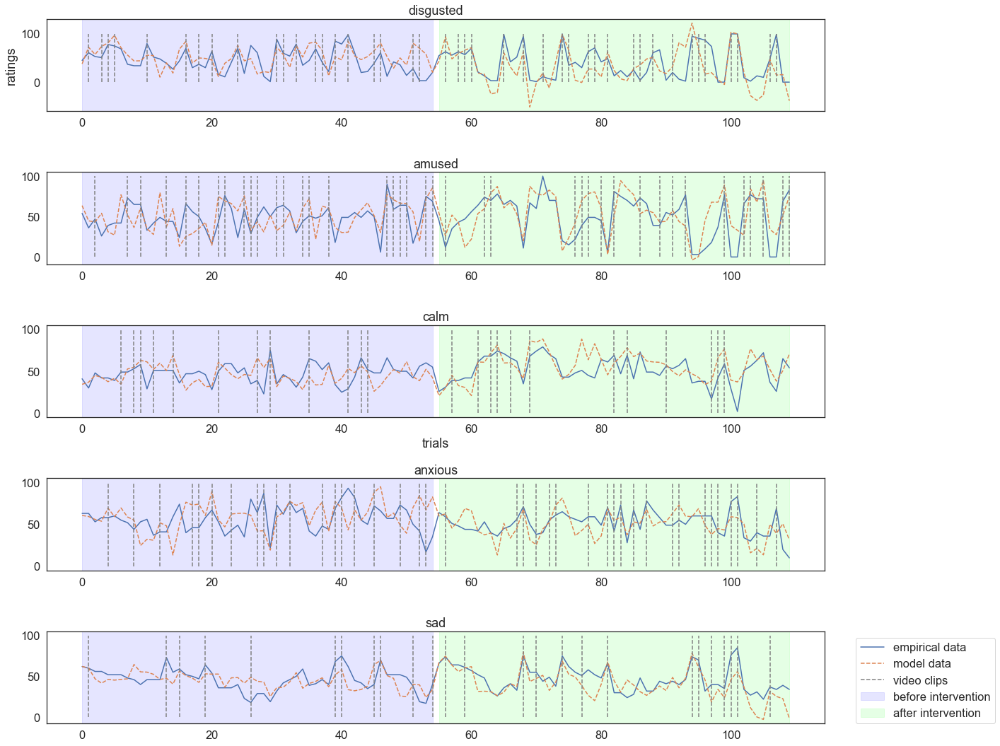

----------------------------------------------------------------------------------------------------
7 0.0


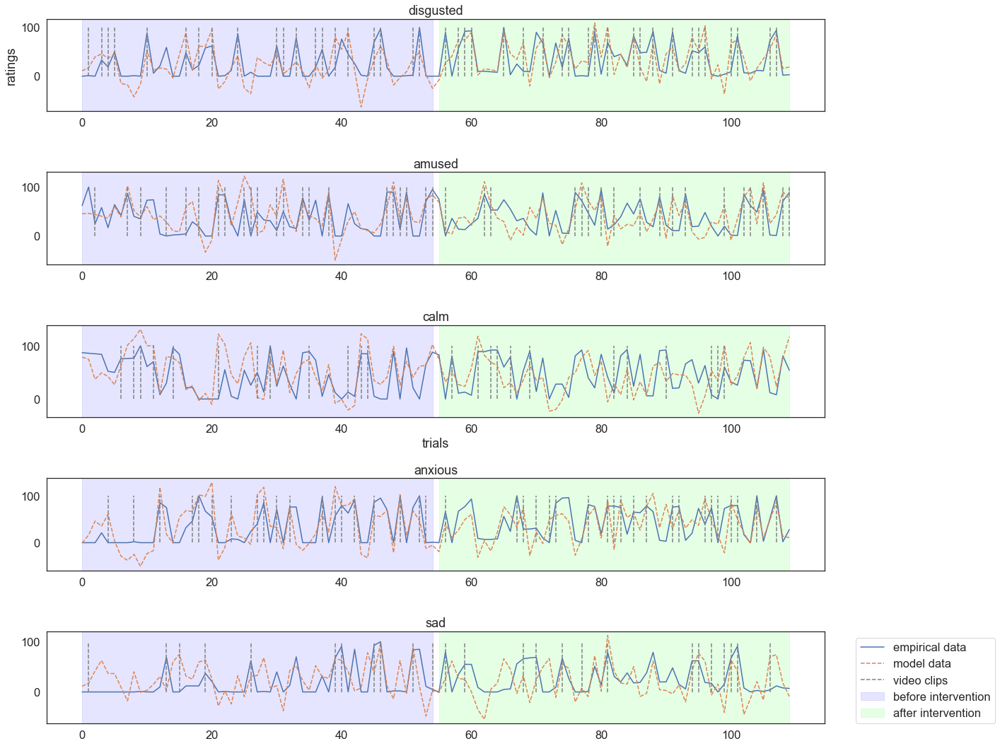

----------------------------------------------------------------------------------------------------
8 0.0


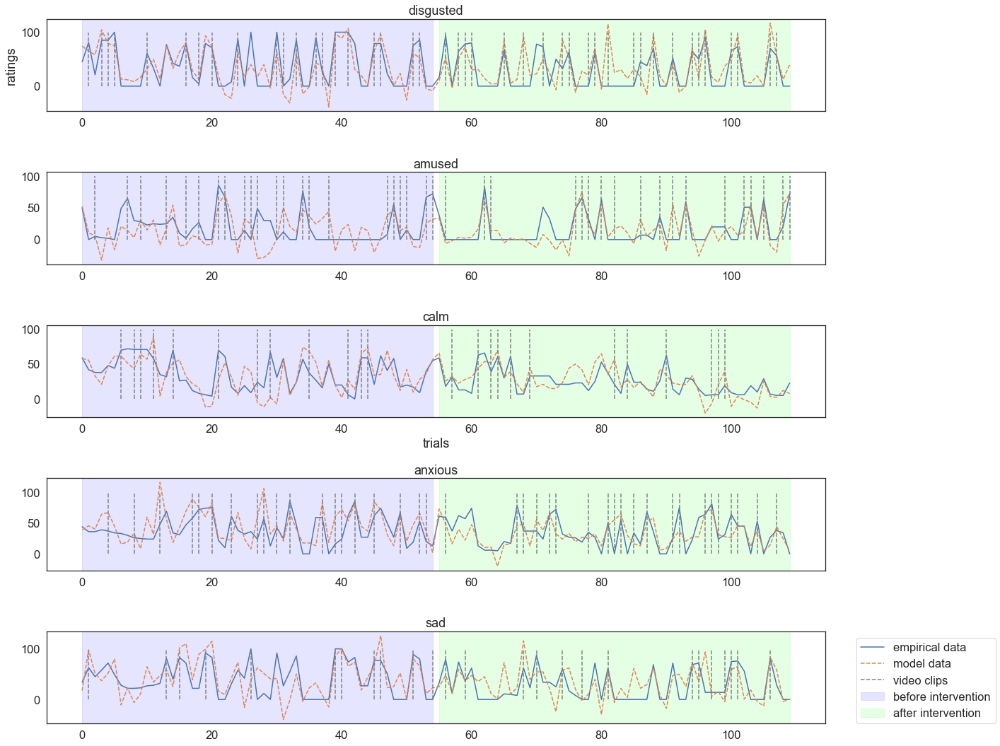

----------------------------------------------------------------------------------------------------
9 0.0


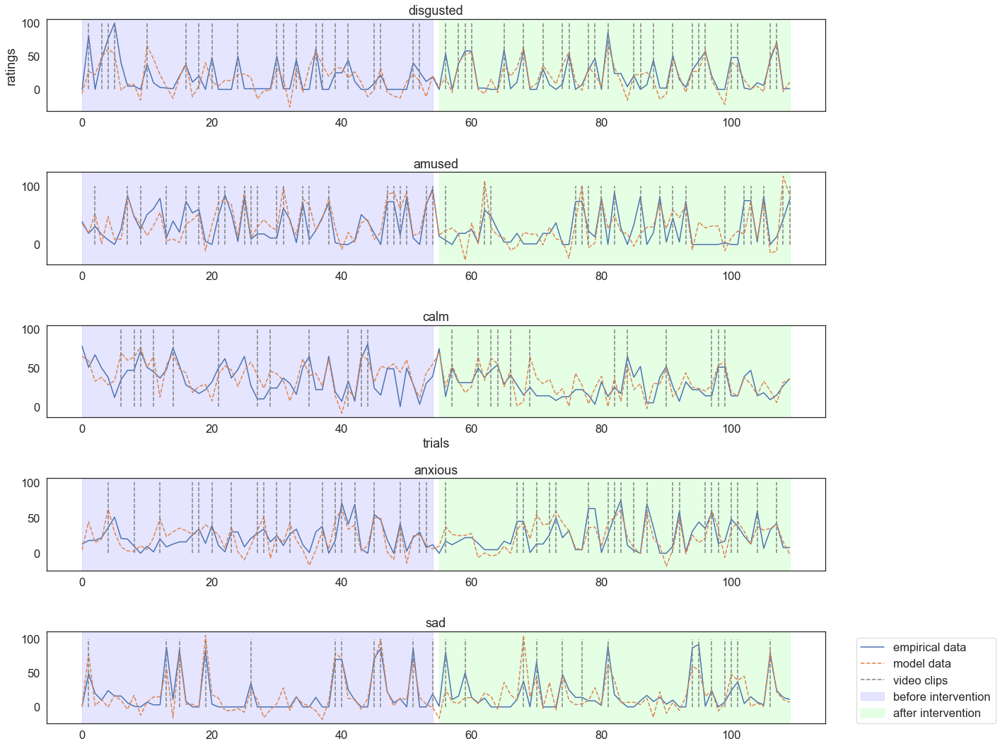

----------------------------------------------------------------------------------------------------
10 0.0


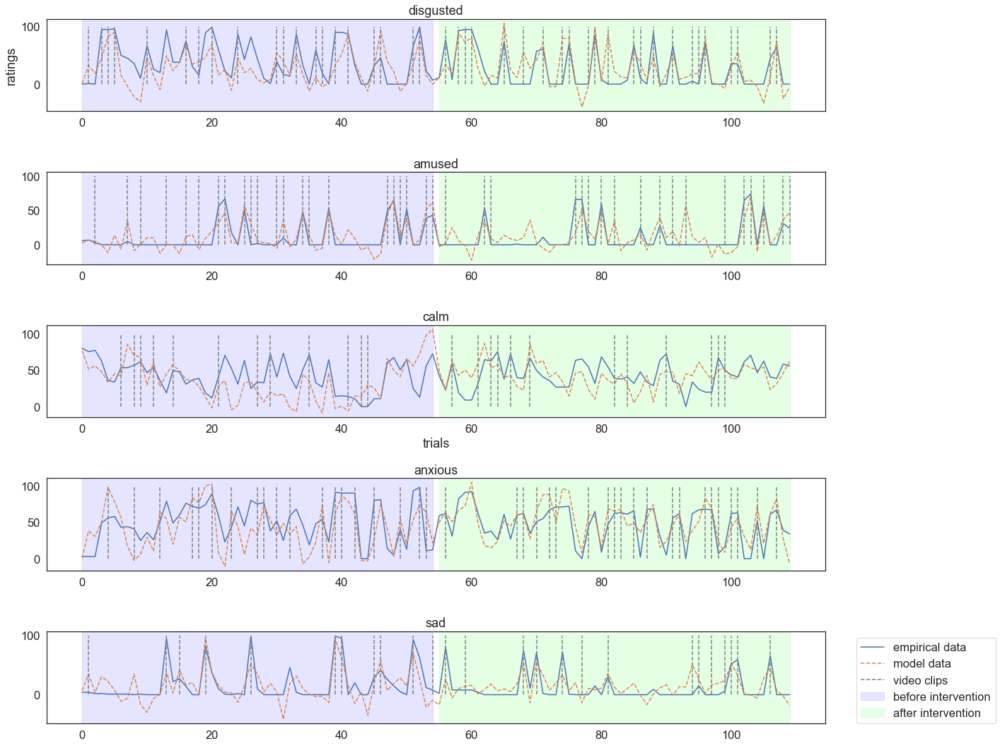

----------------------------------------------------------------------------------------------------
11 1.0


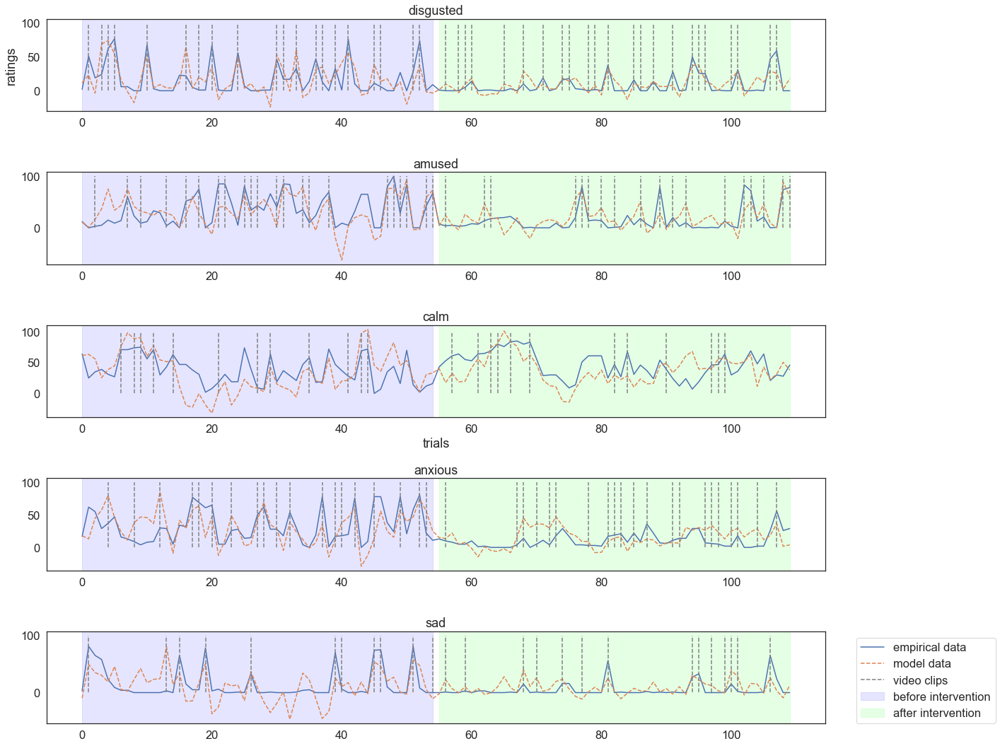

----------------------------------------------------------------------------------------------------
12 1.0


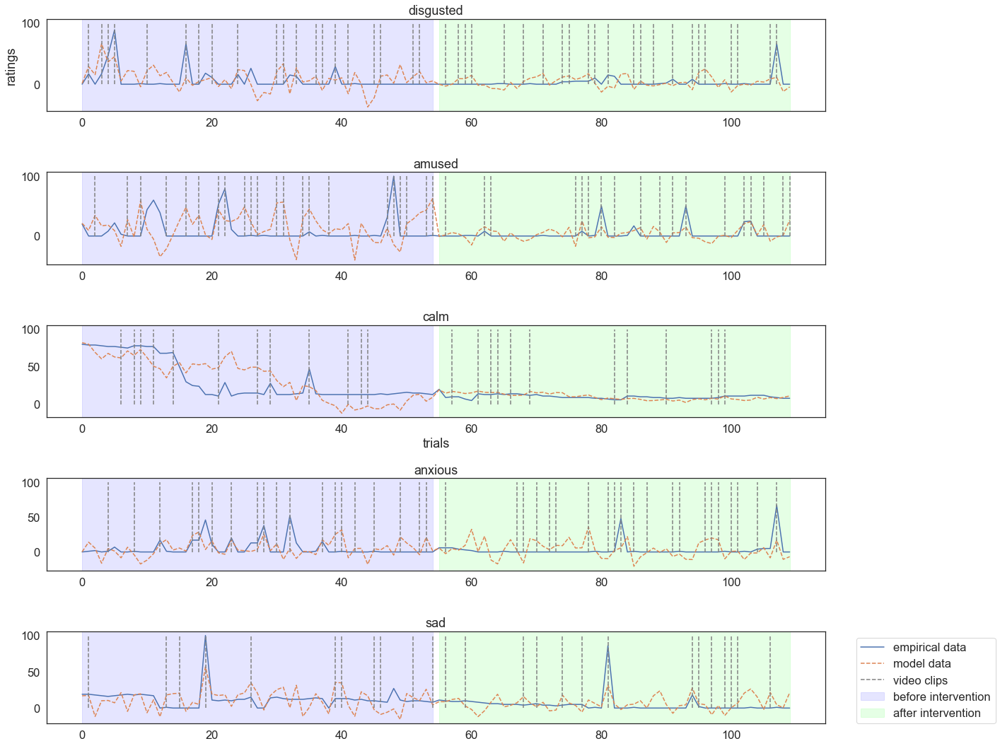

----------------------------------------------------------------------------------------------------
13 0.0


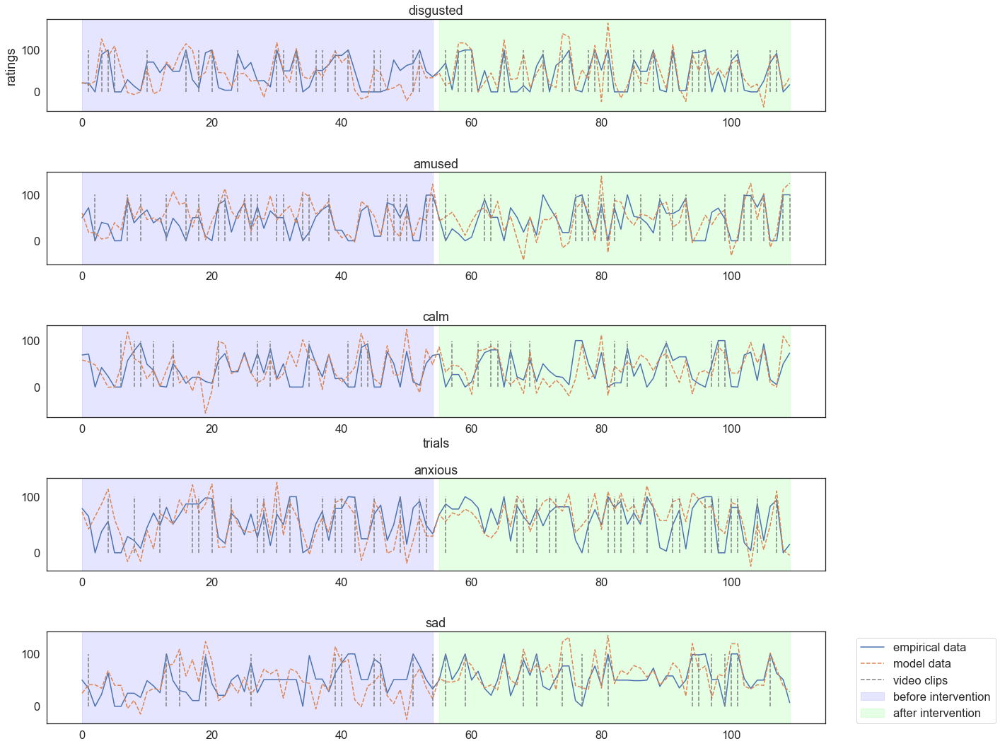

----------------------------------------------------------------------------------------------------
14 0.0


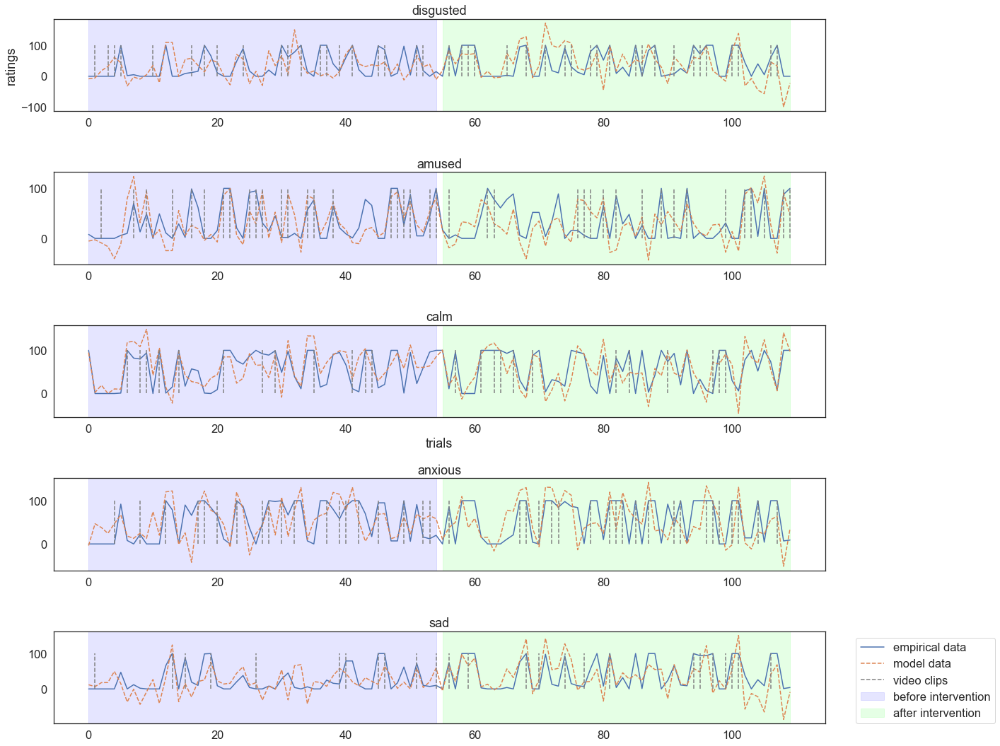

----------------------------------------------------------------------------------------------------
15 1.0


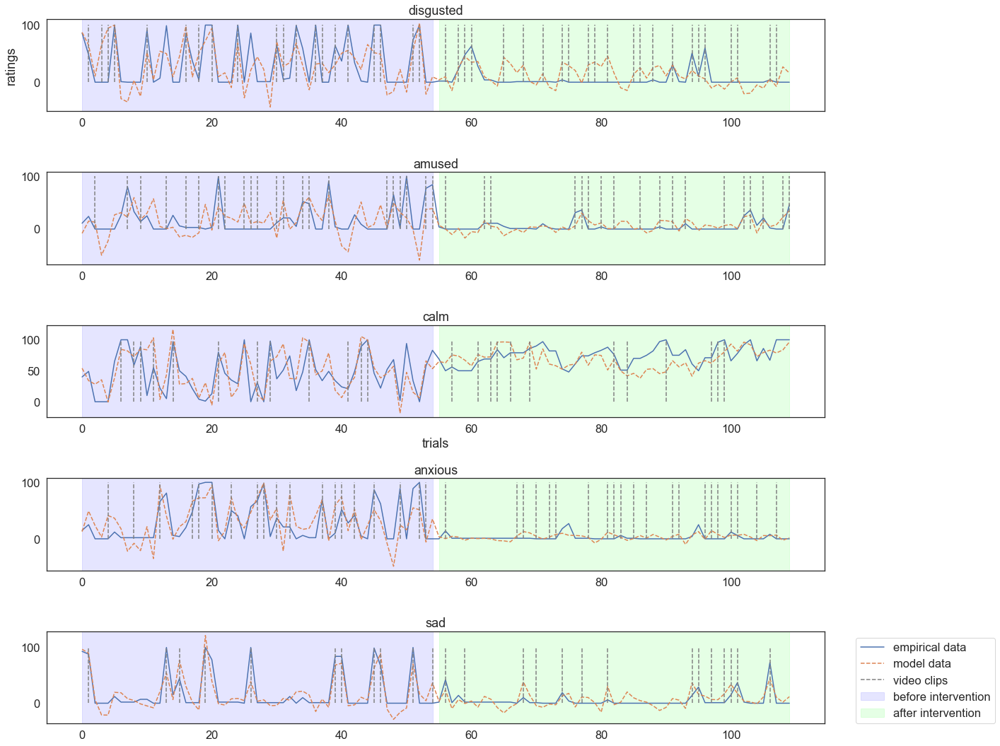

----------------------------------------------------------------------------------------------------
16 0.0


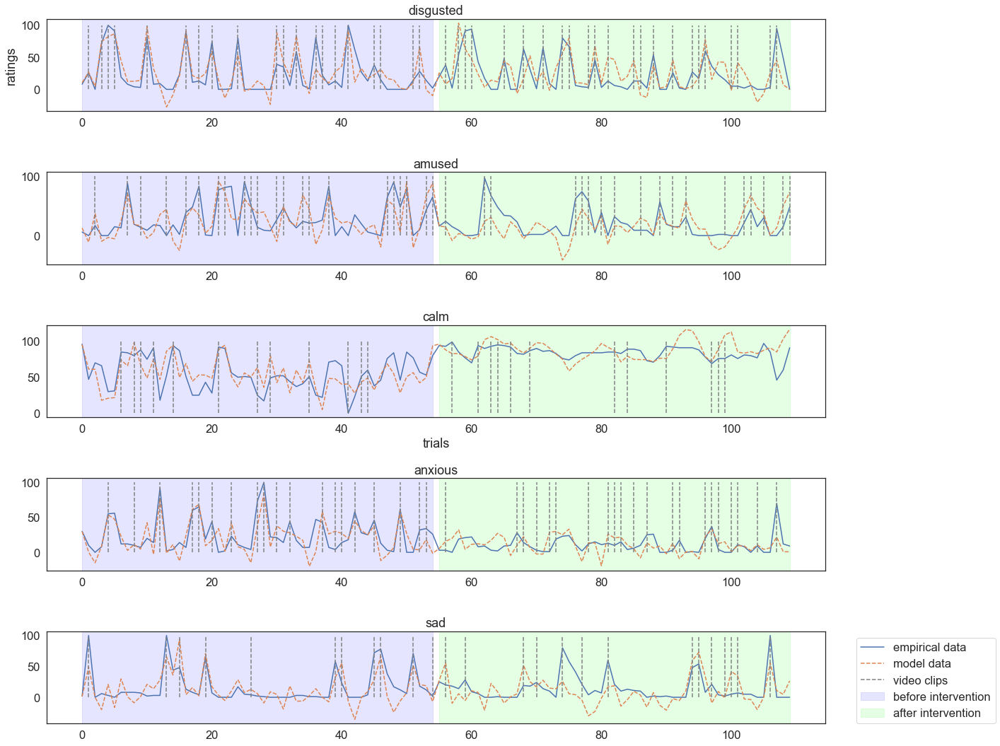

----------------------------------------------------------------------------------------------------
17 0.0


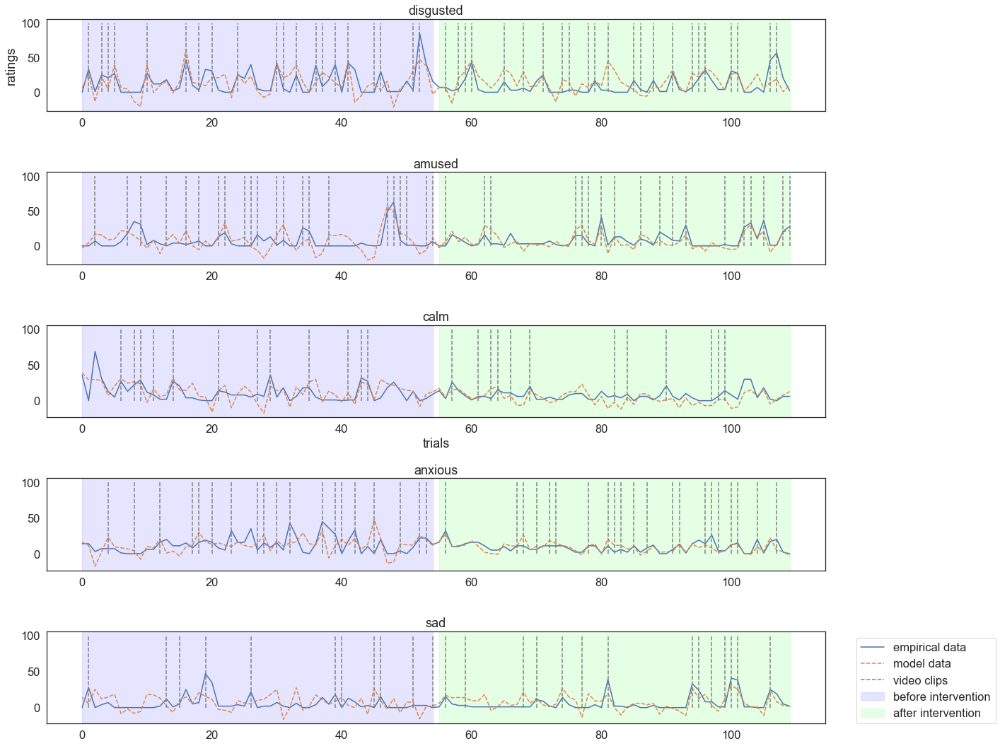

----------------------------------------------------------------------------------------------------
18 1.0


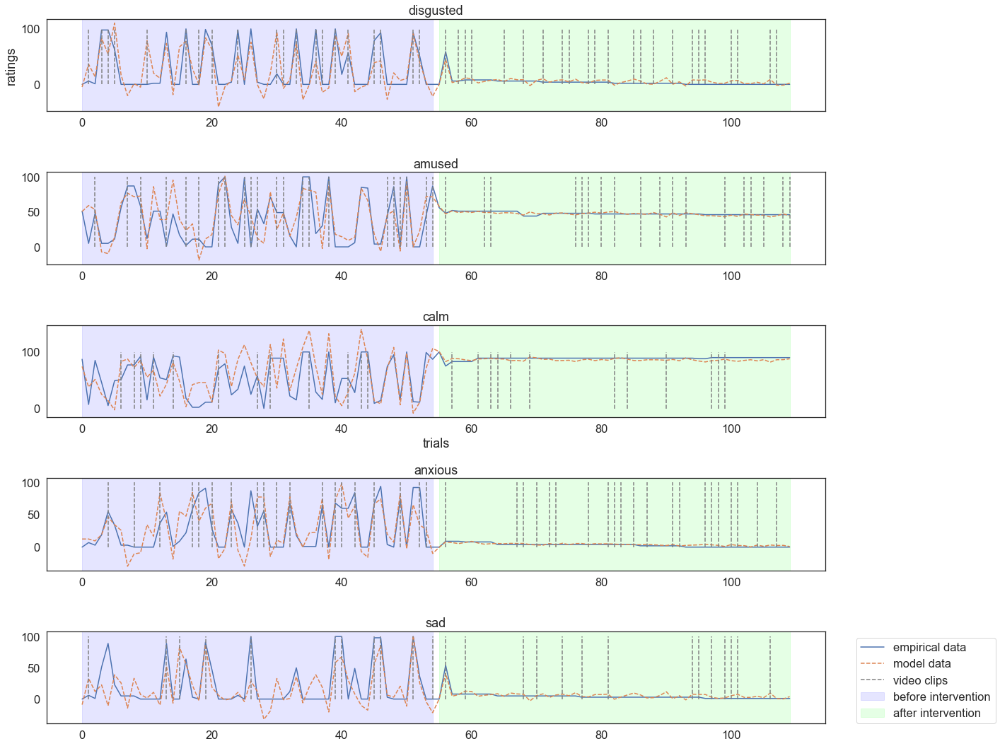

----------------------------------------------------------------------------------------------------
19 0.0


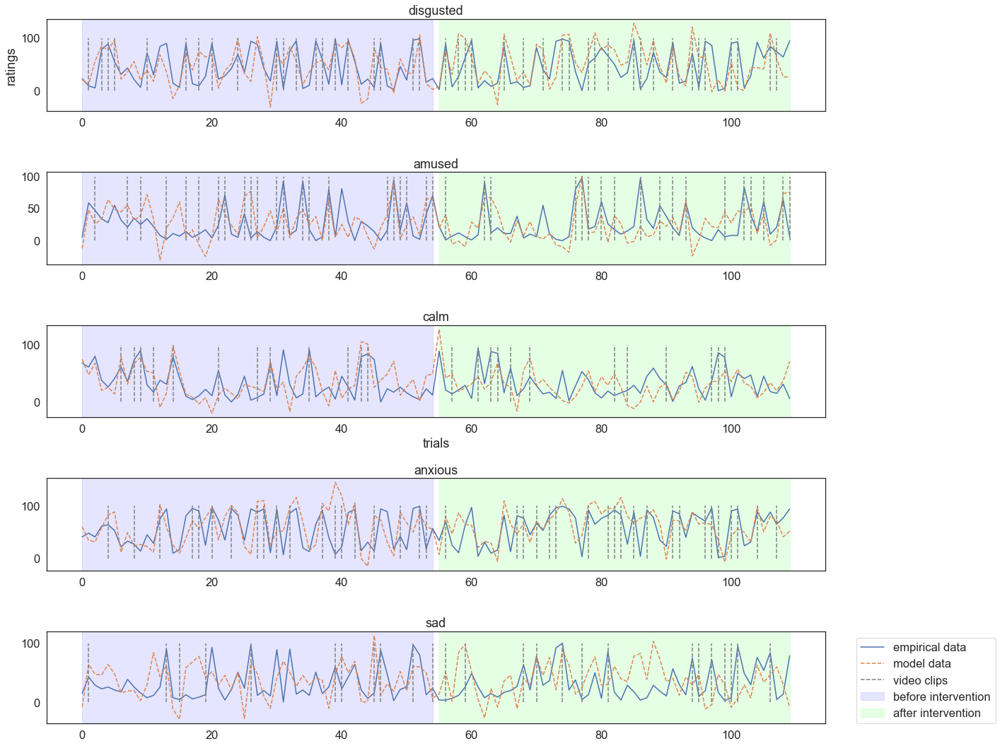

----------------------------------------------------------------------------------------------------
20 0.0


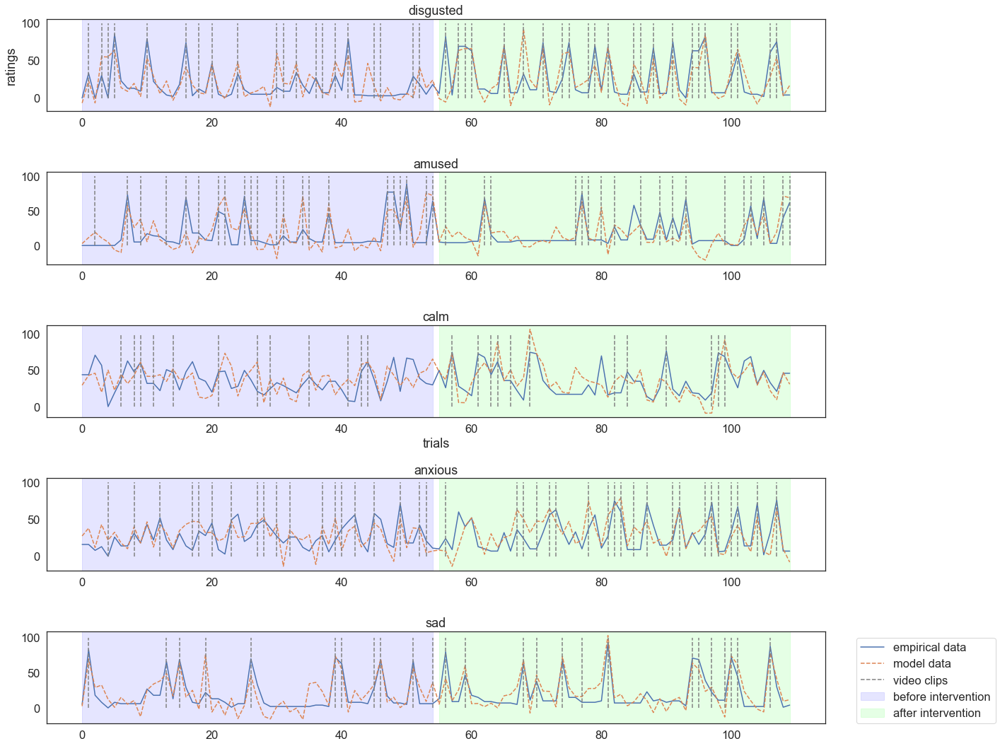

----------------------------------------------------------------------------------------------------
21 0.0


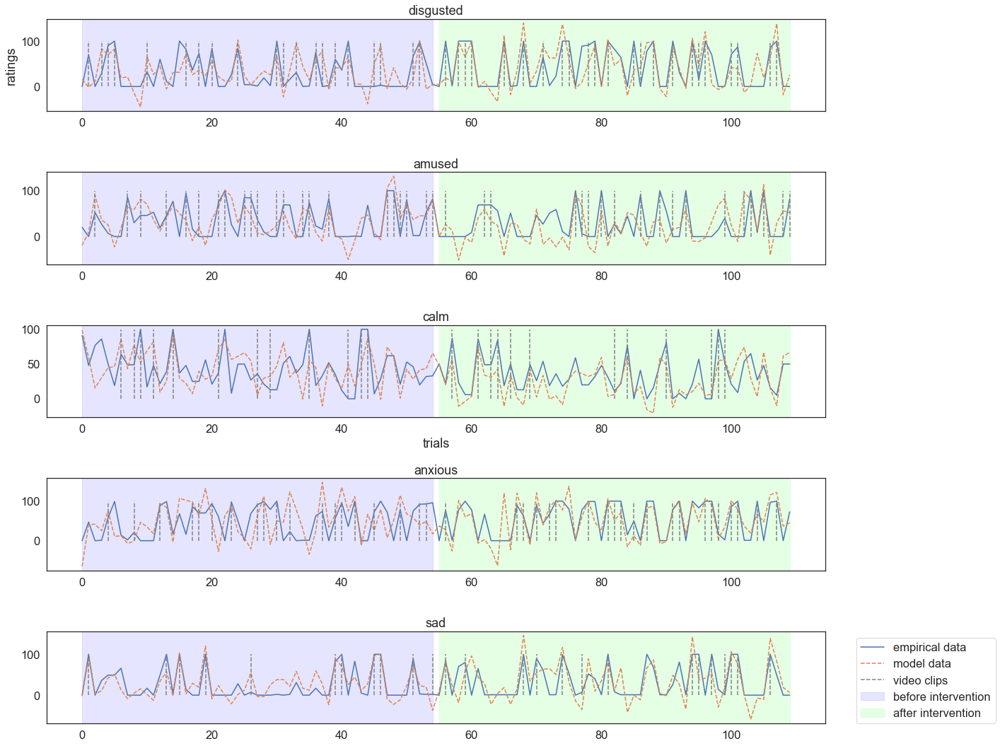

----------------------------------------------------------------------------------------------------
22 1.0


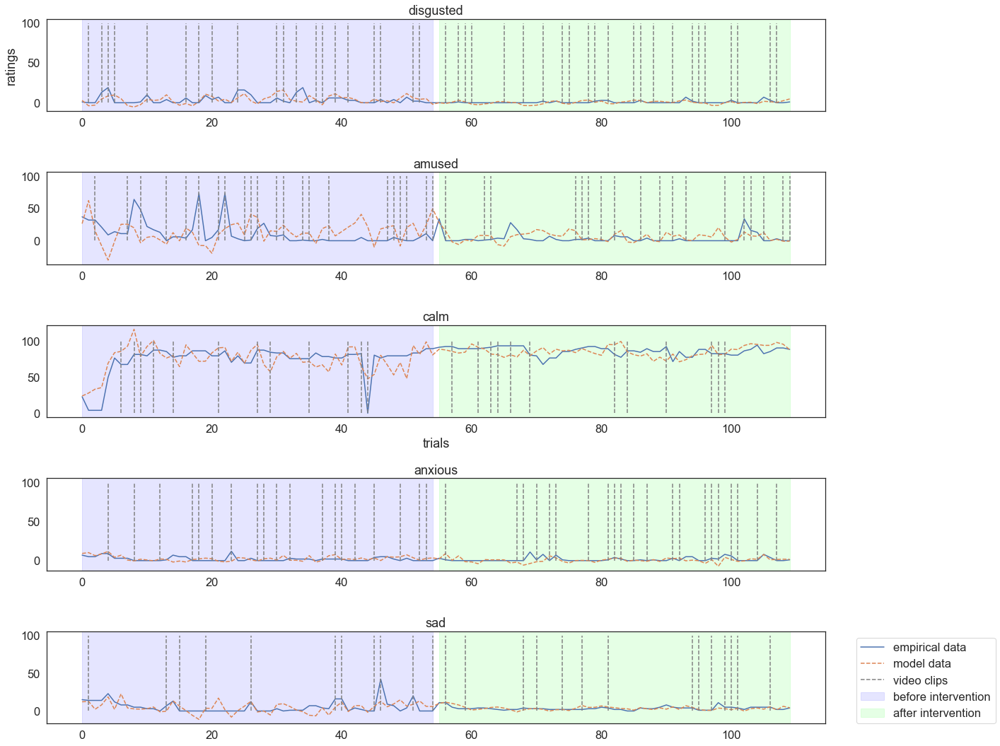

----------------------------------------------------------------------------------------------------
23 1.0


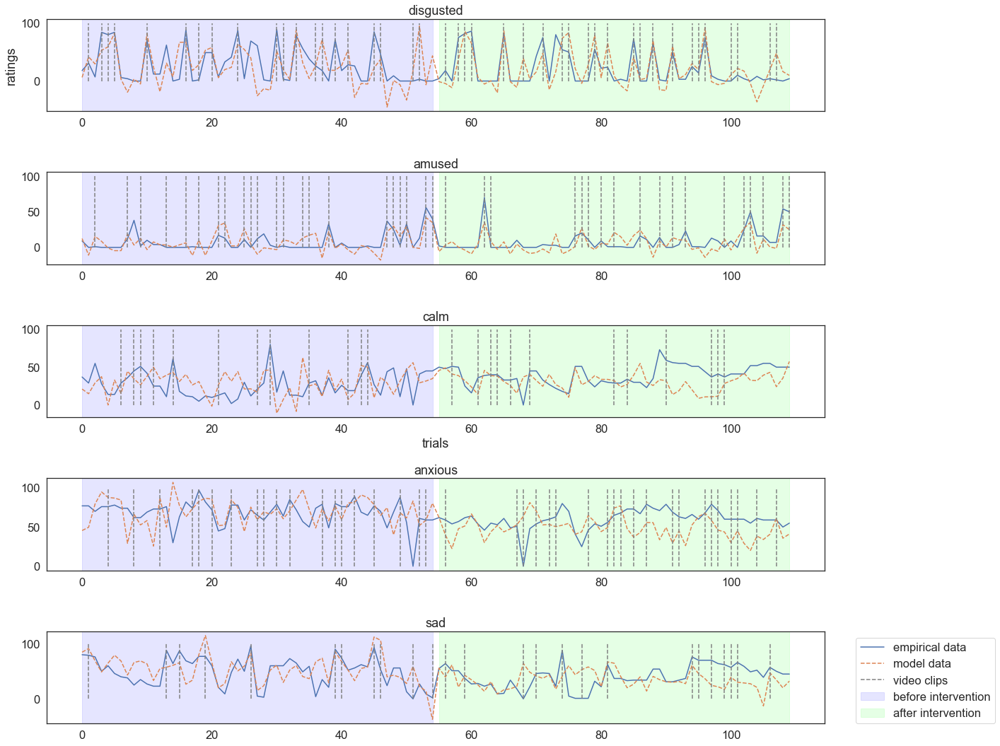

----------------------------------------------------------------------------------------------------
24 1.0


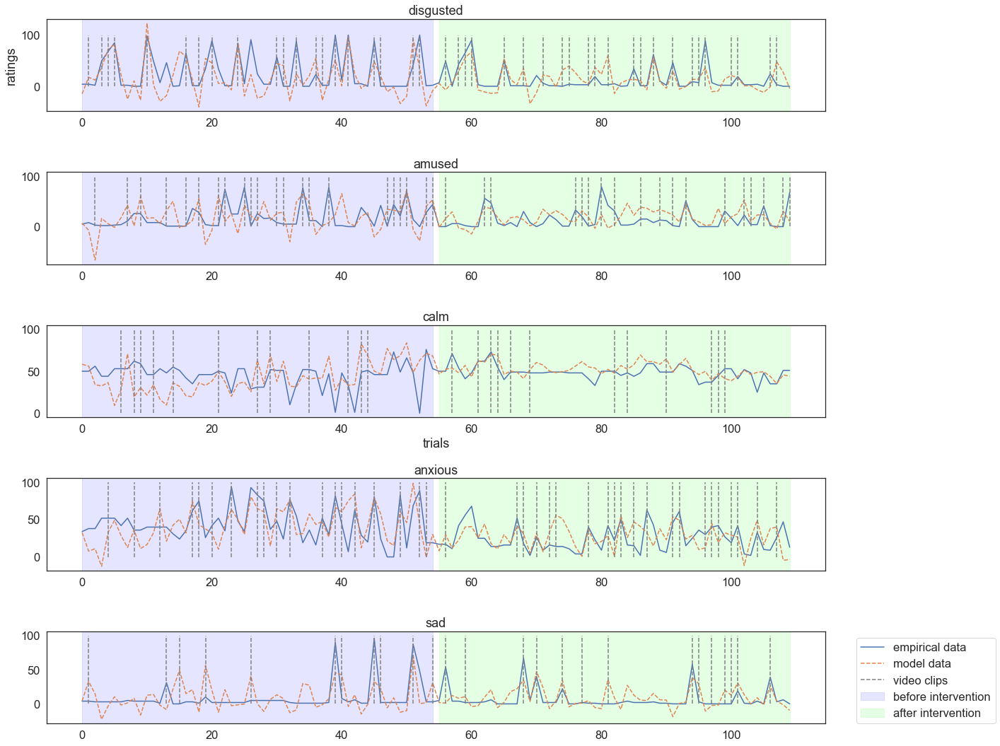

----------------------------------------------------------------------------------------------------
25 1.0


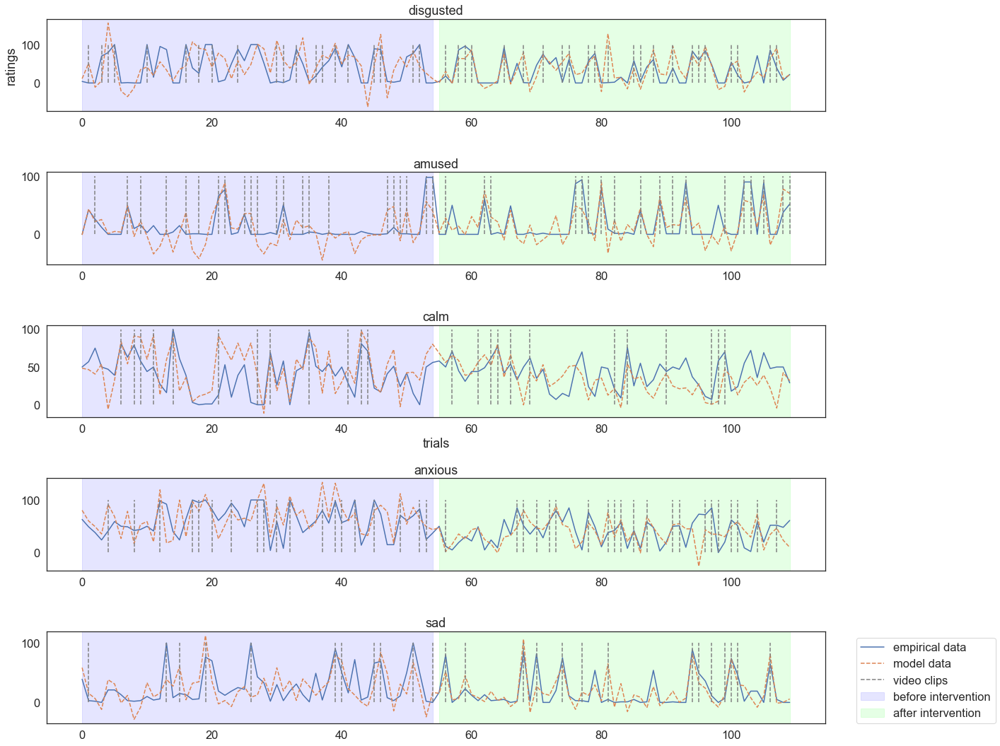

----------------------------------------------------------------------------------------------------
26 0.0


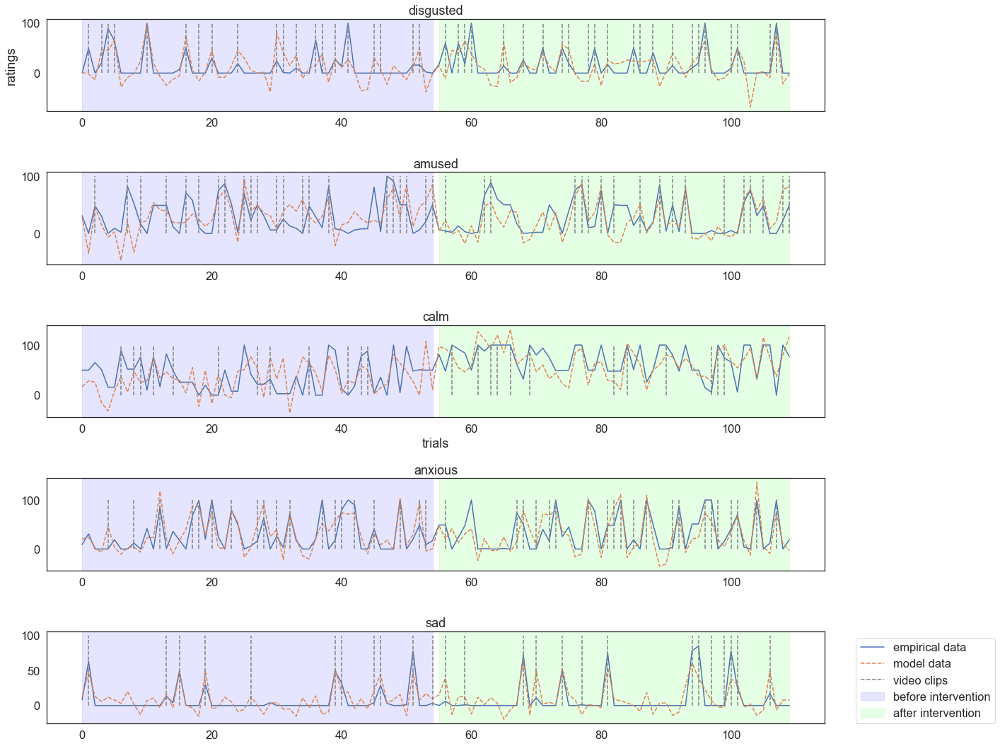

----------------------------------------------------------------------------------------------------
27 1.0


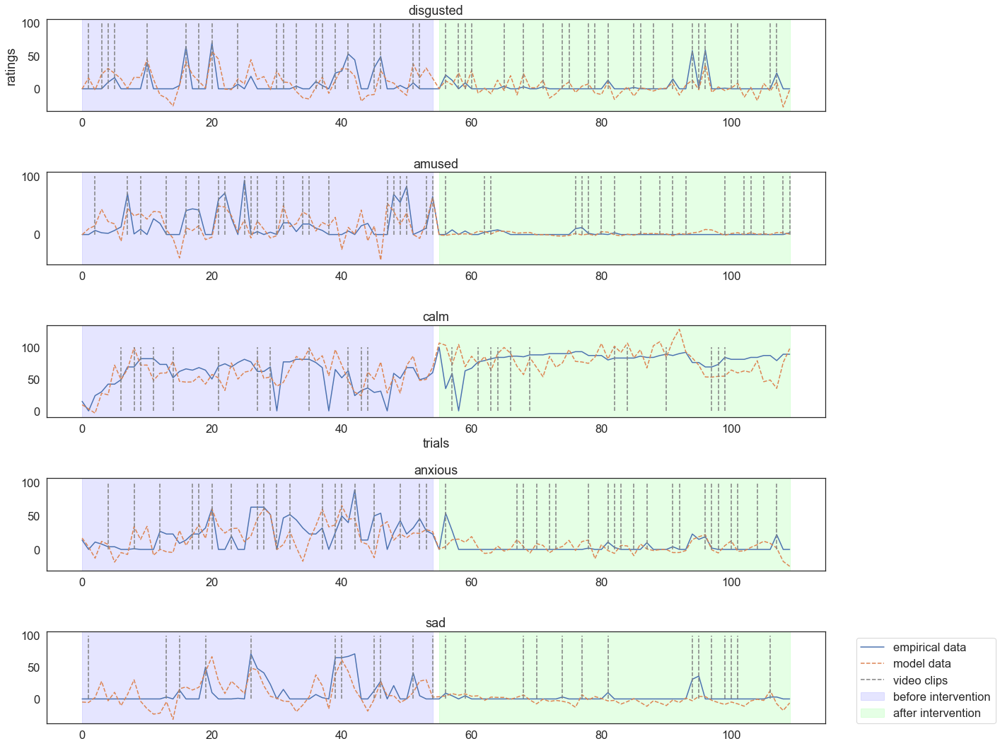

----------------------------------------------------------------------------------------------------
28 0.0


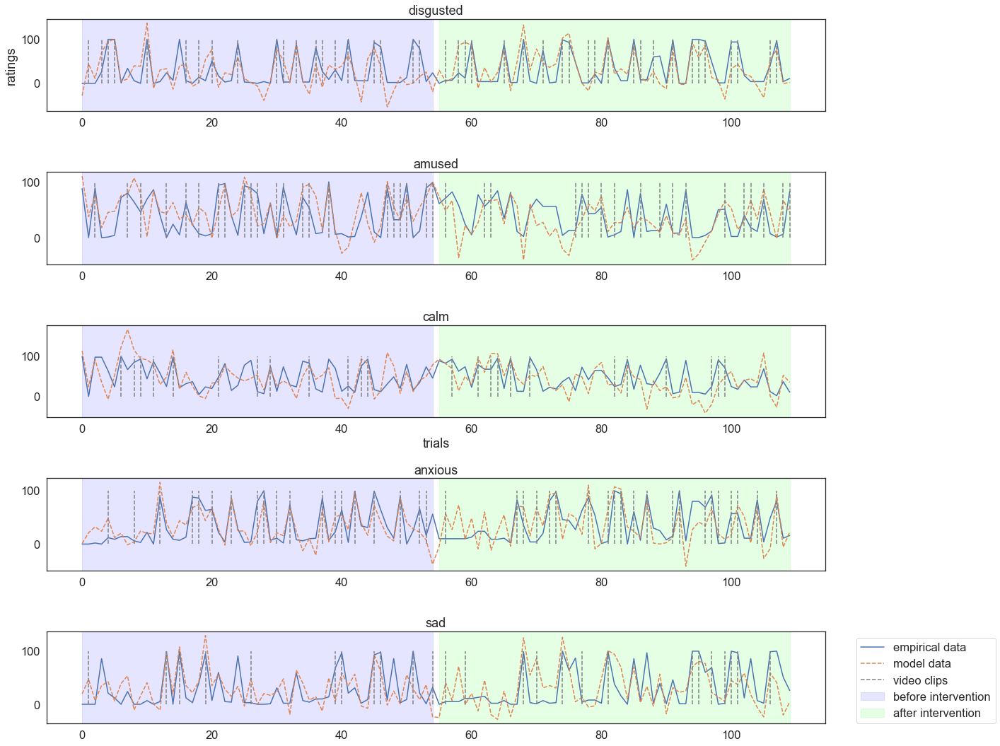

----------------------------------------------------------------------------------------------------
29 0.0


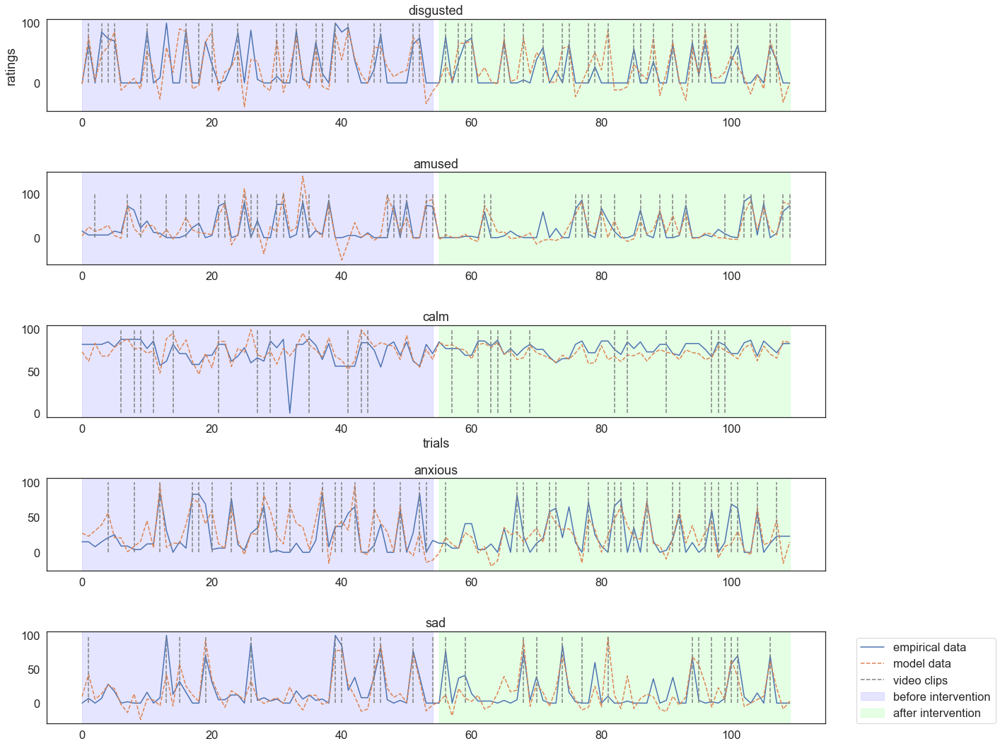

----------------------------------------------------------------------------------------------------
30 1.0


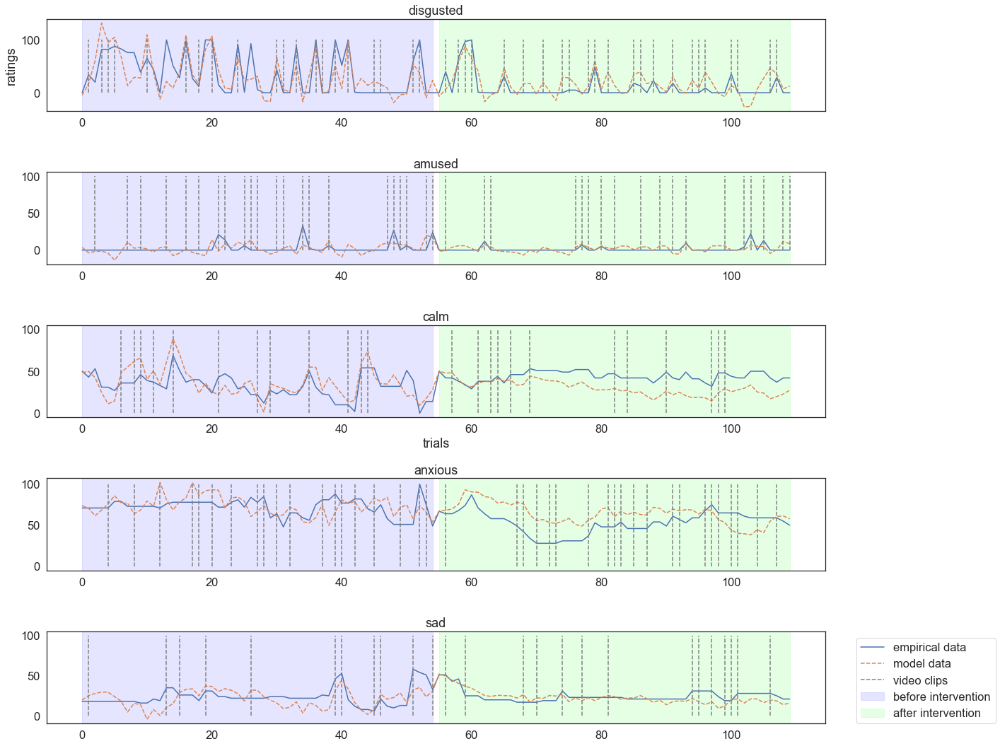

----------------------------------------------------------------------------------------------------
31 1.0


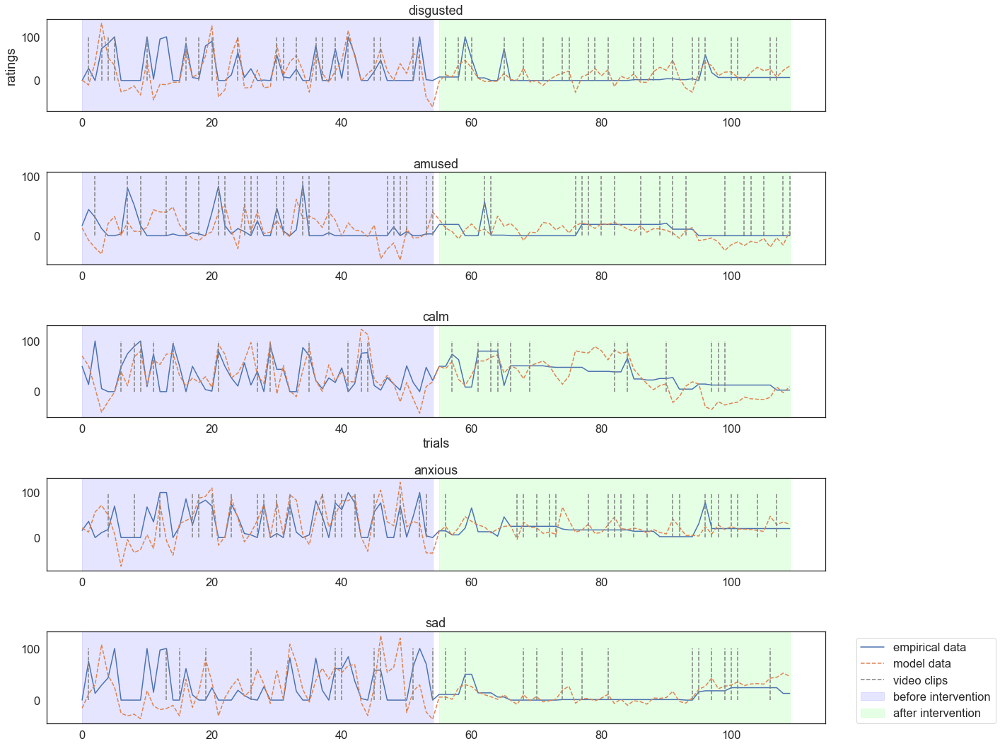

----------------------------------------------------------------------------------------------------
32 1.0


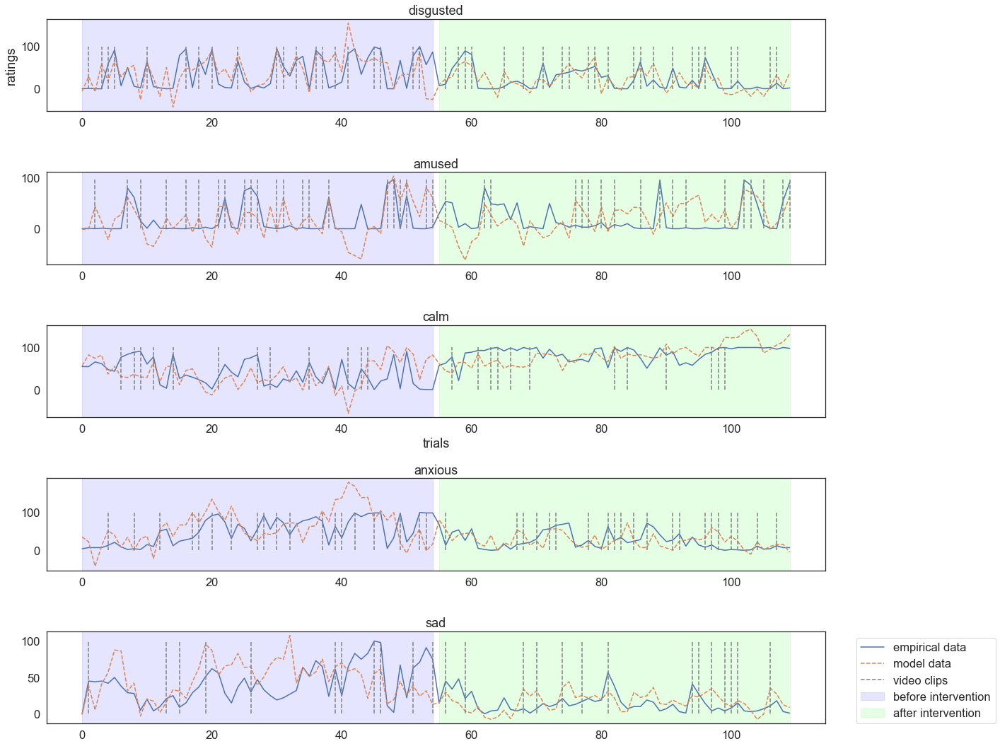

----------------------------------------------------------------------------------------------------
33 1.0


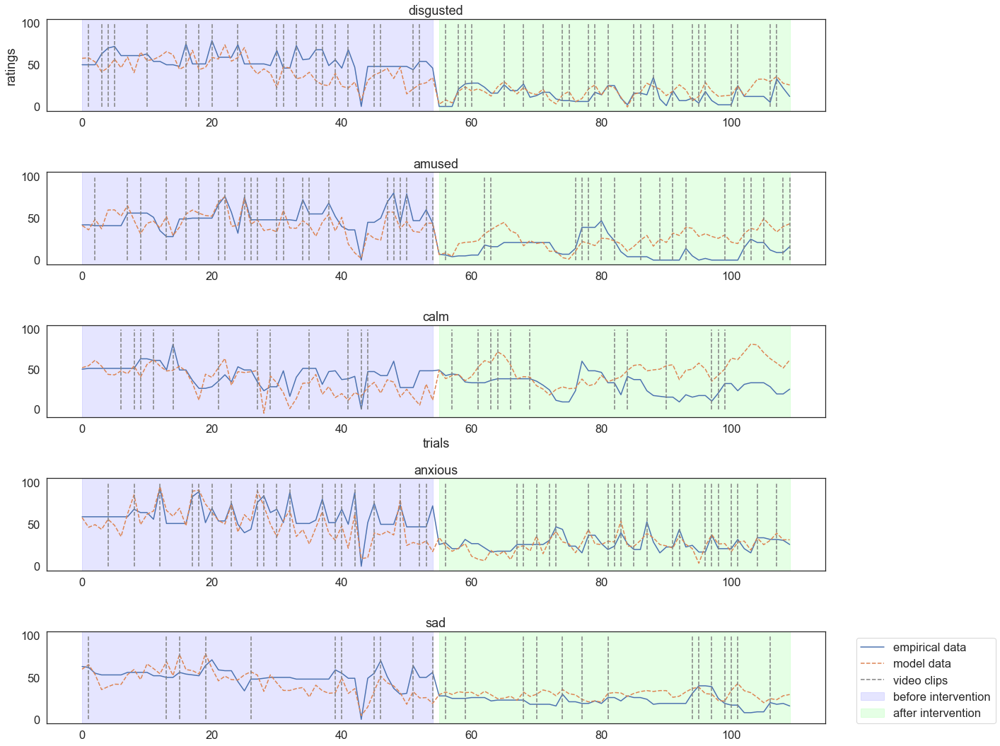

----------------------------------------------------------------------------------------------------
34 1.0


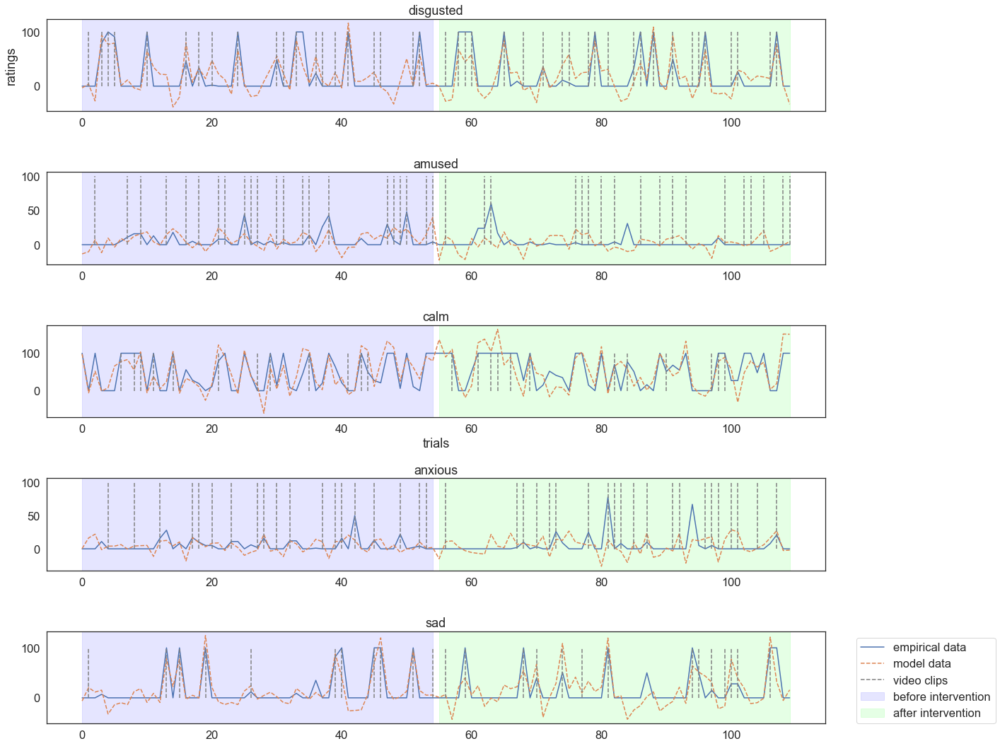

----------------------------------------------------------------------------------------------------
35 0.0


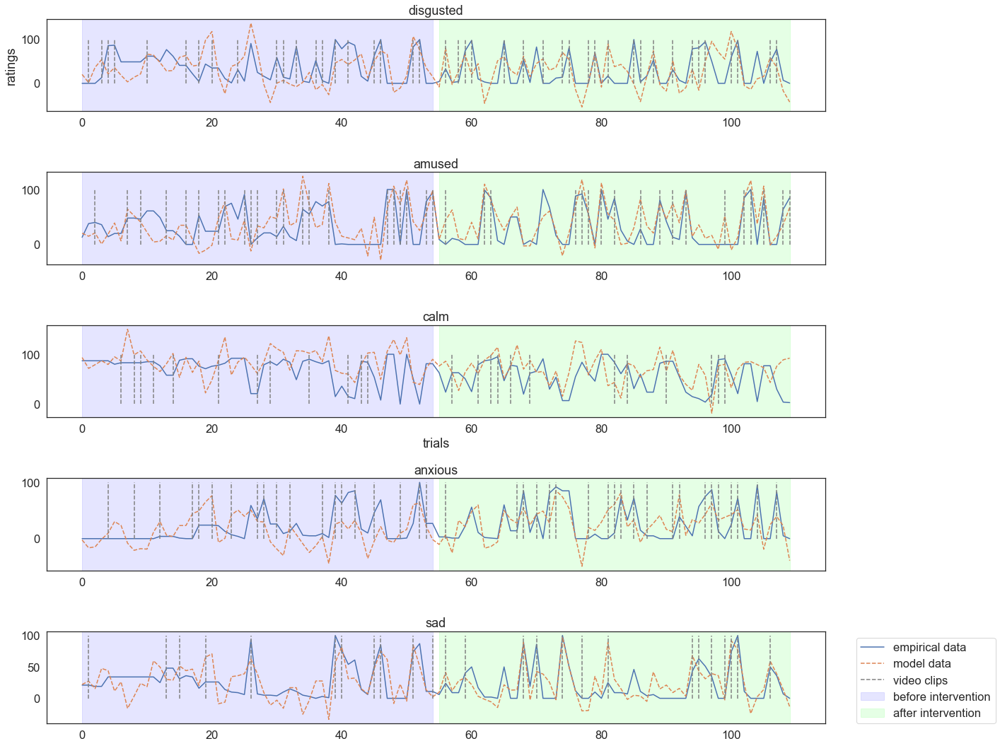

----------------------------------------------------------------------------------------------------
36 1.0


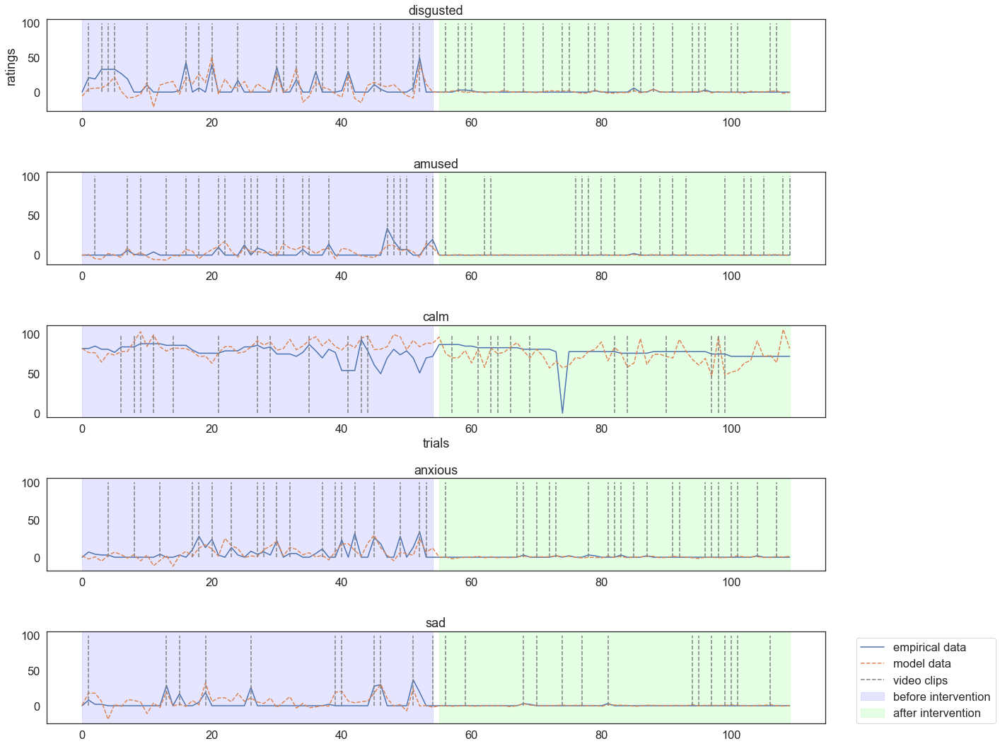

----------------------------------------------------------------------------------------------------
37 0.0


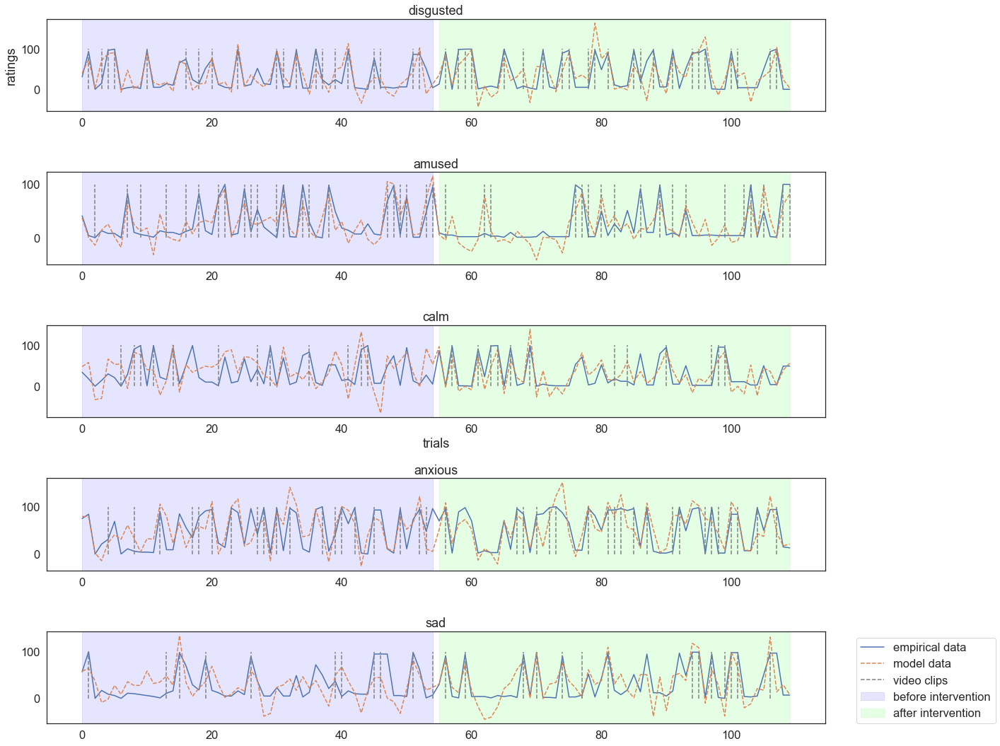

----------------------------------------------------------------------------------------------------
38 1.0


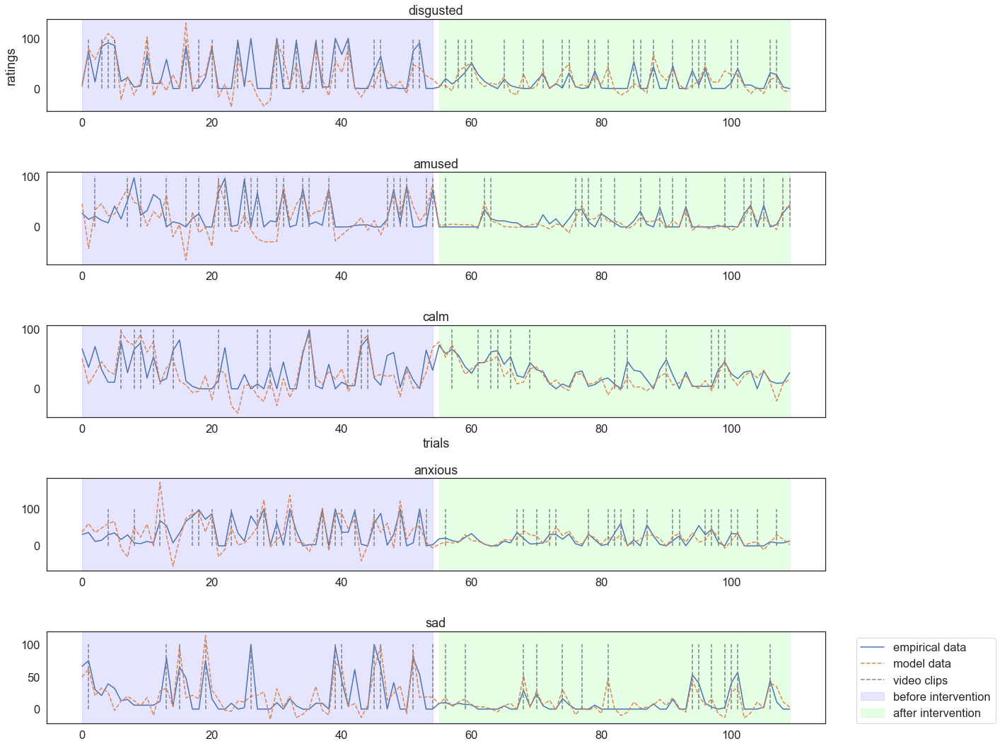

----------------------------------------------------------------------------------------------------
39 1.0


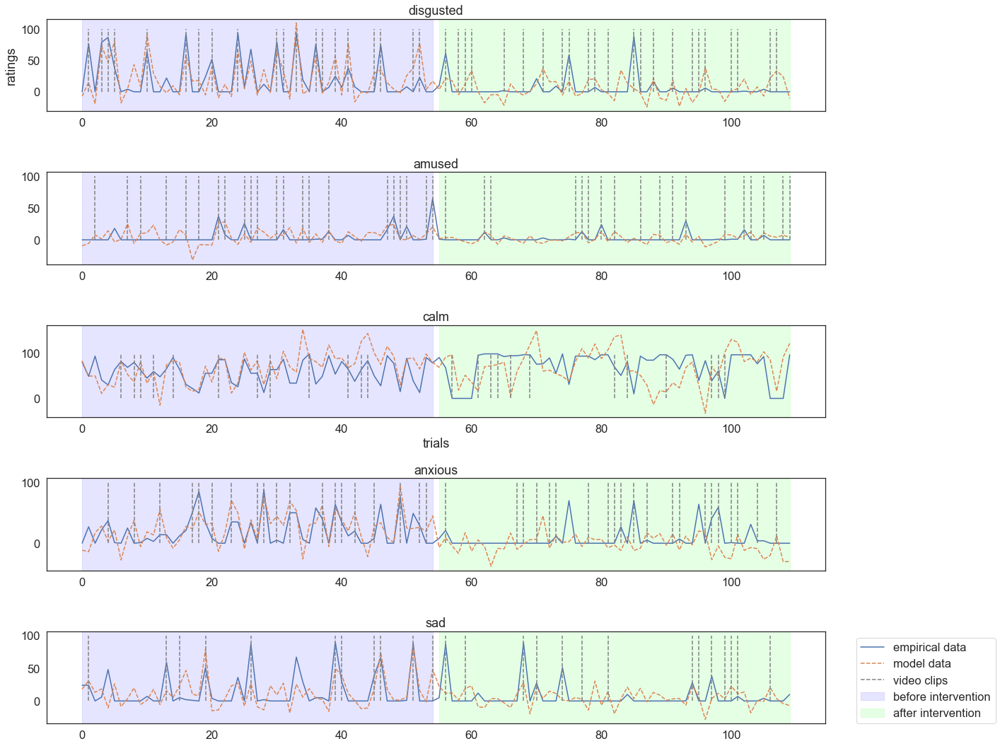

----------------------------------------------------------------------------------------------------
40 1.0


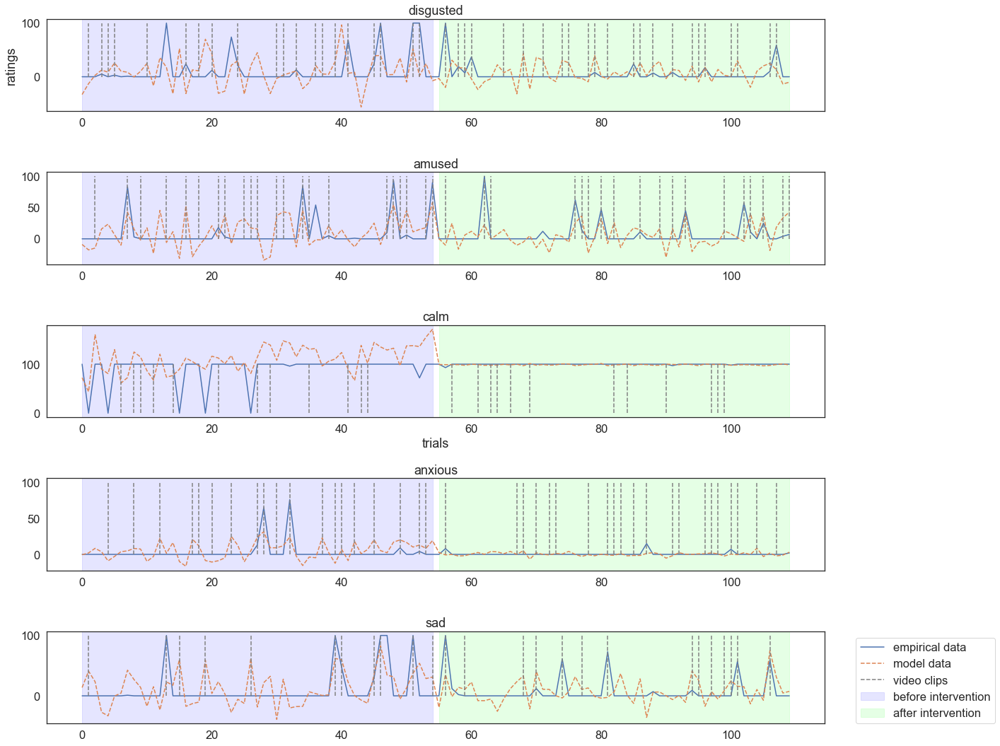

----------------------------------------------------------------------------------------------------
41 1.0


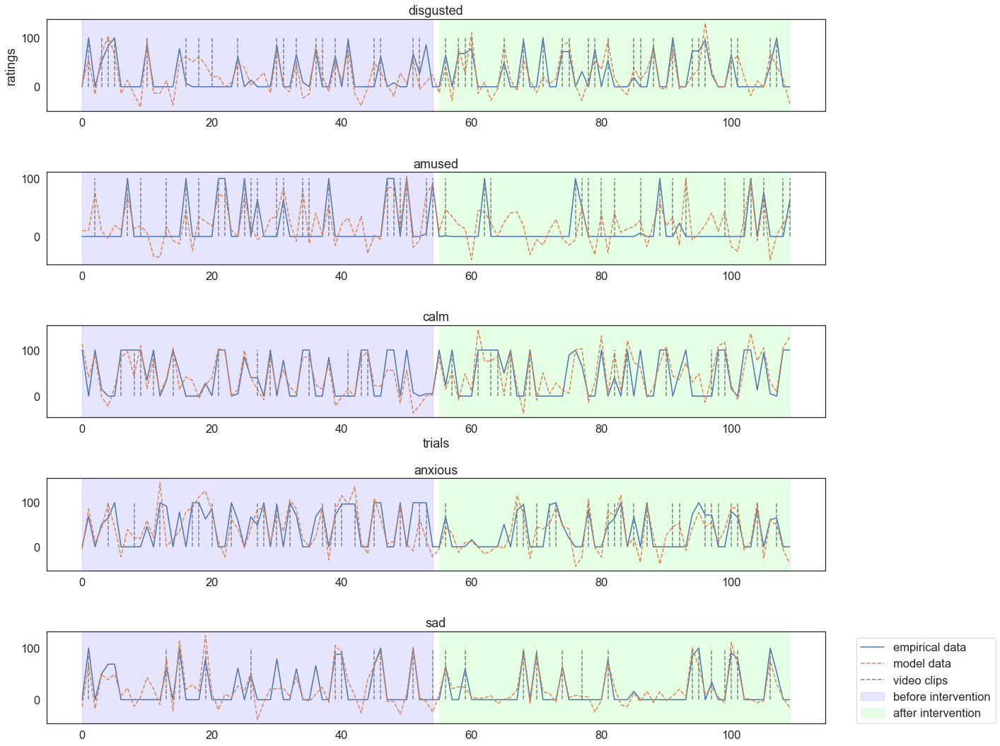

----------------------------------------------------------------------------------------------------
42 0.0


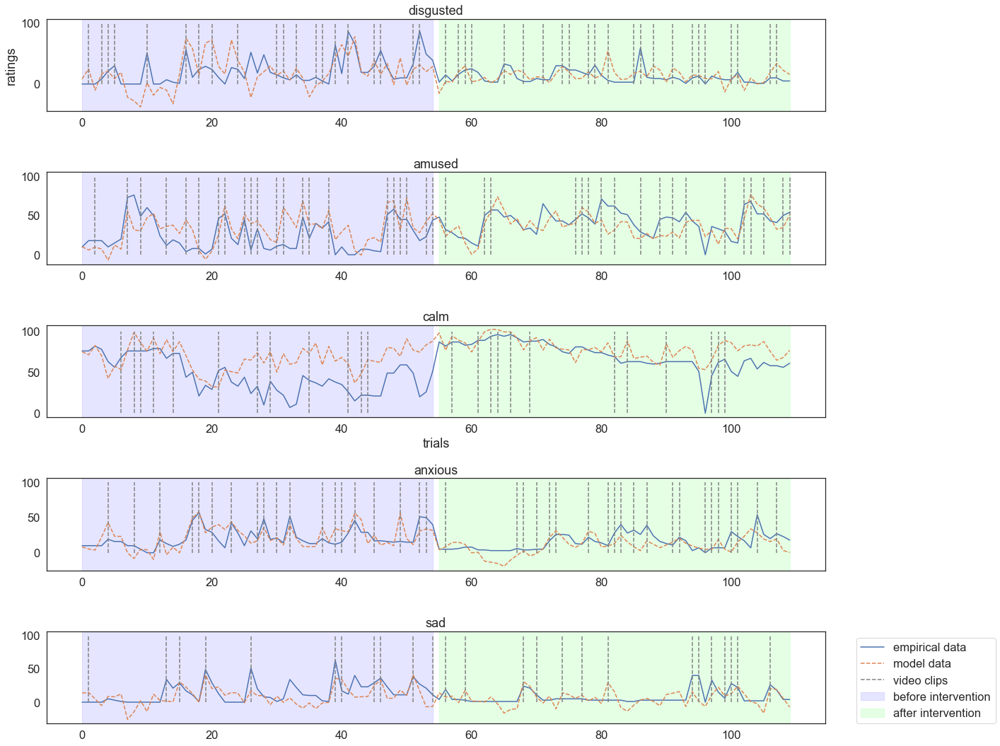

----------------------------------------------------------------------------------------------------
43 1.0


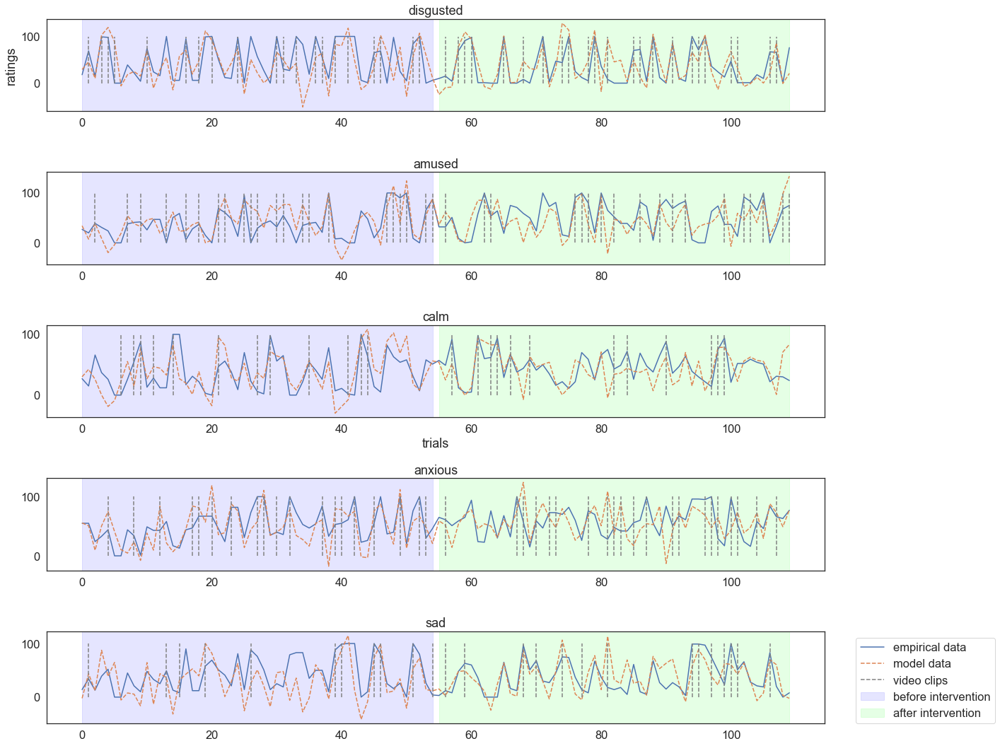

----------------------------------------------------------------------------------------------------
44 1.0


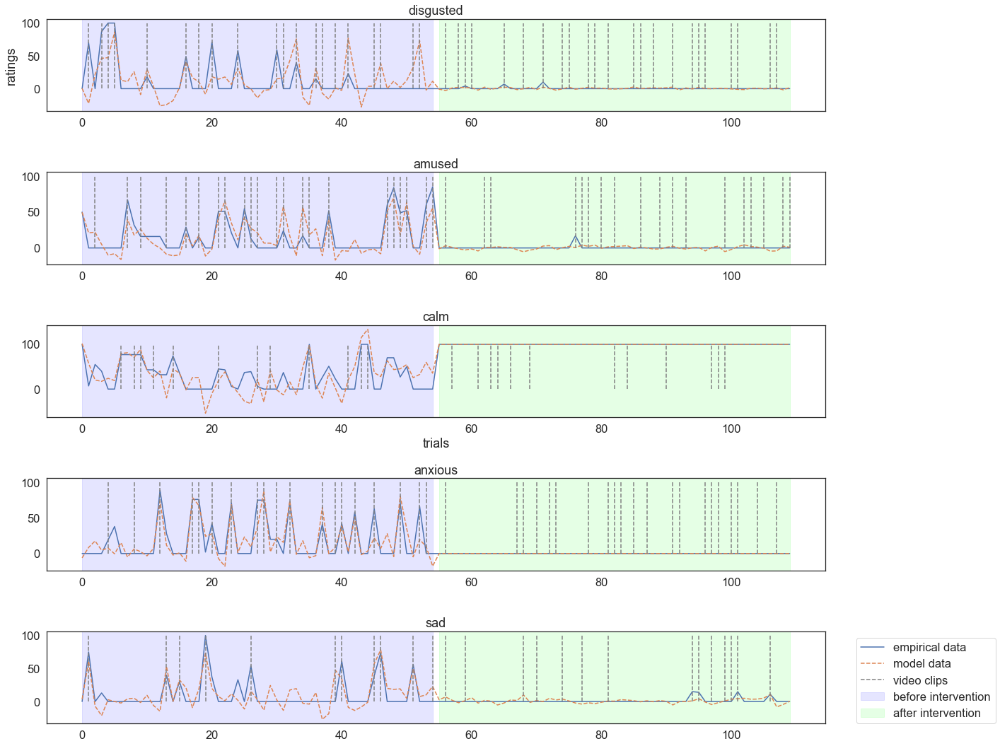

----------------------------------------------------------------------------------------------------
45 1.0


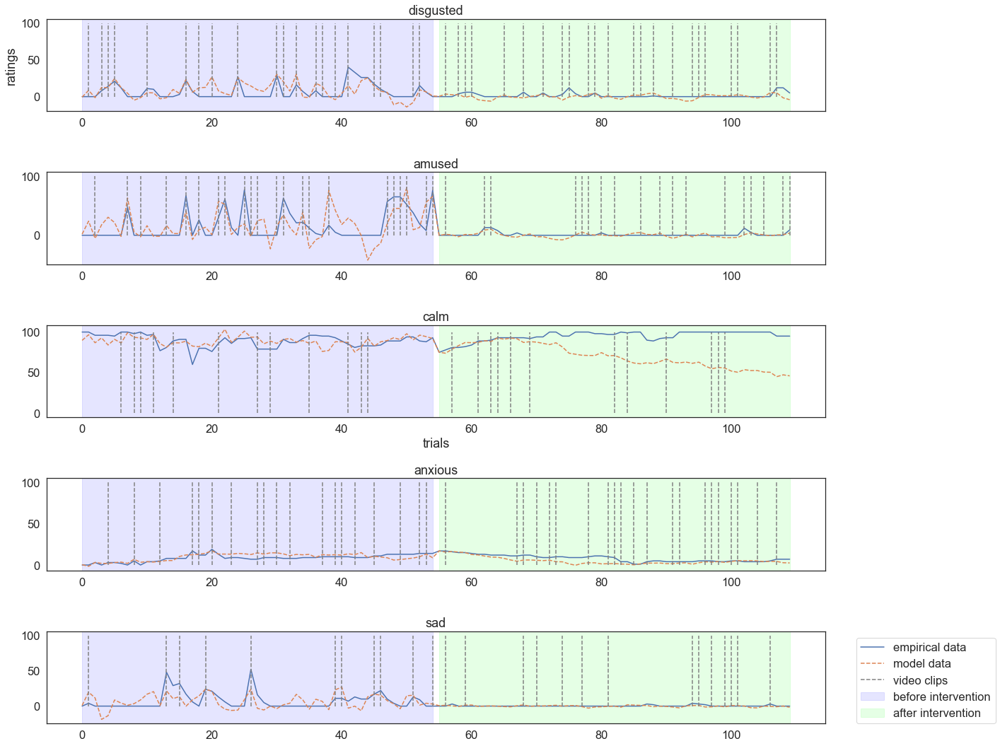

----------------------------------------------------------------------------------------------------
46 1.0


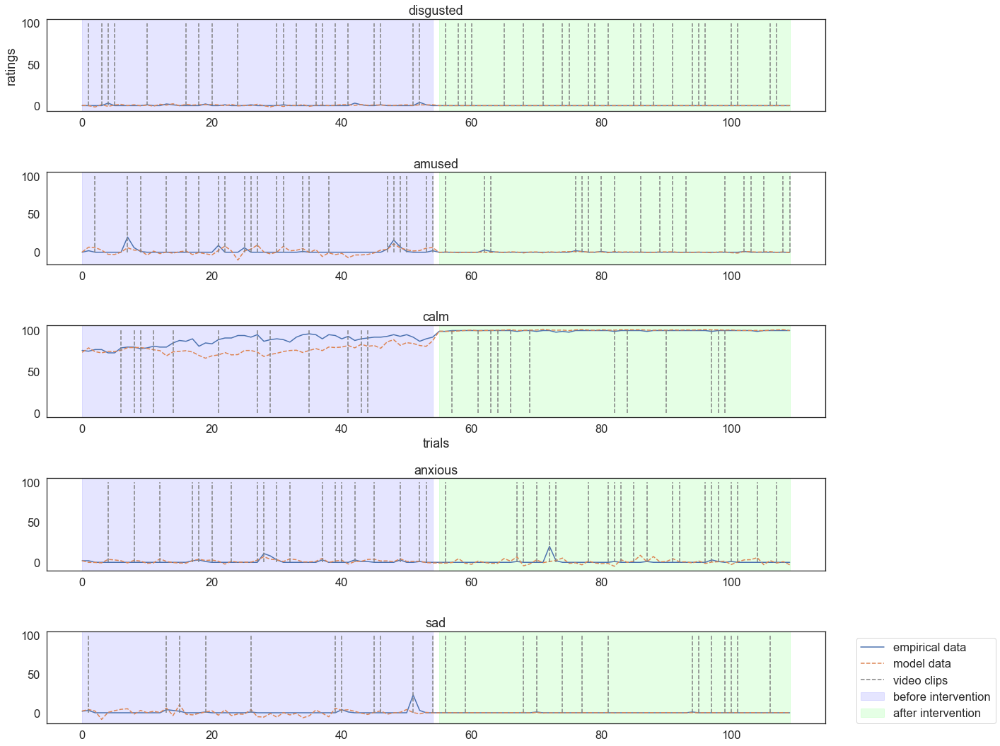

----------------------------------------------------------------------------------------------------
47 1.0


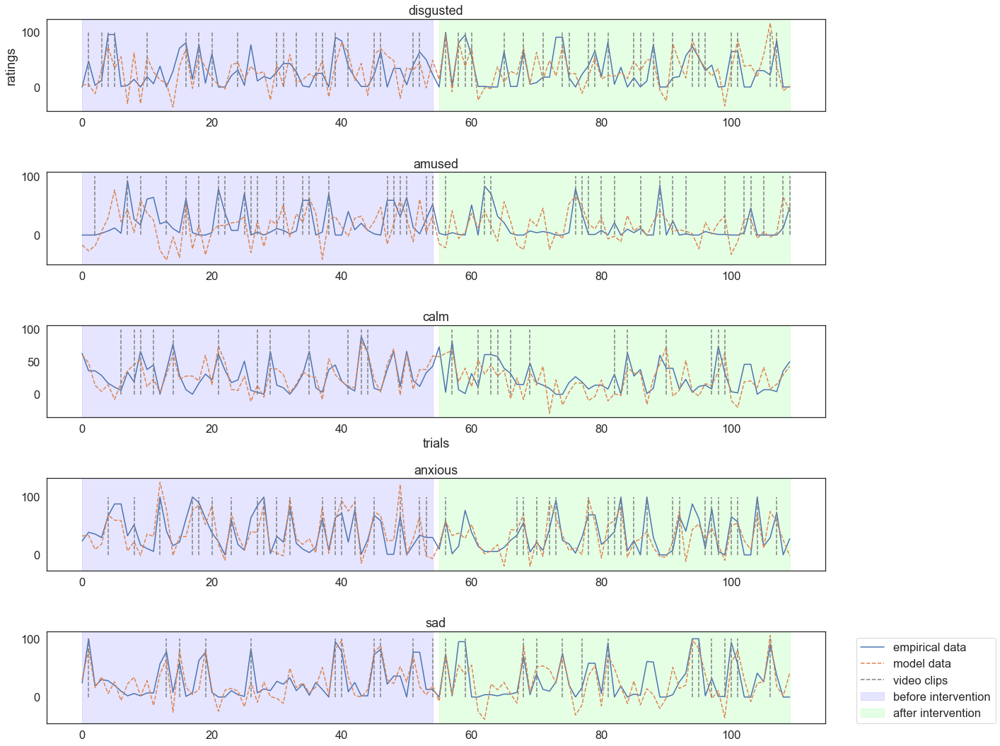

----------------------------------------------------------------------------------------------------
48 0.0


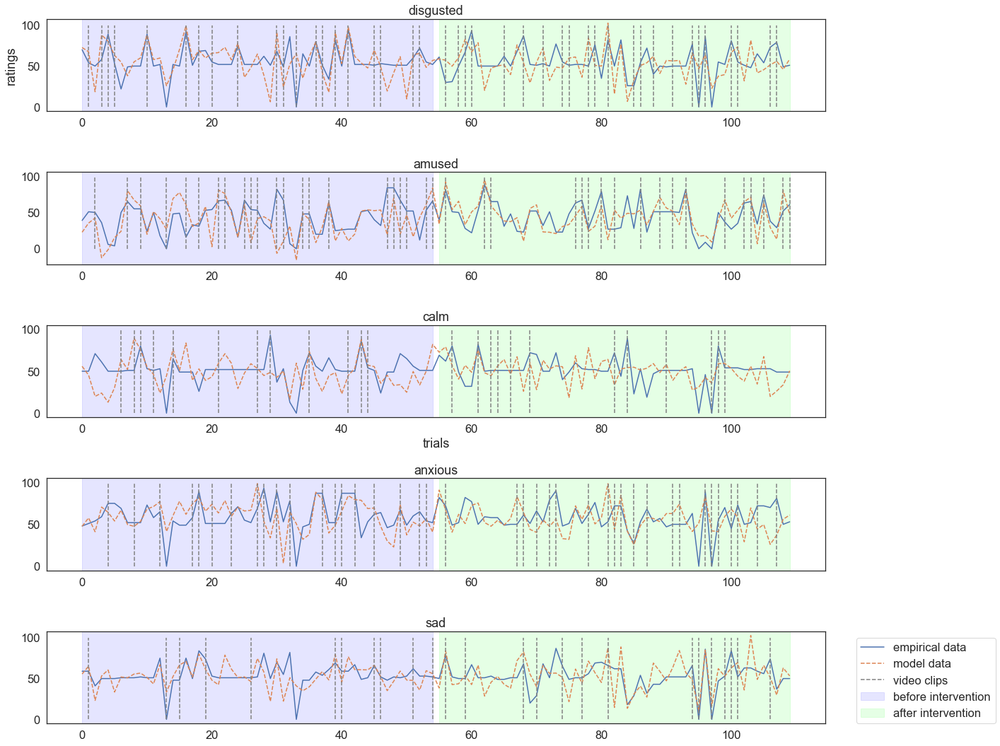

----------------------------------------------------------------------------------------------------
49 0.0


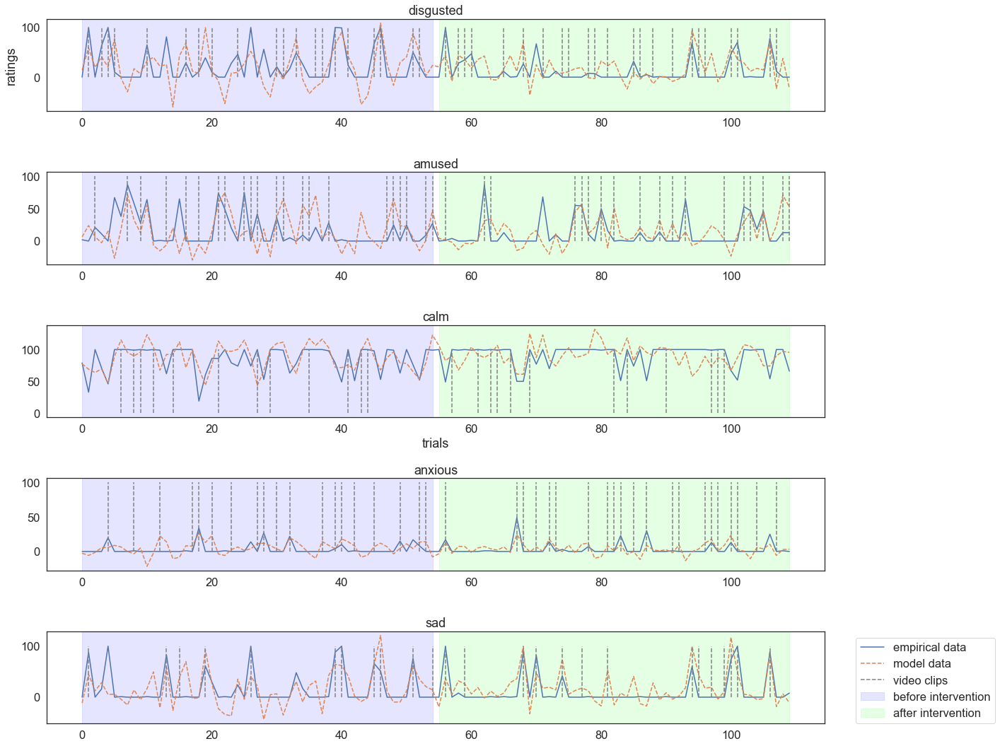

----------------------------------------------------------------------------------------------------
50 0.0


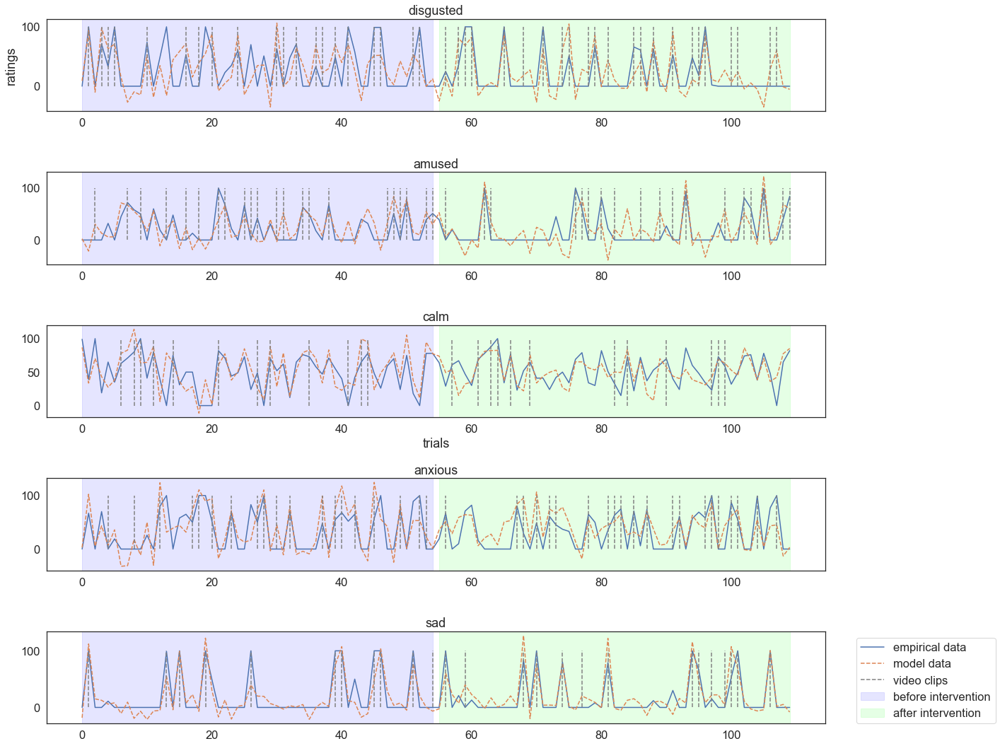

----------------------------------------------------------------------------------------------------
51 1.0


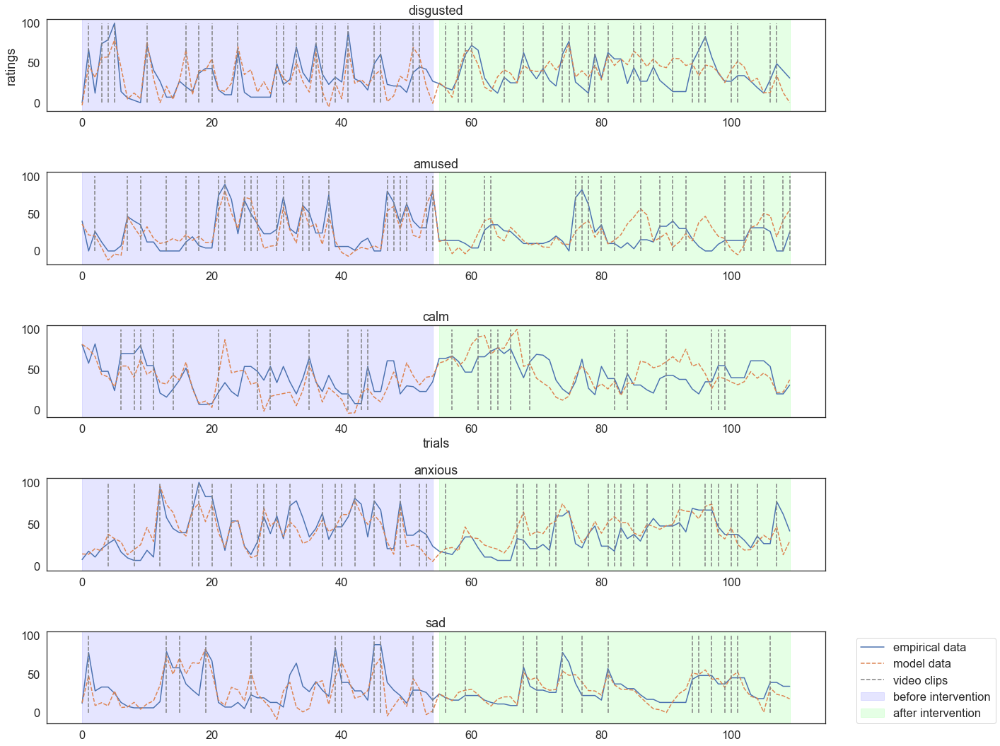

----------------------------------------------------------------------------------------------------
52 1.0


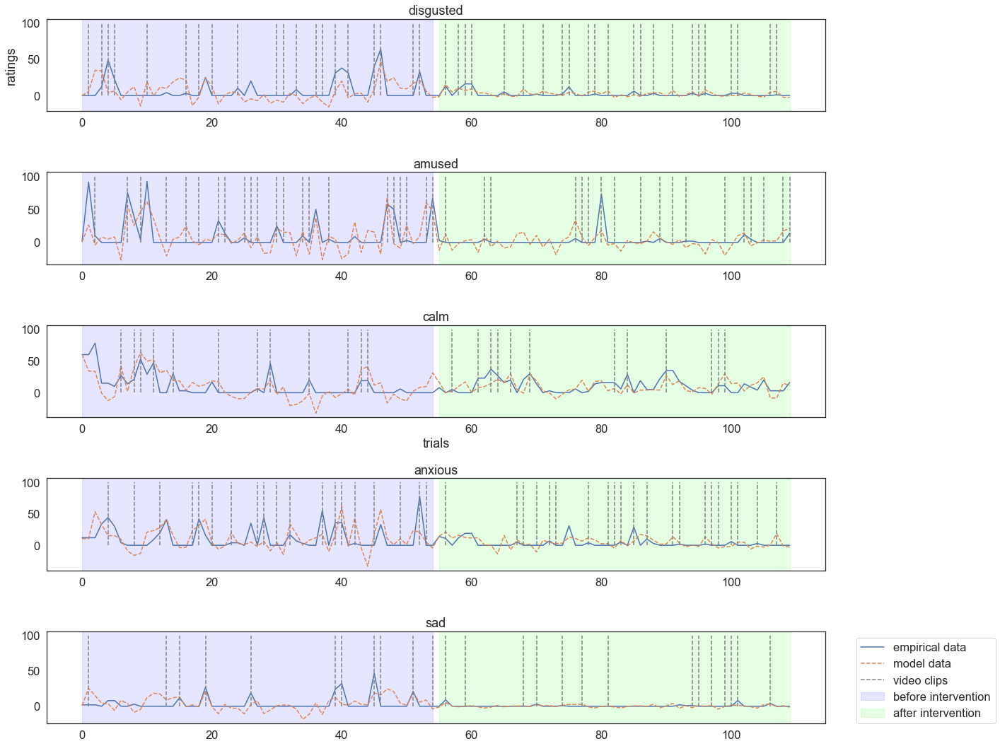

----------------------------------------------------------------------------------------------------
53 1.0


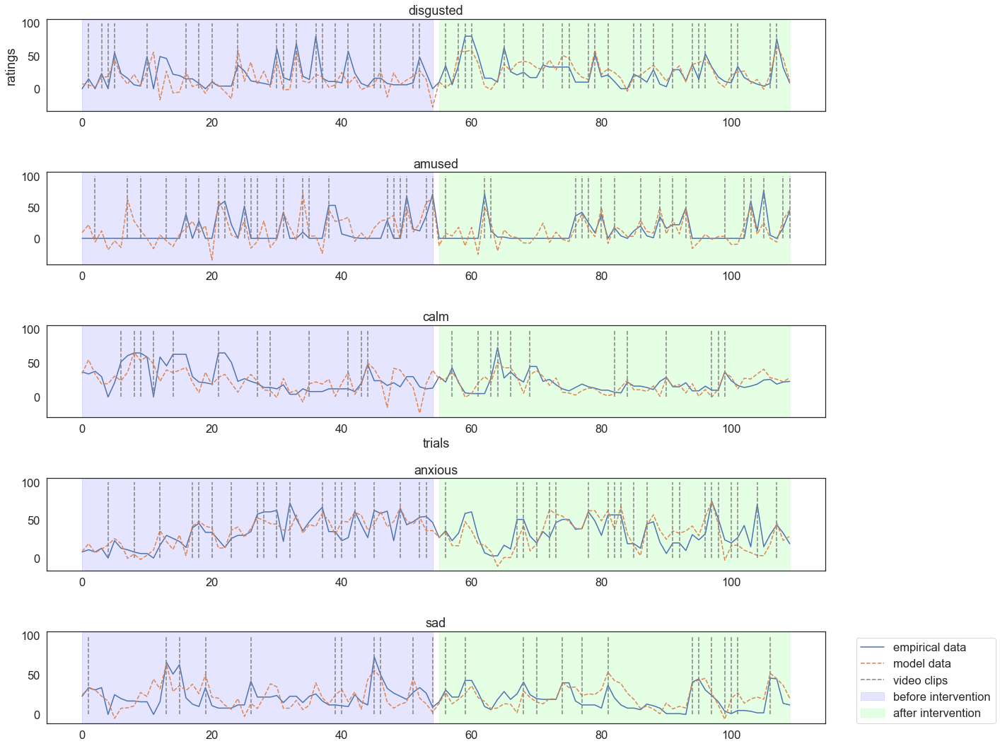

----------------------------------------------------------------------------------------------------
54 0.0


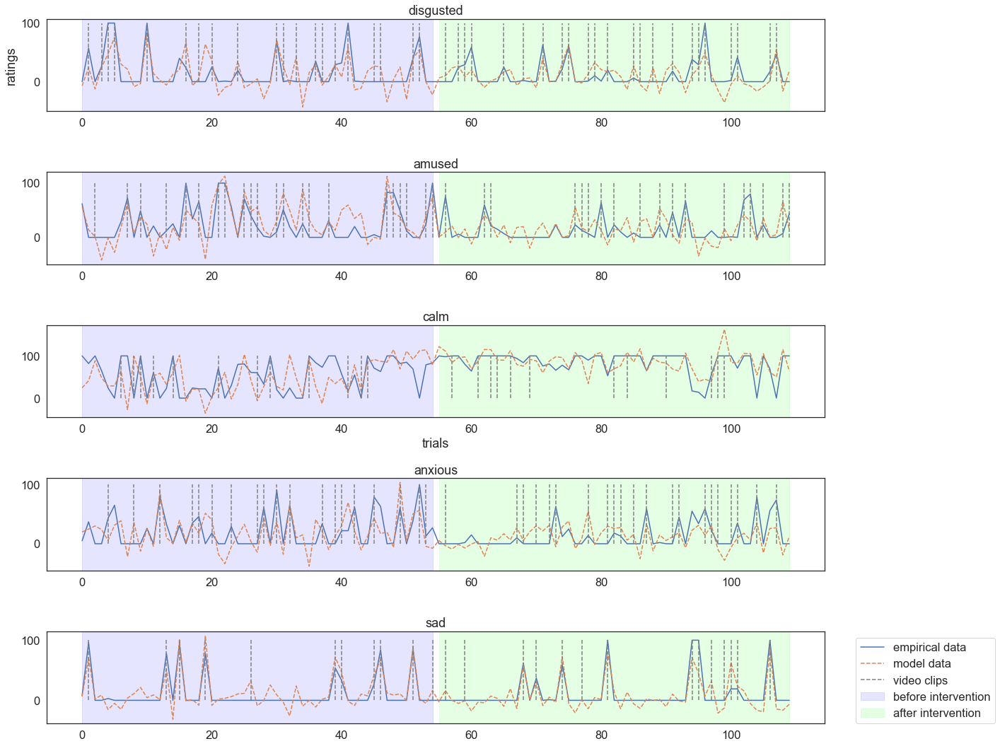

----------------------------------------------------------------------------------------------------
55 0.0


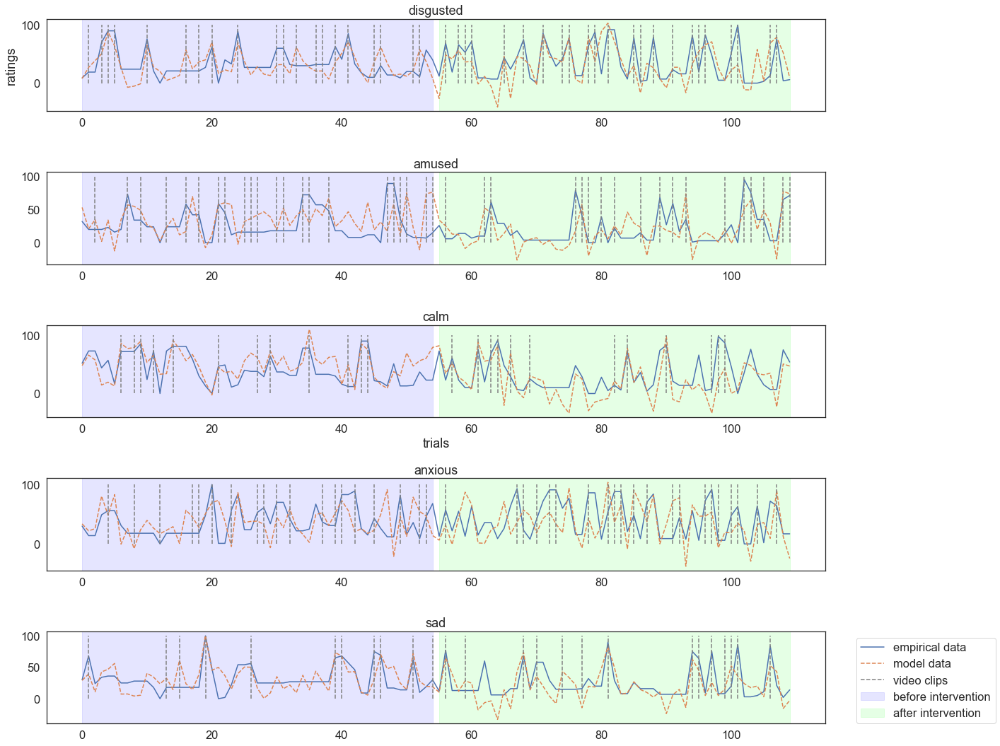

----------------------------------------------------------------------------------------------------
56 0.0


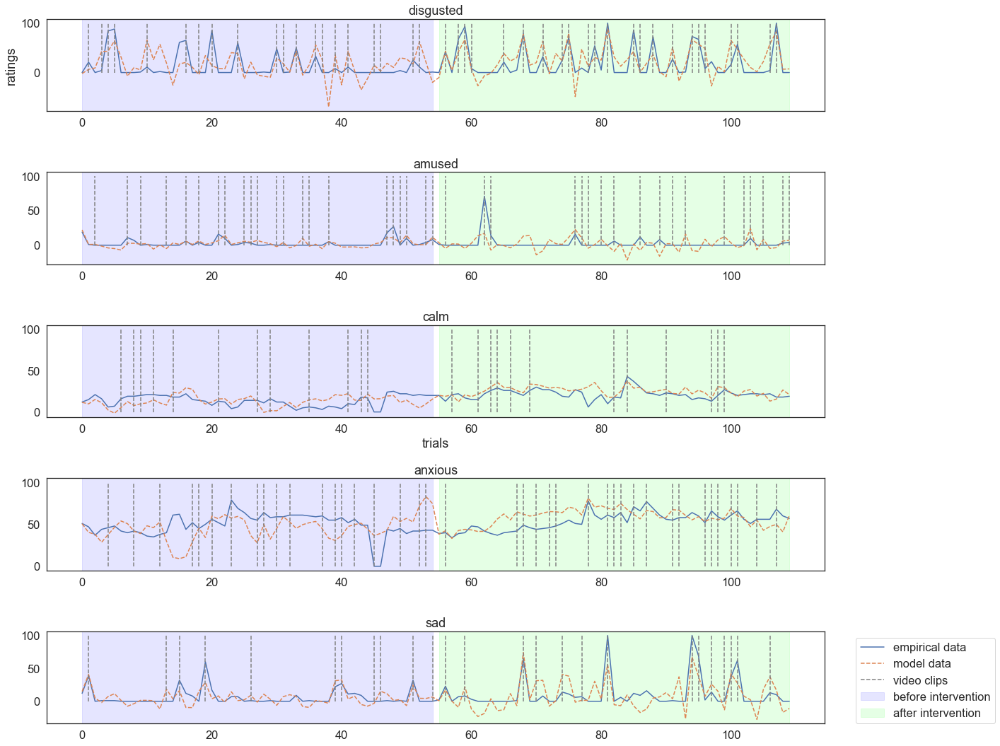

----------------------------------------------------------------------------------------------------
57 0.0


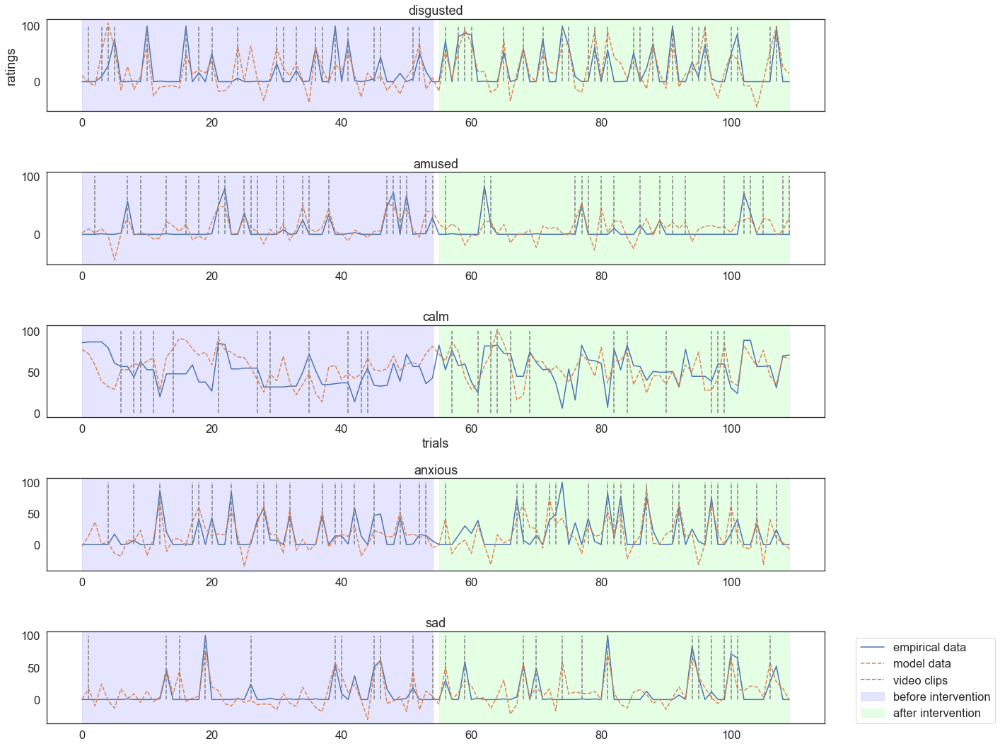

----------------------------------------------------------------------------------------------------
58 0.0


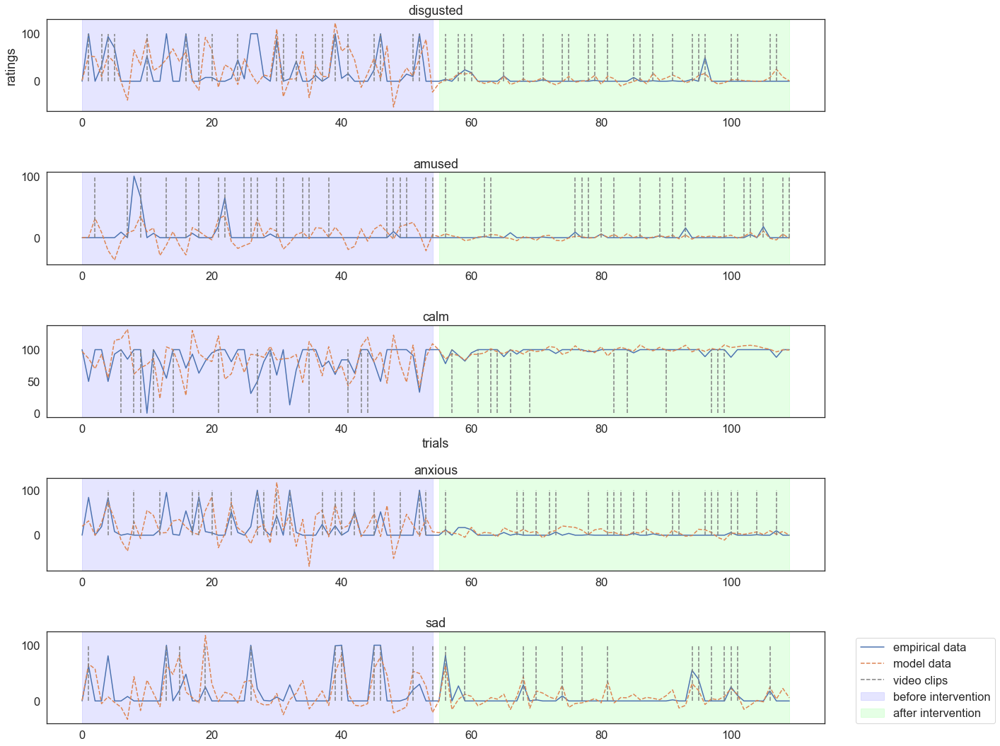

----------------------------------------------------------------------------------------------------
59 1.0


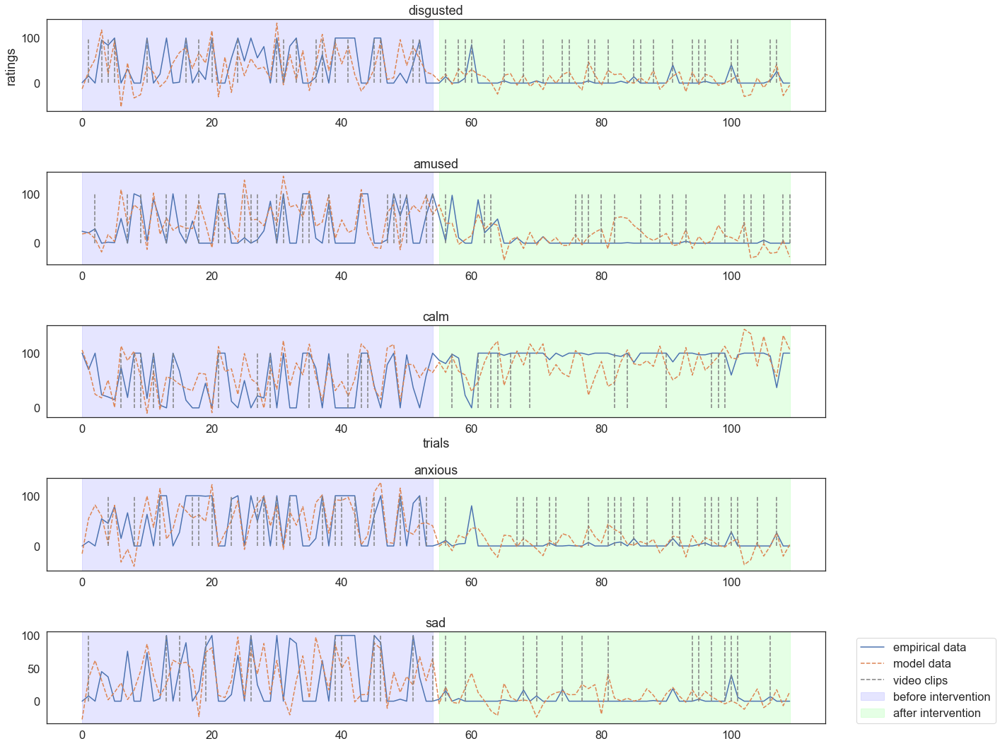

----------------------------------------------------------------------------------------------------
60 0.0


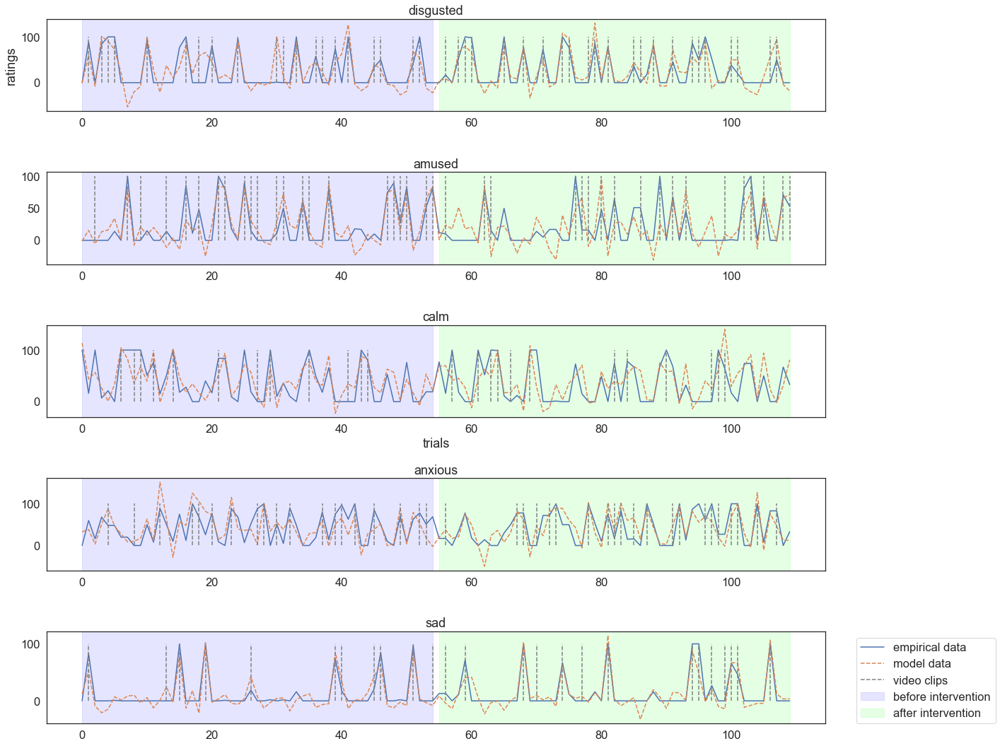

----------------------------------------------------------------------------------------------------
61 1.0


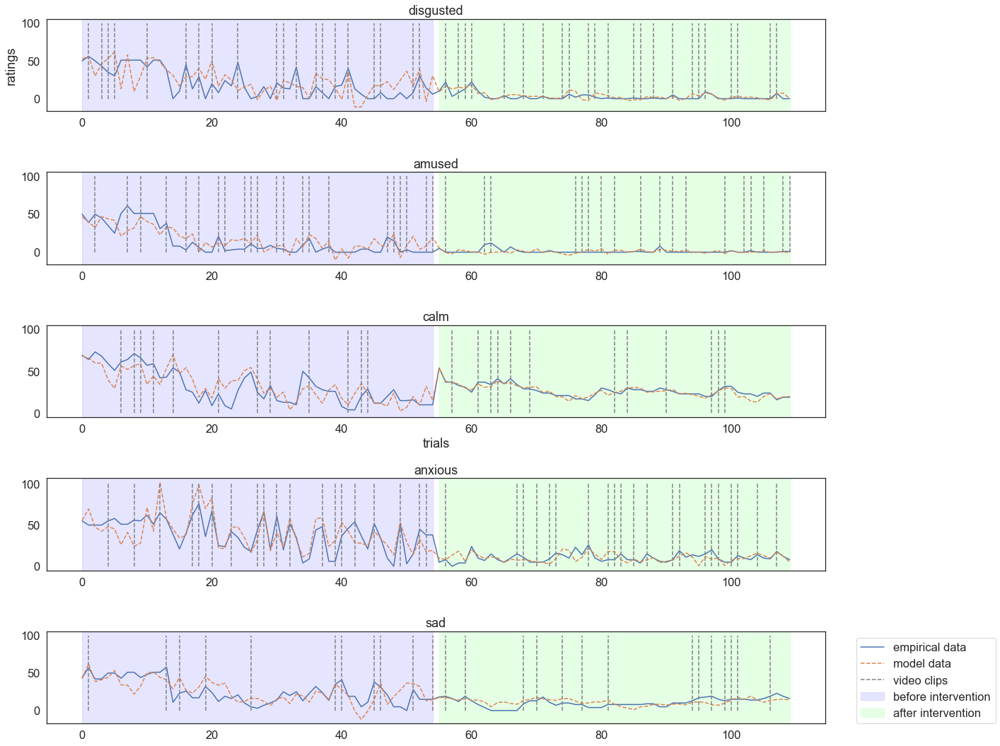

----------------------------------------------------------------------------------------------------
62 1.0


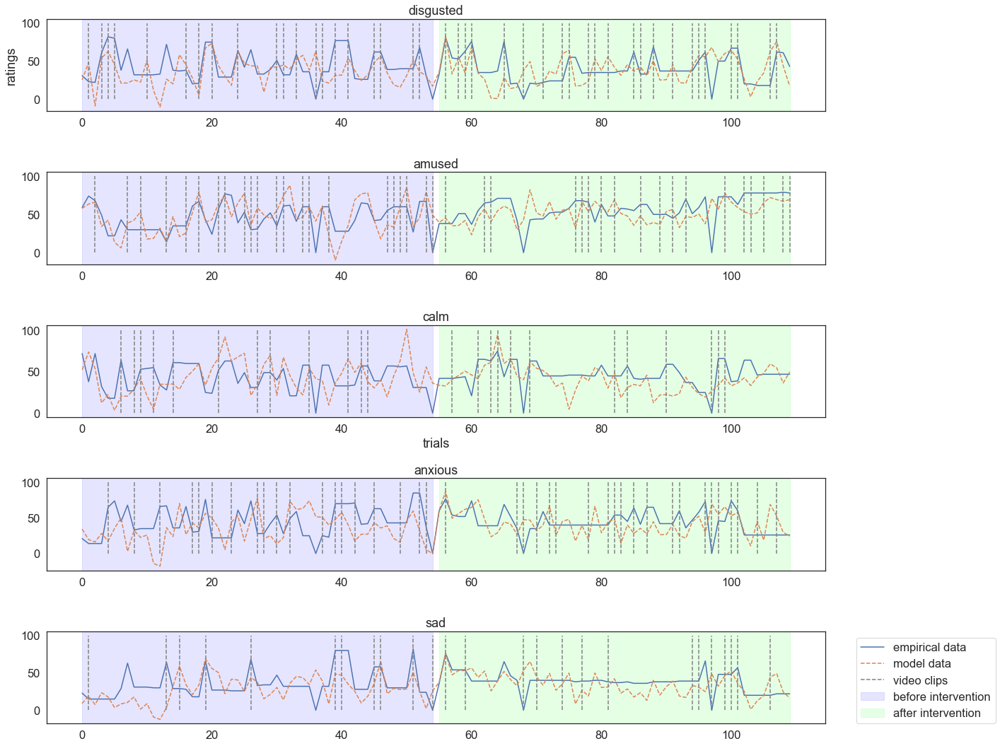

----------------------------------------------------------------------------------------------------
63 0.0


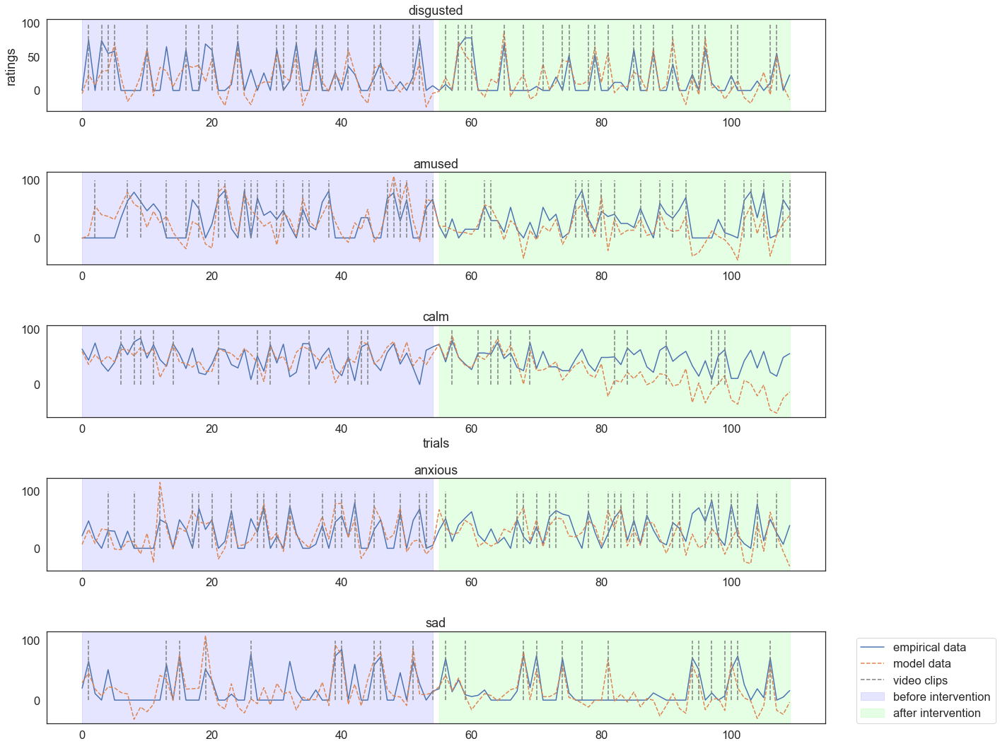

----------------------------------------------------------------------------------------------------
64 1.0


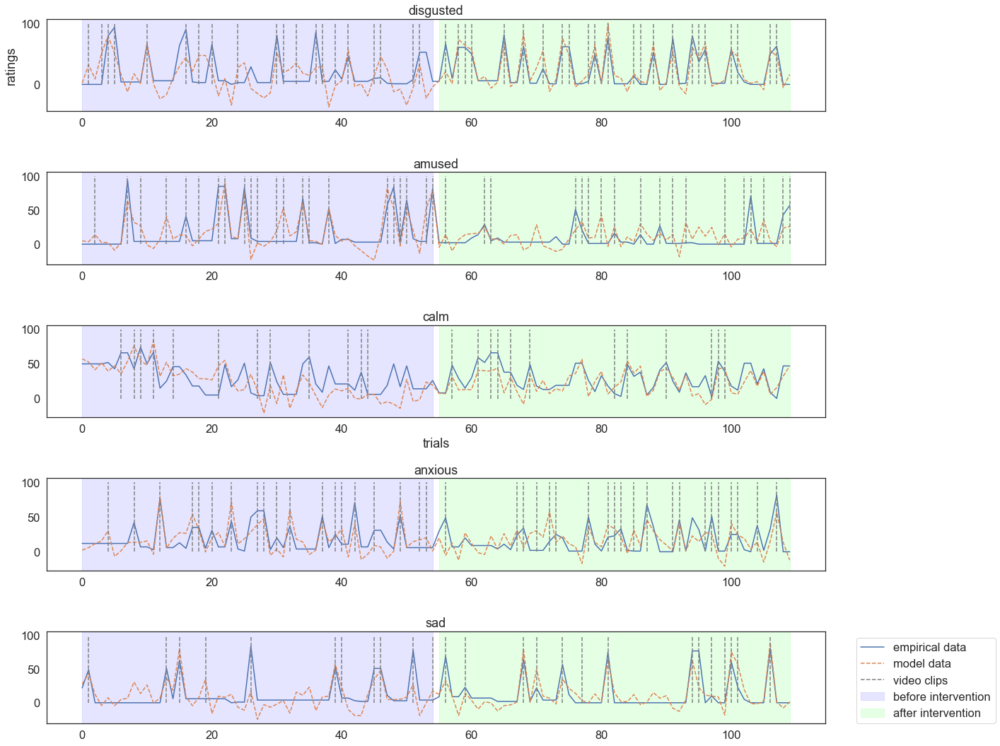

----------------------------------------------------------------------------------------------------
65 1.0


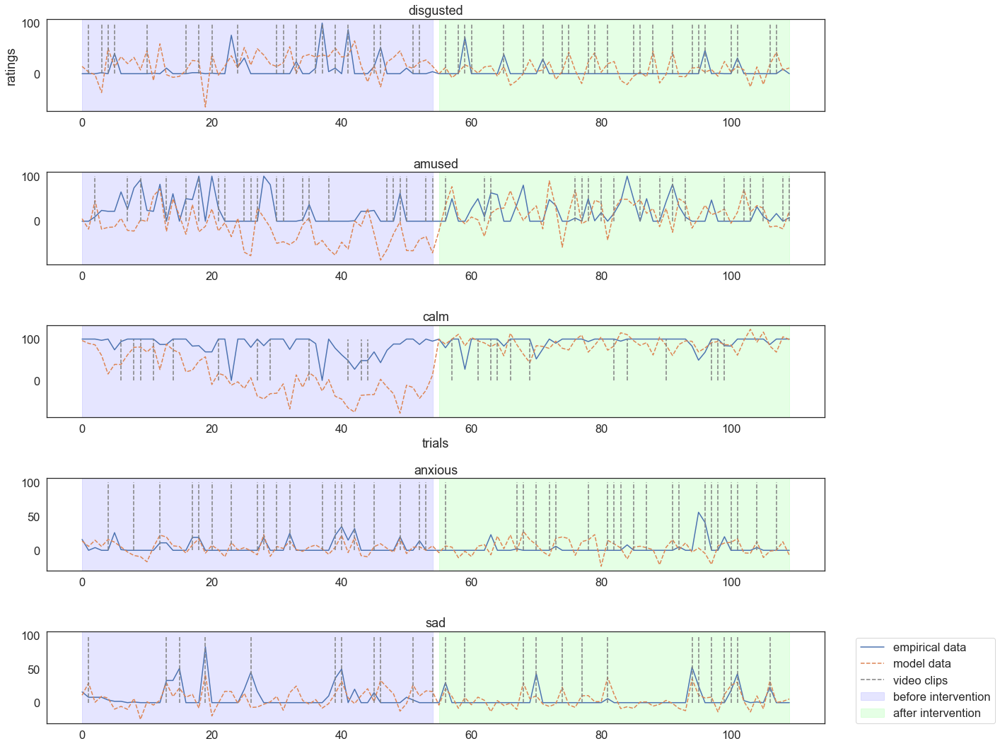

----------------------------------------------------------------------------------------------------
66 1.0


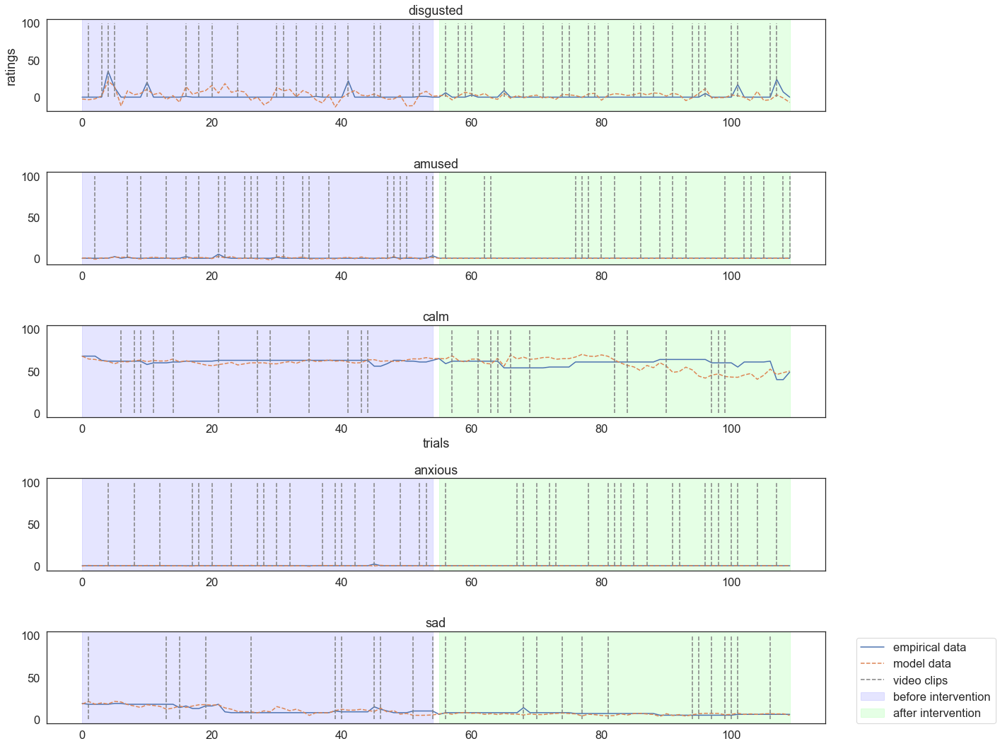

----------------------------------------------------------------------------------------------------
67 1.0


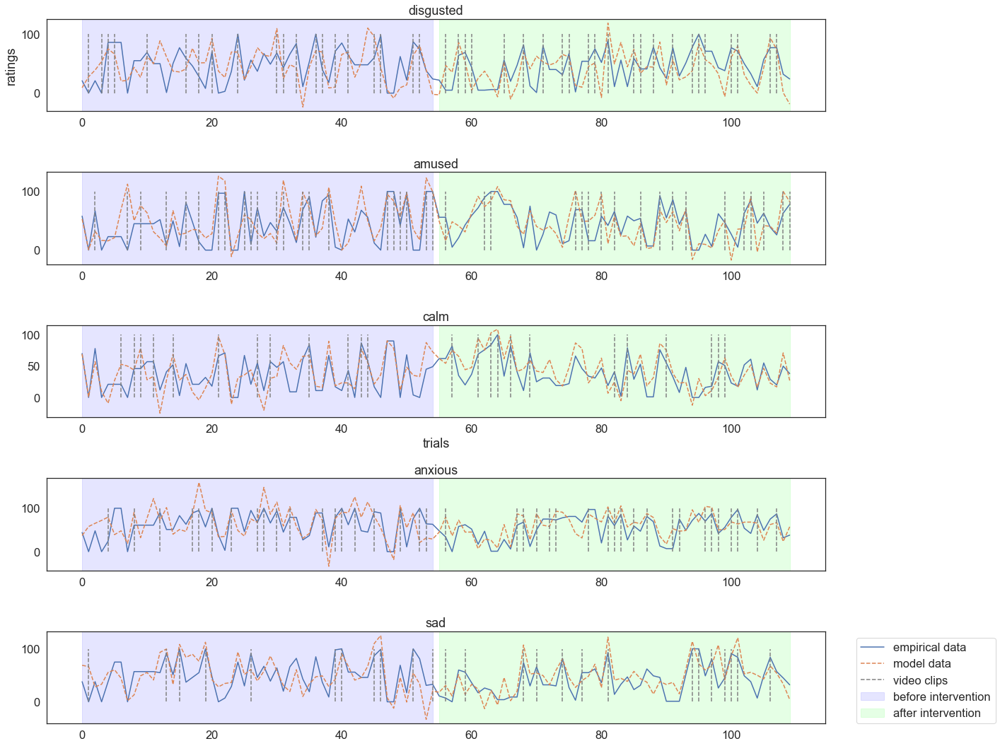

----------------------------------------------------------------------------------------------------
68 0.0


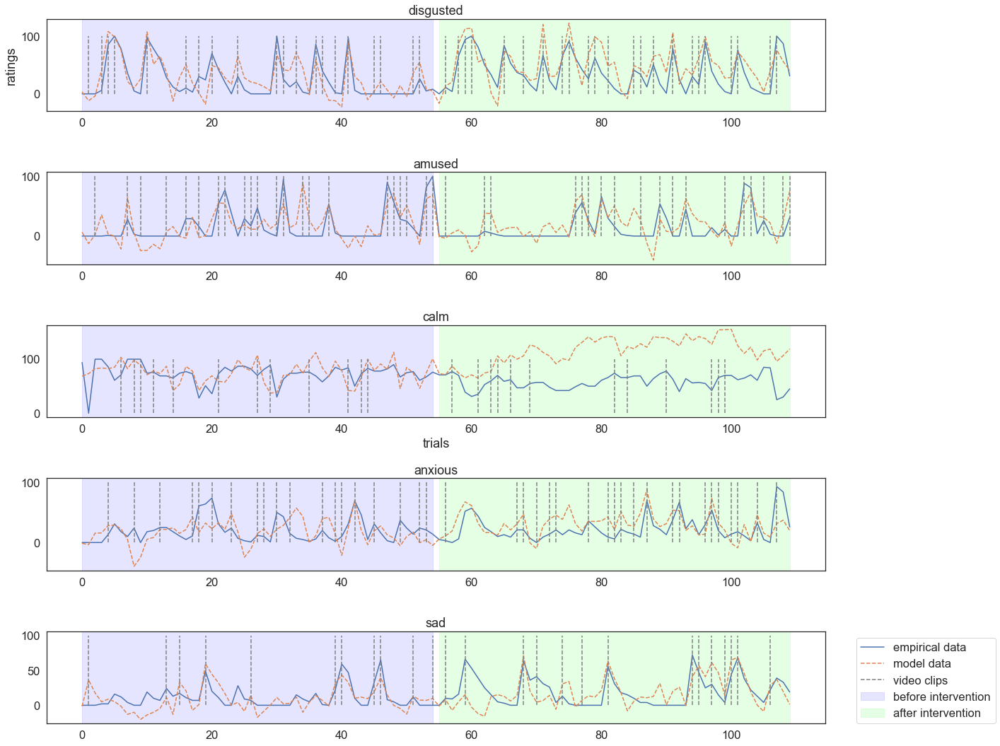

----------------------------------------------------------------------------------------------------
69 1.0


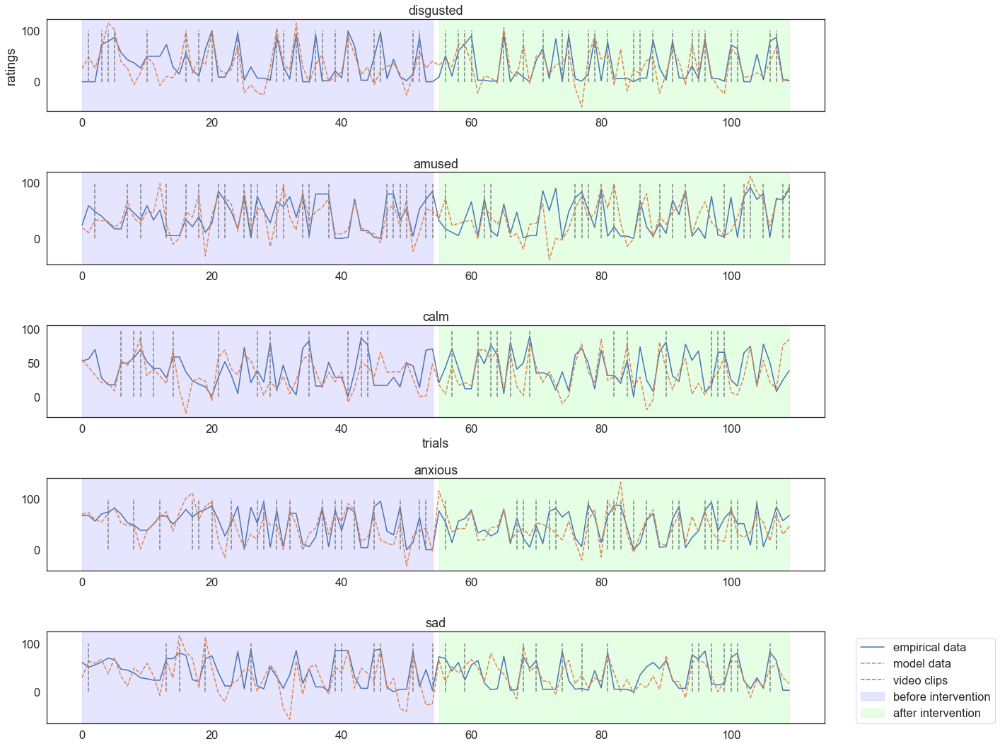

----------------------------------------------------------------------------------------------------
70 1.0


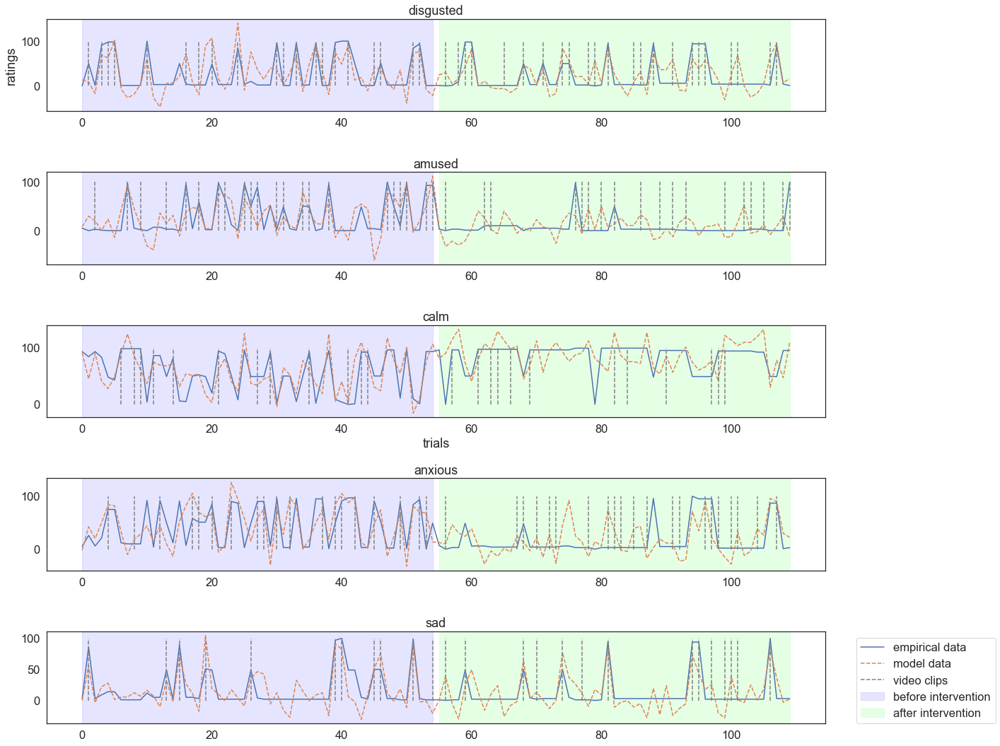

----------------------------------------------------------------------------------------------------
71 0.0


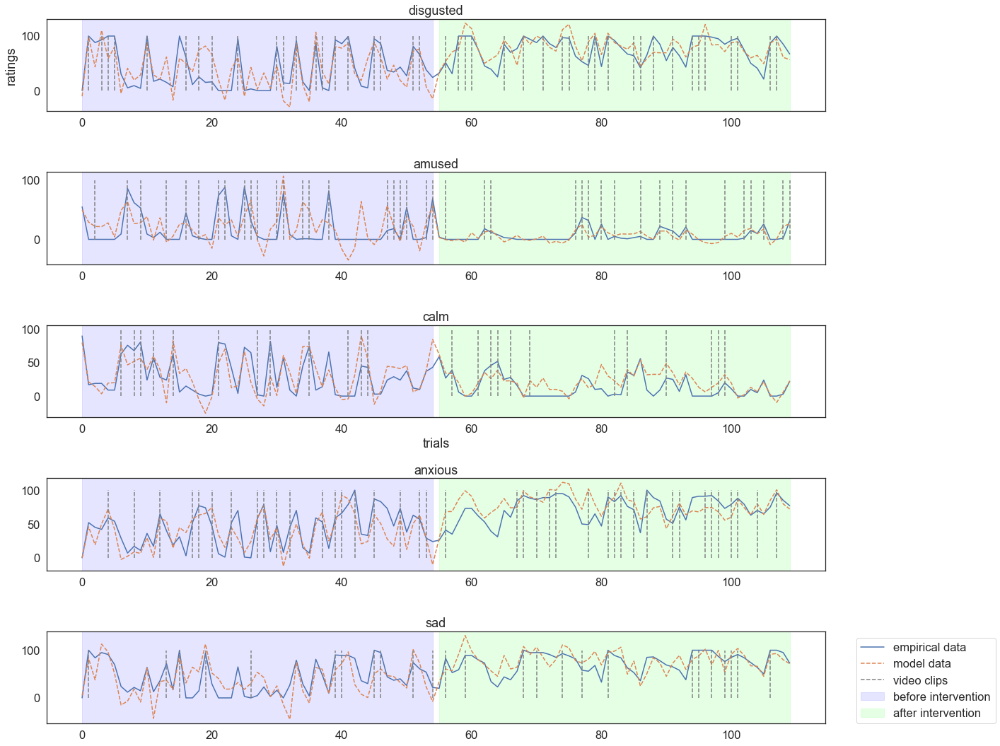

----------------------------------------------------------------------------------------------------
72 0.0


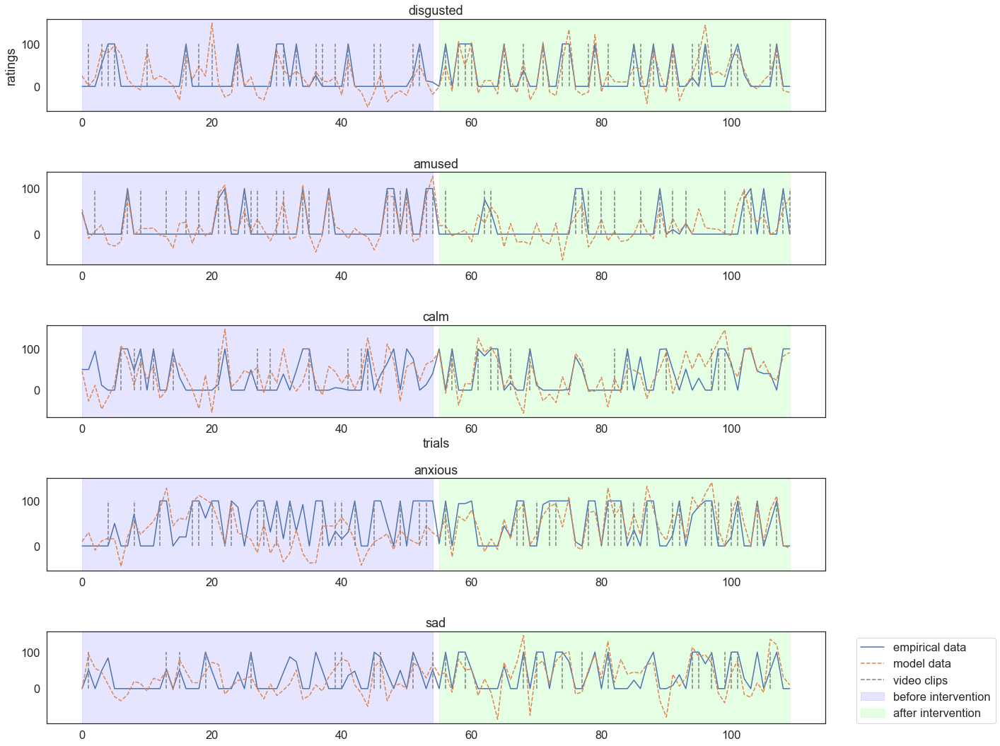

----------------------------------------------------------------------------------------------------
73 1.0


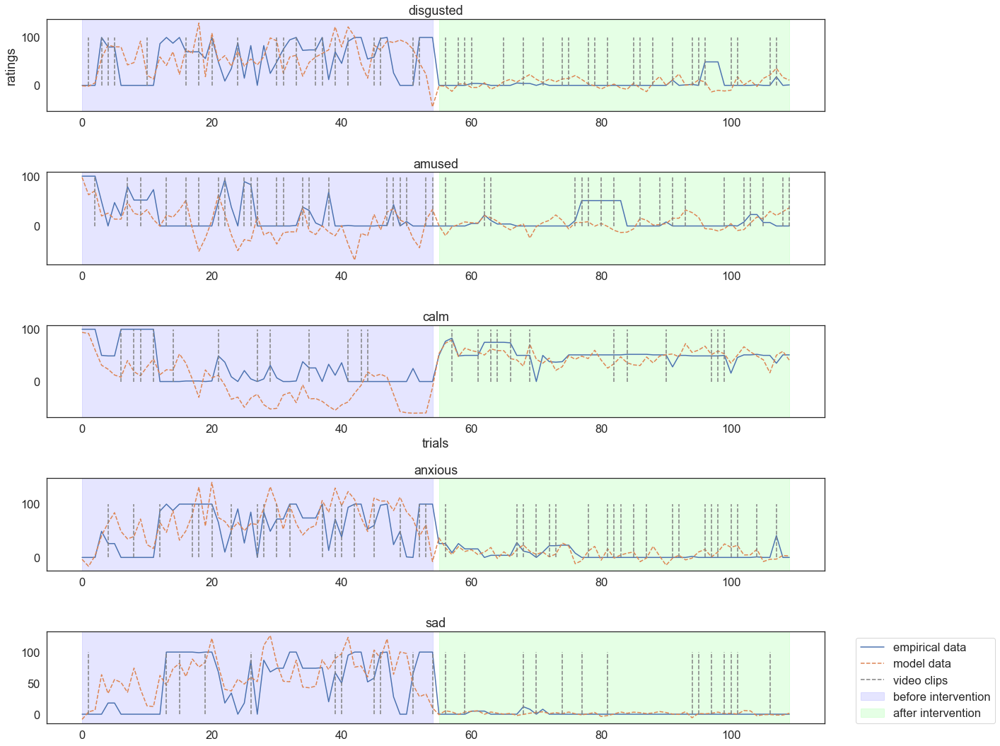

----------------------------------------------------------------------------------------------------
74 1.0


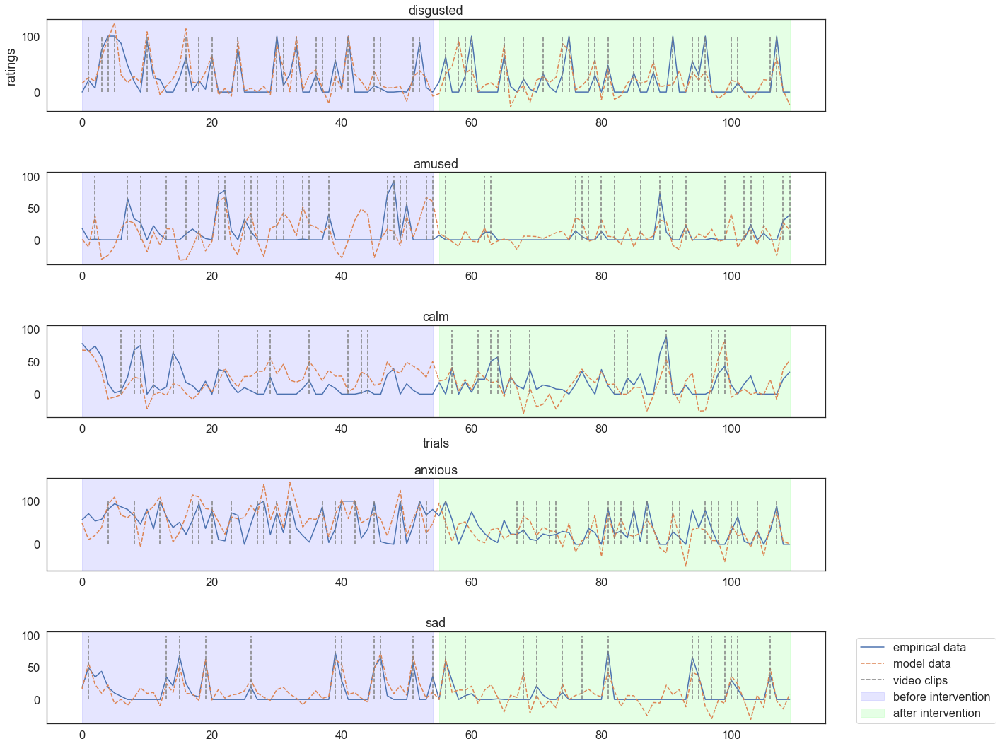

----------------------------------------------------------------------------------------------------
75 0.0


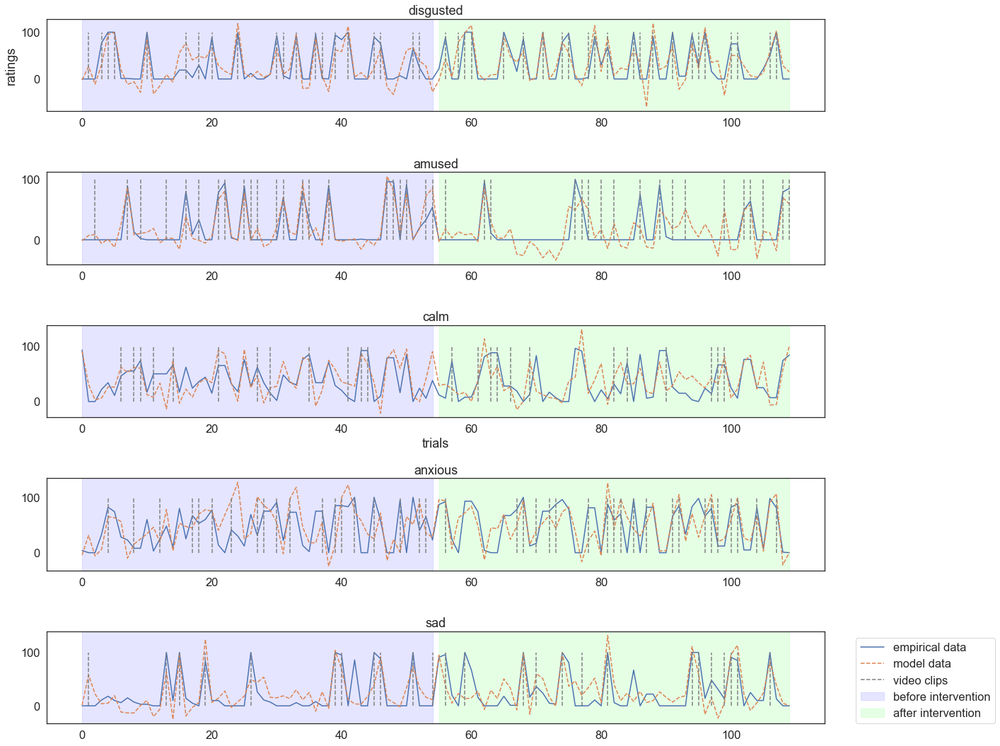

----------------------------------------------------------------------------------------------------
76 1.0


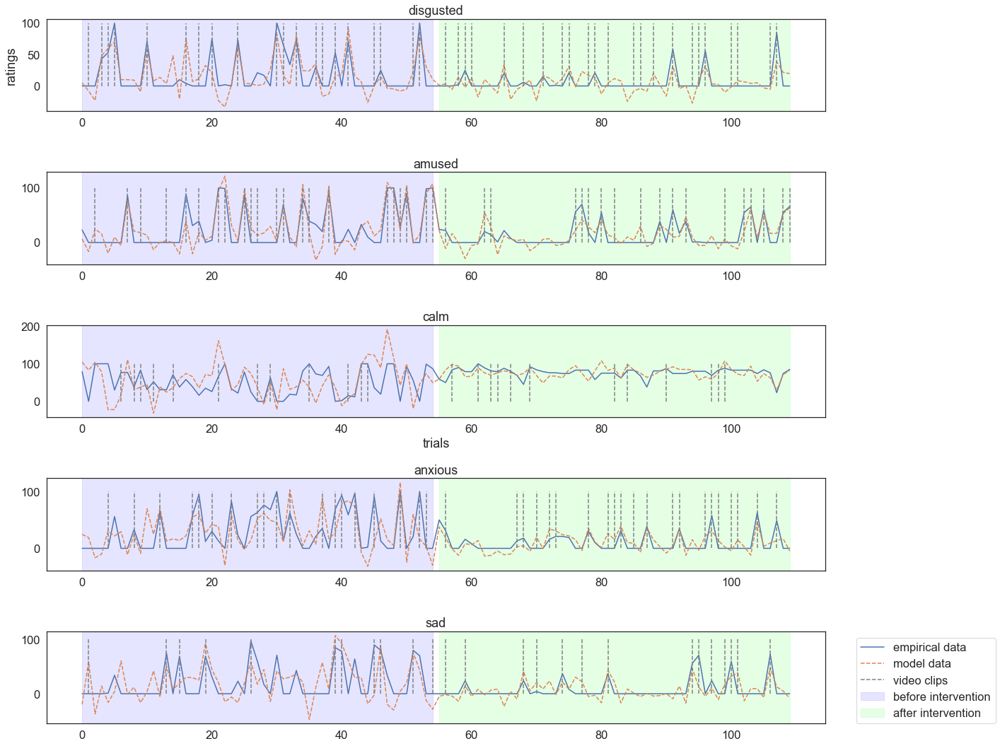

----------------------------------------------------------------------------------------------------
77 1.0


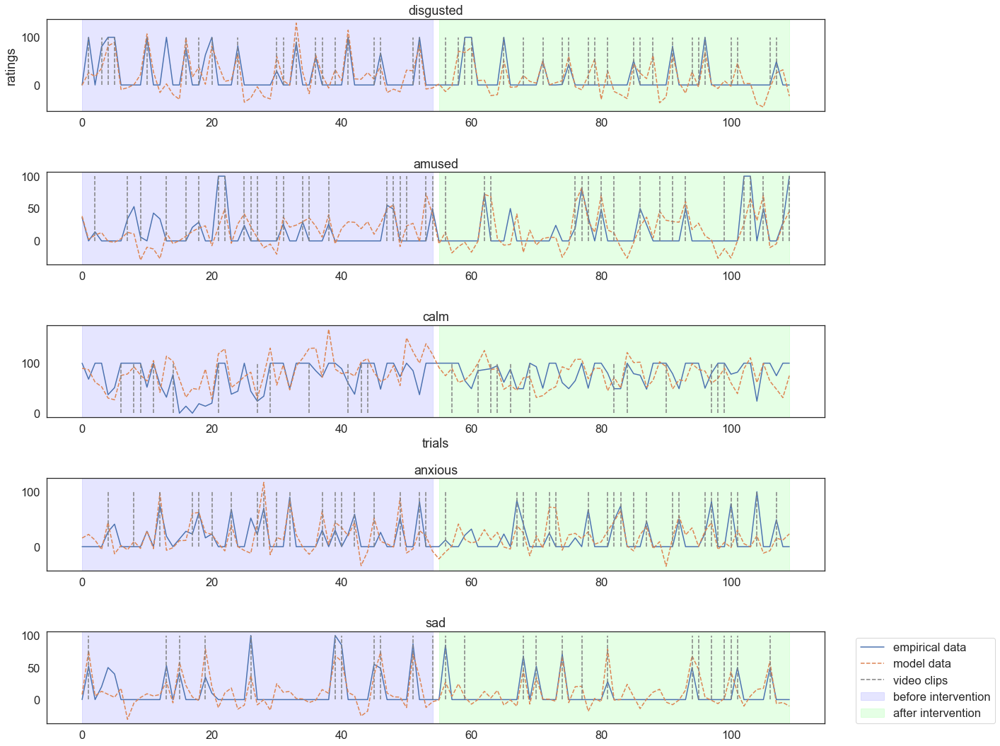

----------------------------------------------------------------------------------------------------
78 0.0


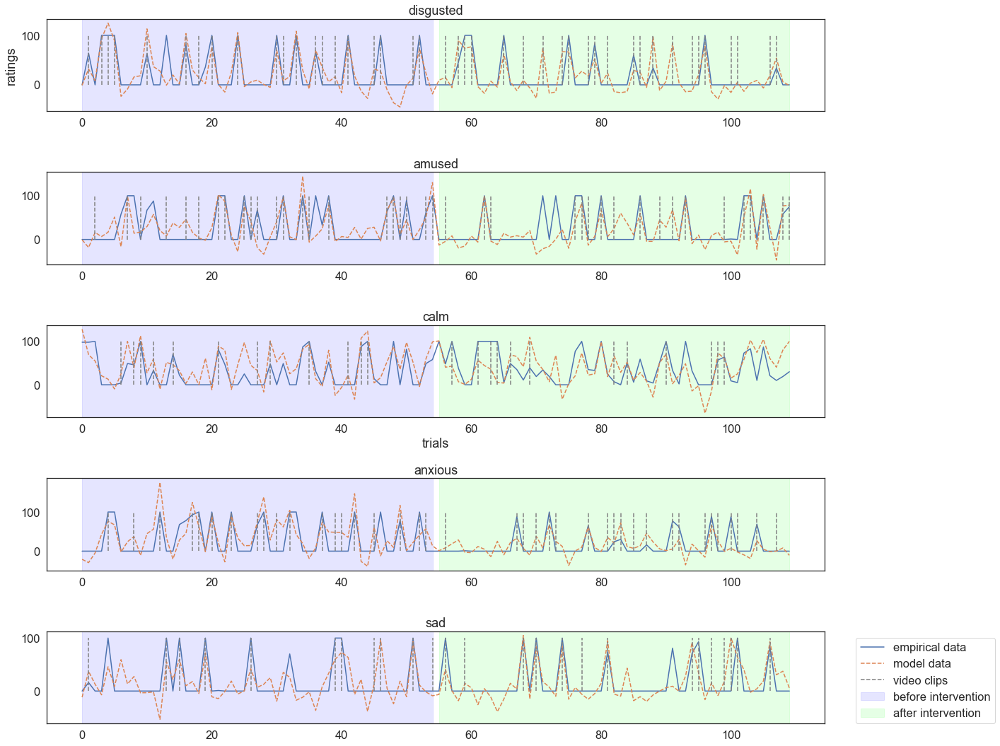

----------------------------------------------------------------------------------------------------
79 0.0


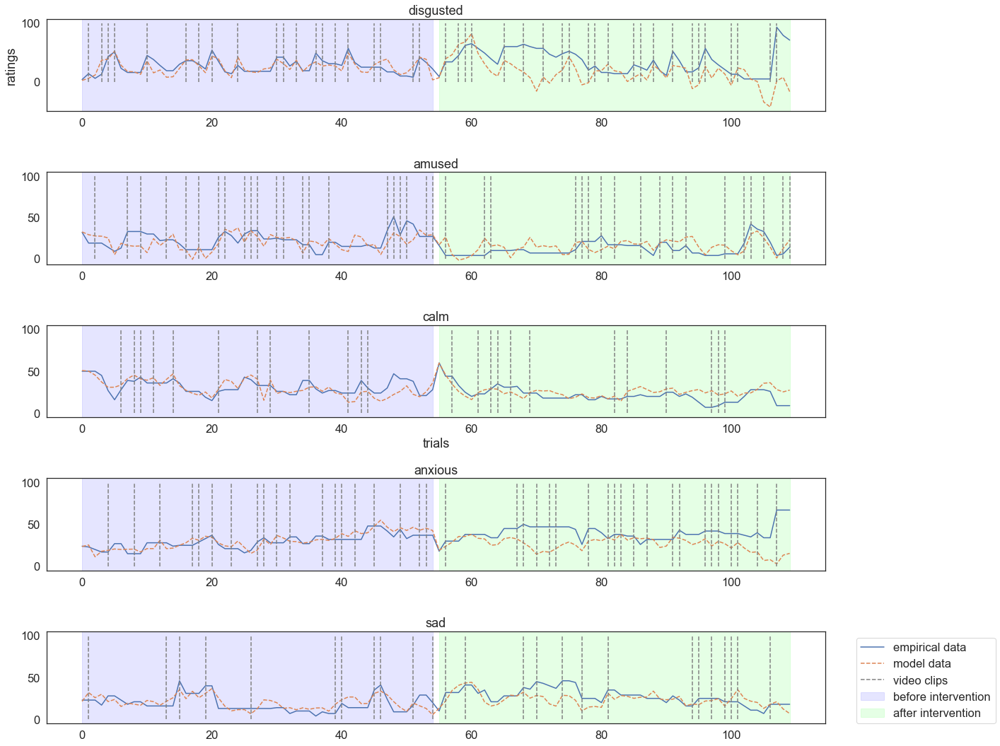

----------------------------------------------------------------------------------------------------
80 1.0


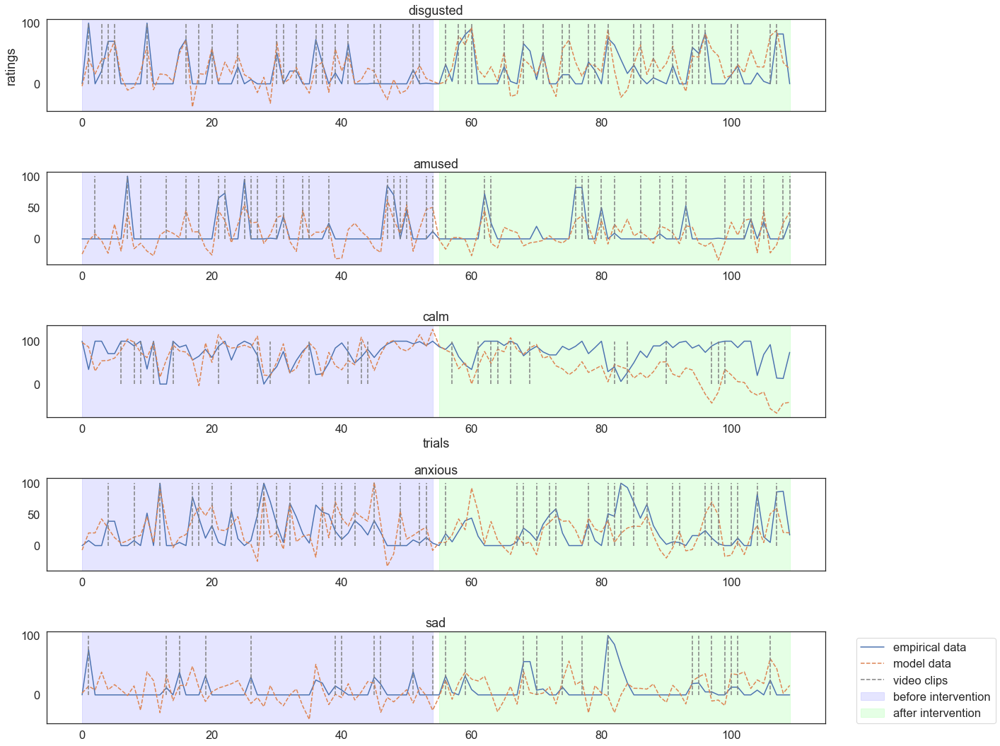

----------------------------------------------------------------------------------------------------
81 1.0


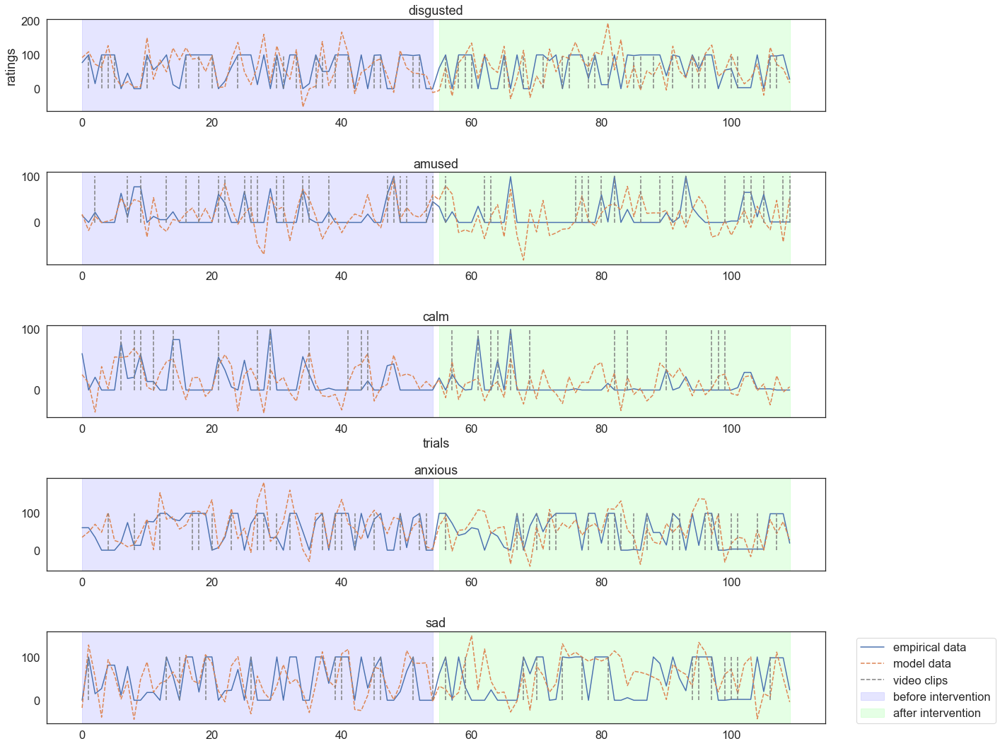

----------------------------------------------------------------------------------------------------
82 0.0


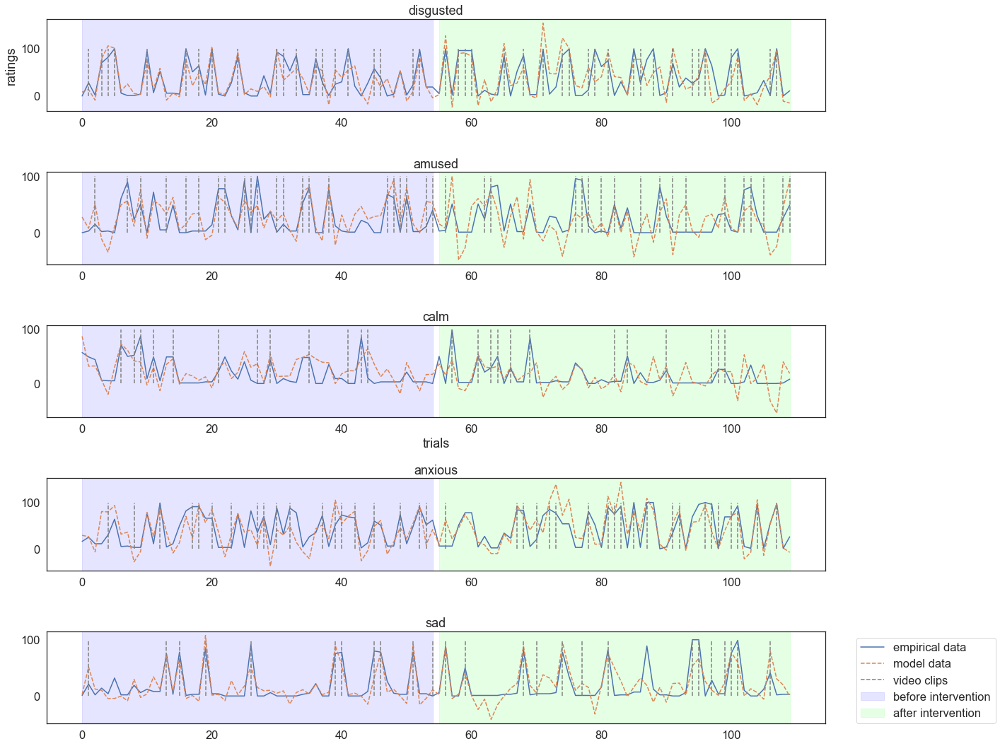

----------------------------------------------------------------------------------------------------
83 1.0


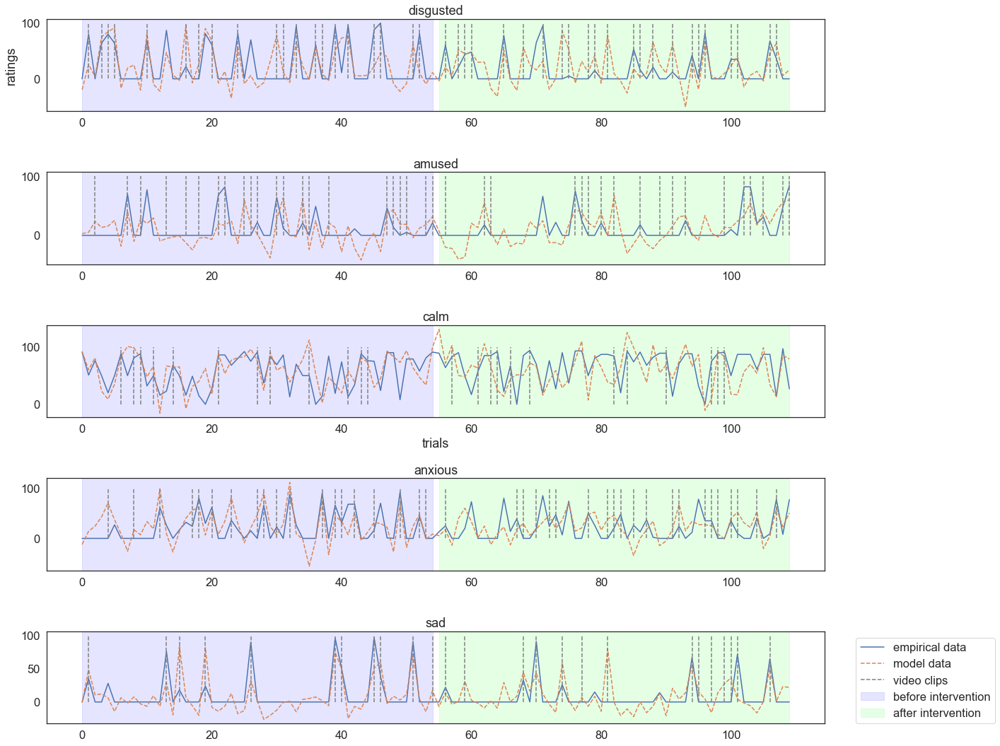

----------------------------------------------------------------------------------------------------
84 0.0


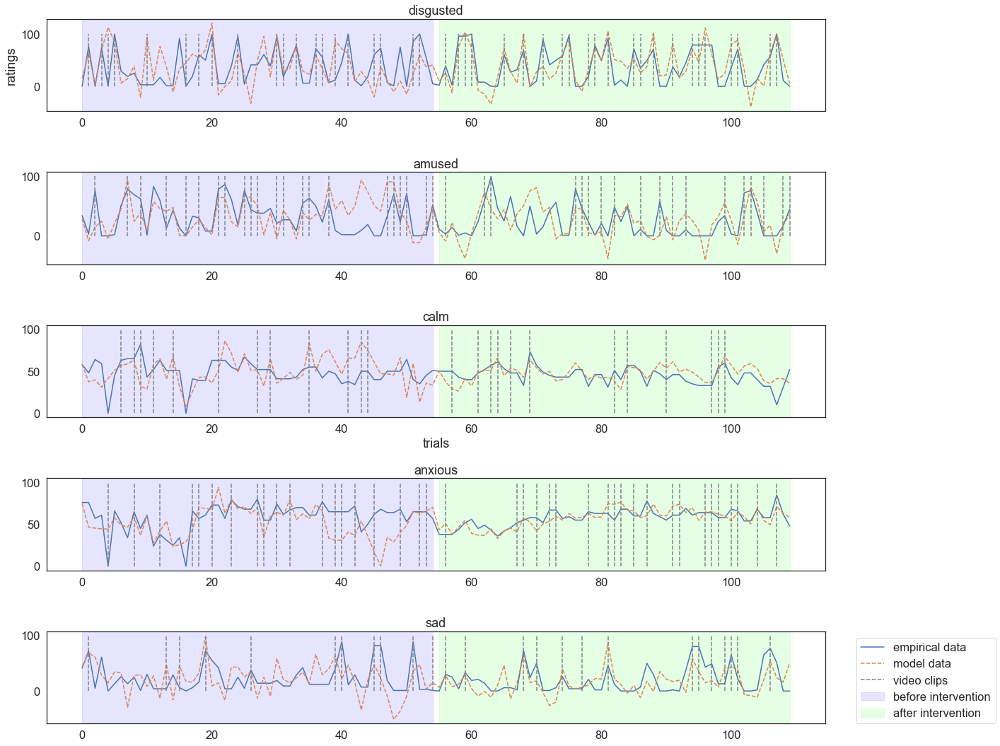

----------------------------------------------------------------------------------------------------
85 1.0


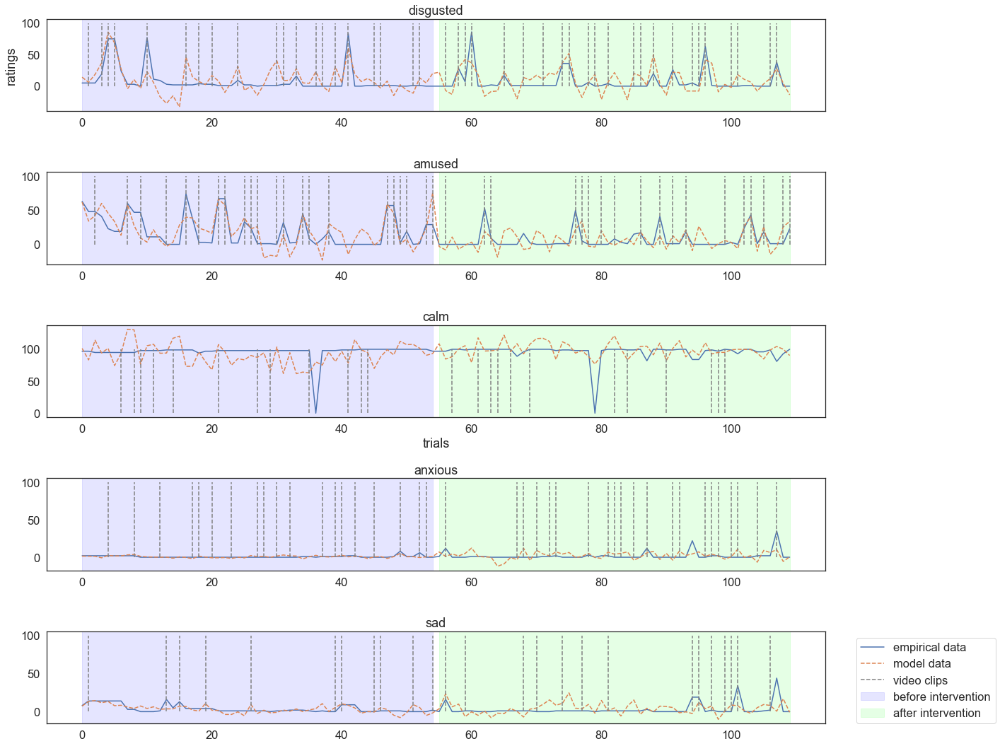

----------------------------------------------------------------------------------------------------
86 0.0


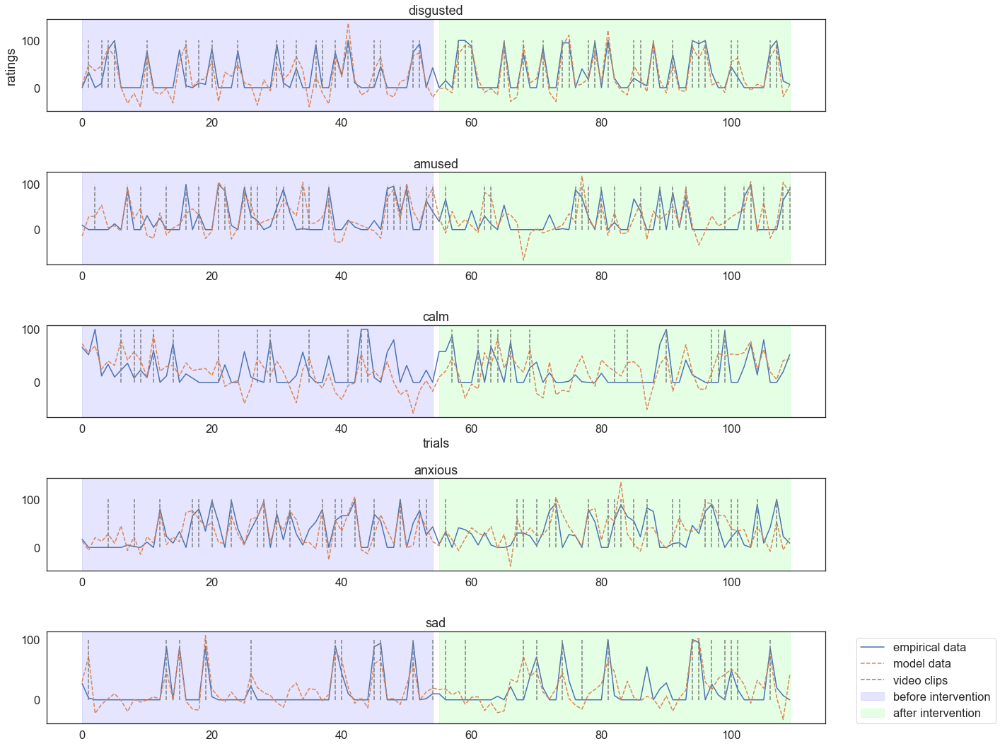

----------------------------------------------------------------------------------------------------
87 0.0


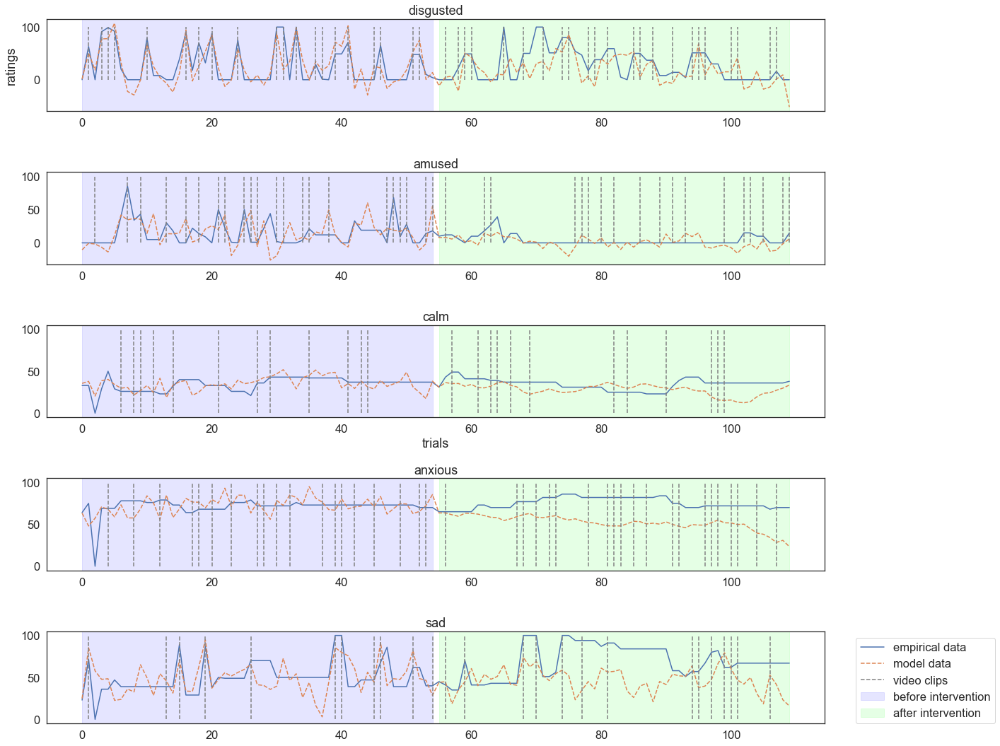

----------------------------------------------------------------------------------------------------
88 0.0


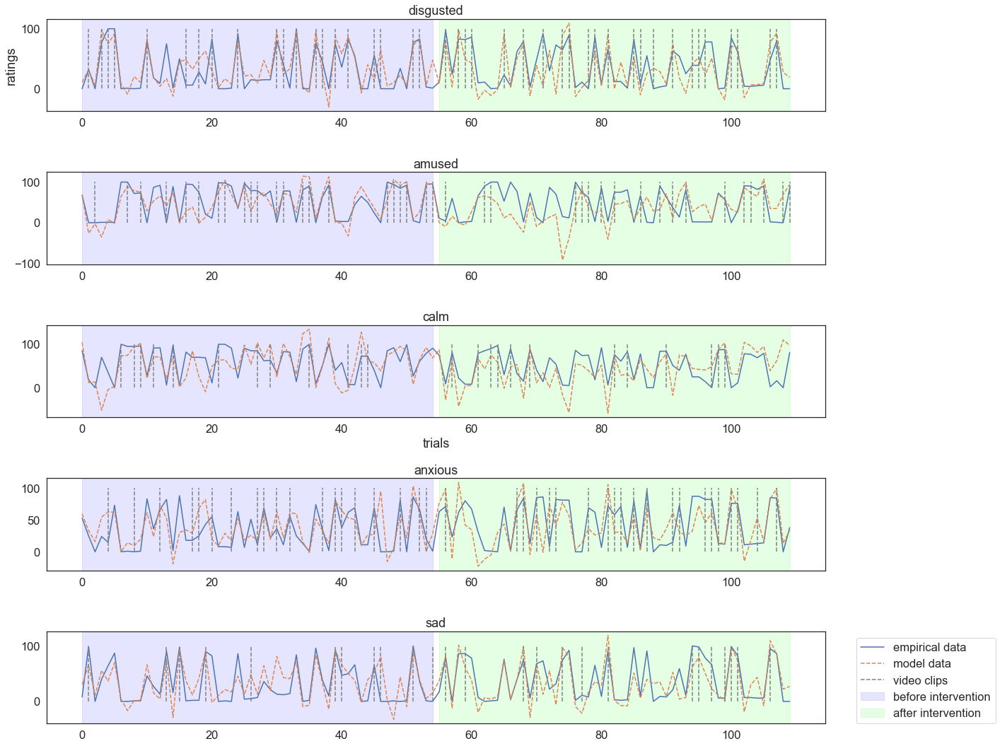

----------------------------------------------------------------------------------------------------
89 0.0


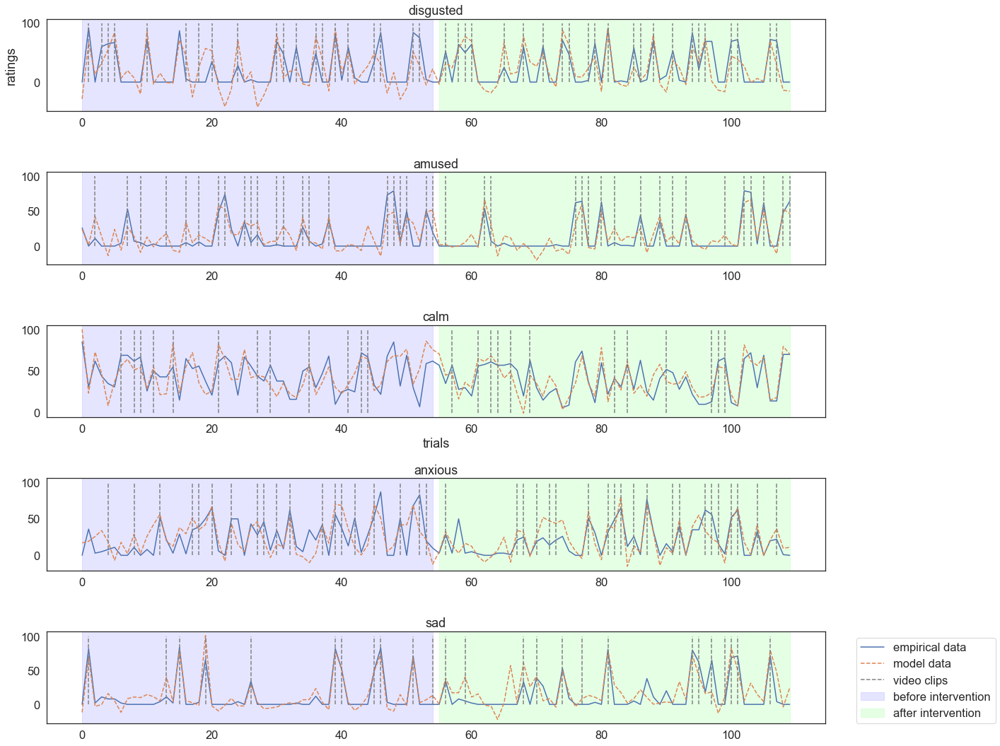

----------------------------------------------------------------------------------------------------
90 0.0


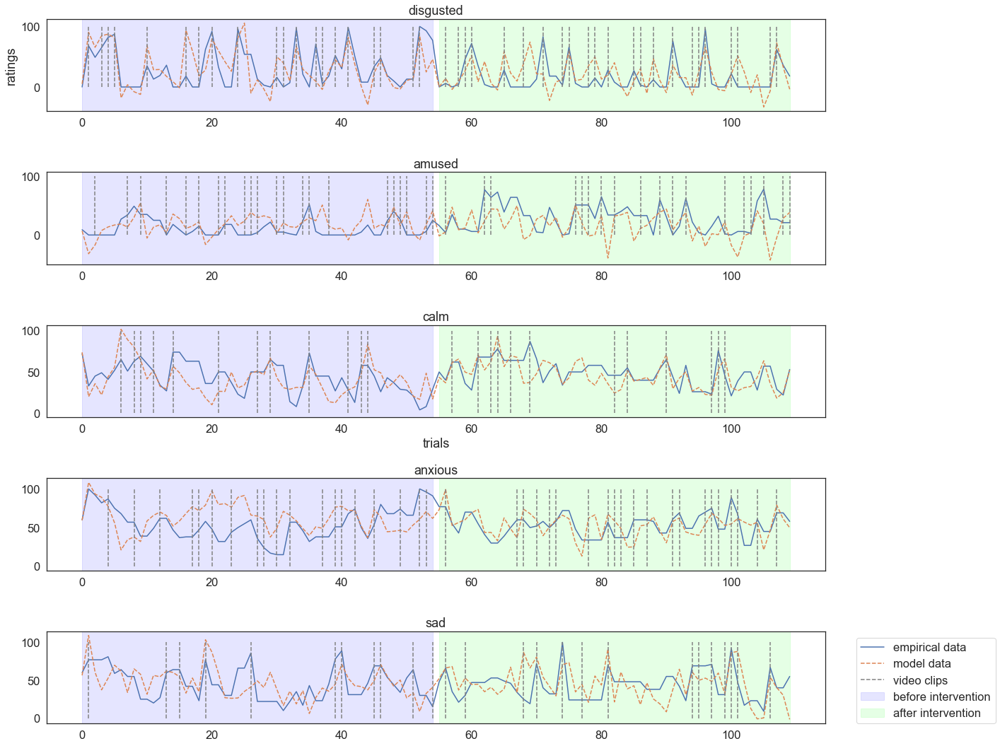

----------------------------------------------------------------------------------------------------
91 1.0


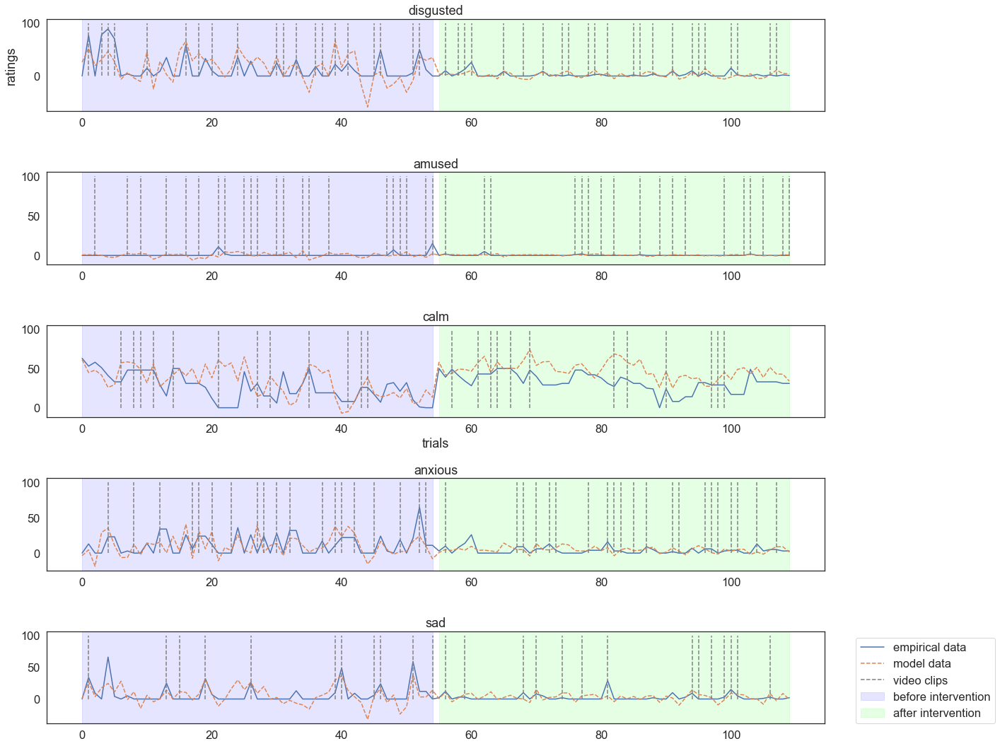

----------------------------------------------------------------------------------------------------
92 0.0


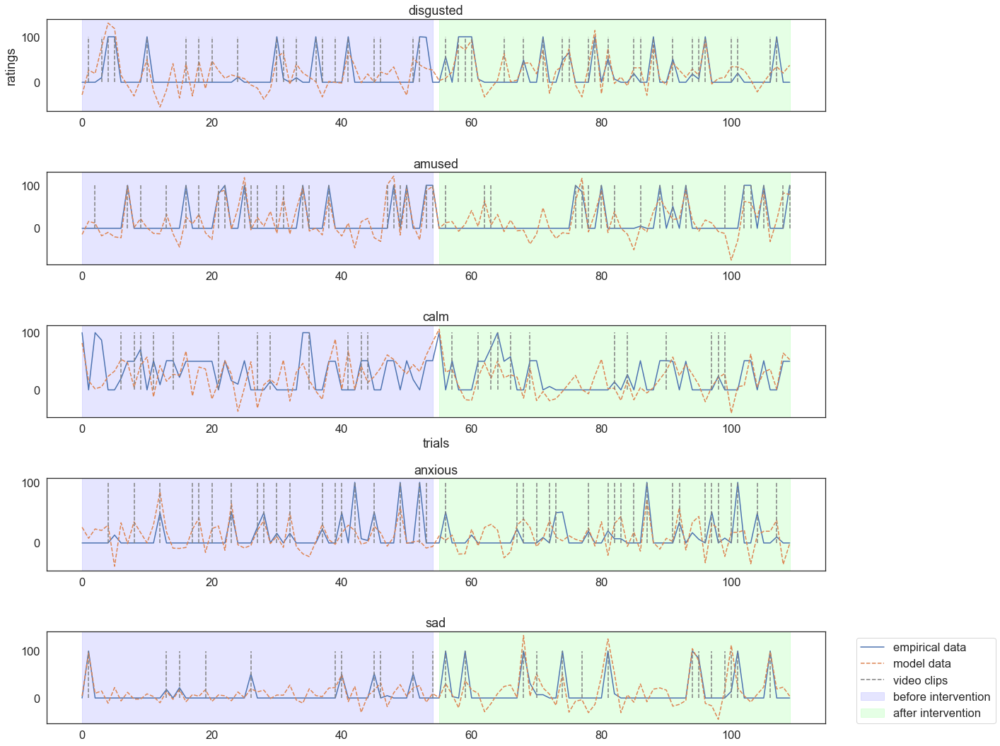

----------------------------------------------------------------------------------------------------
93 0.0


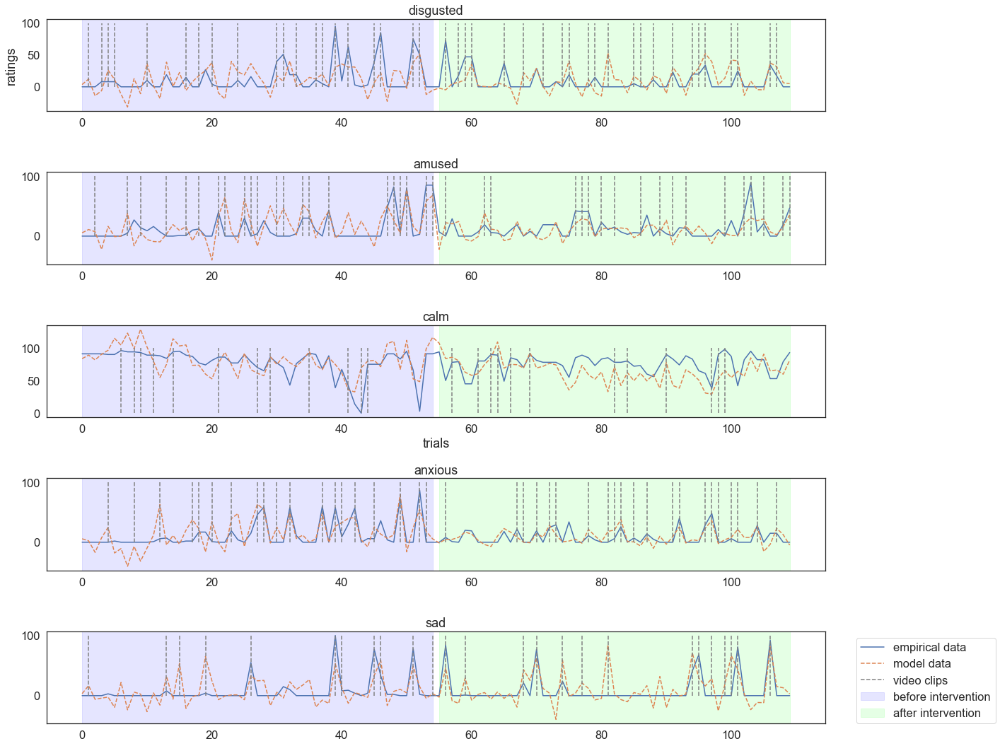

----------------------------------------------------------------------------------------------------
94 0.0


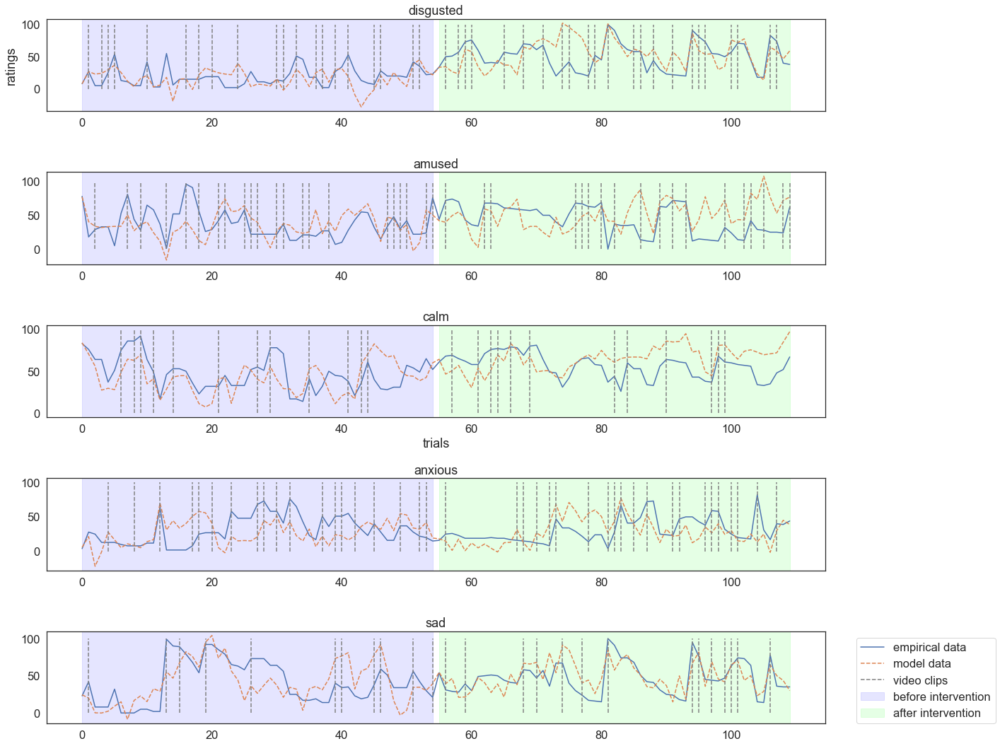

----------------------------------------------------------------------------------------------------
95 1.0


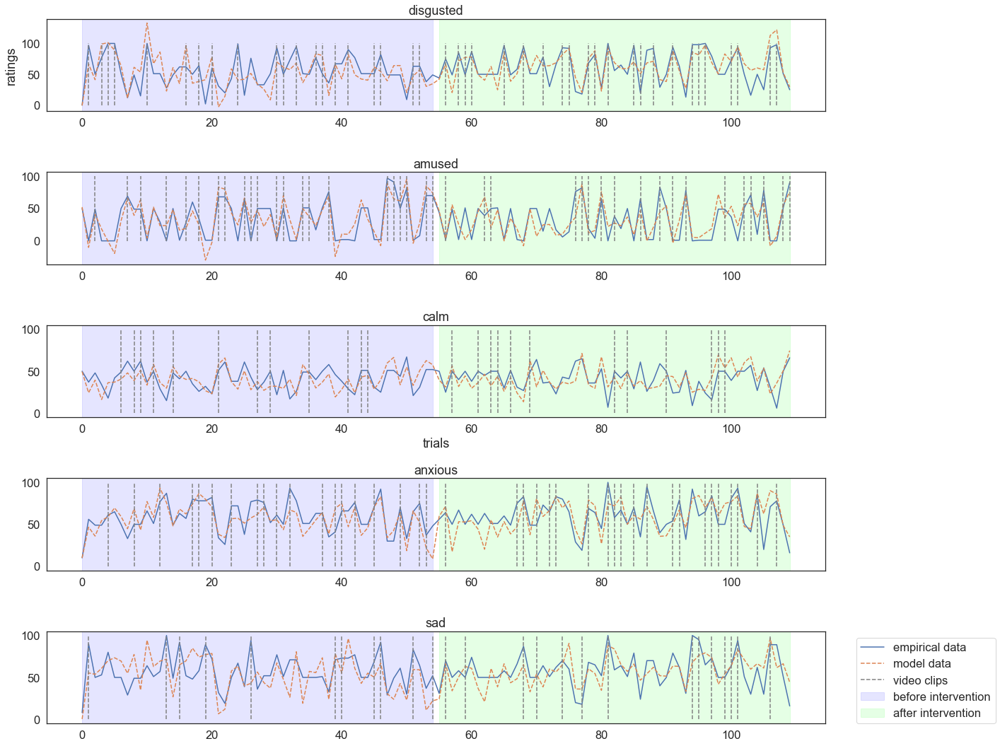

----------------------------------------------------------------------------------------------------
96 0.0


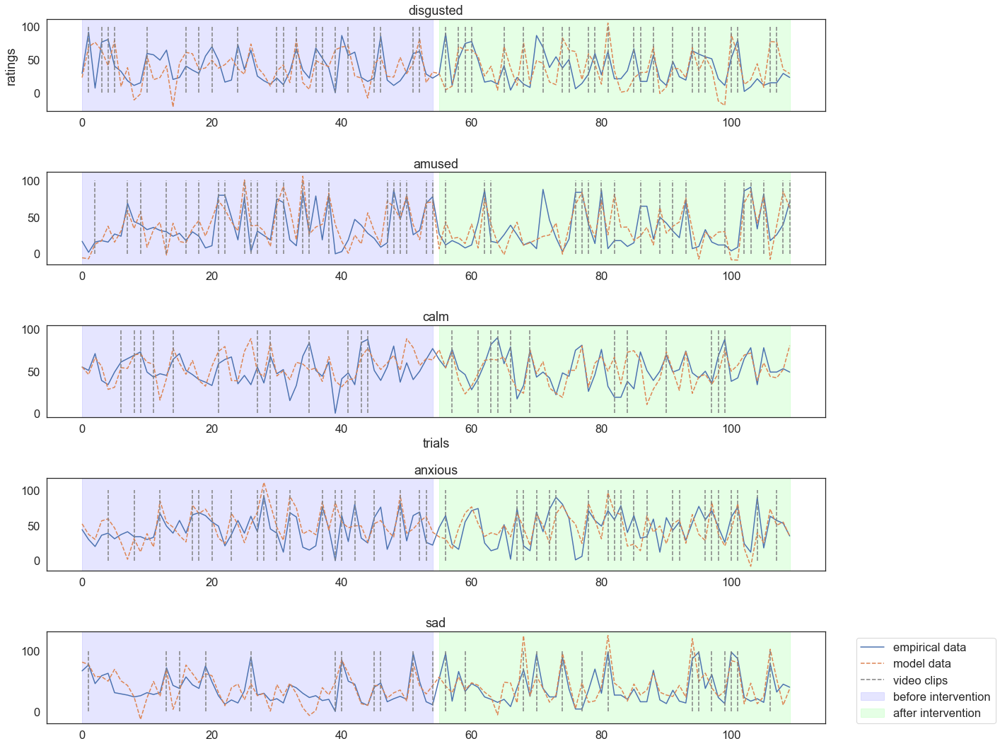

----------------------------------------------------------------------------------------------------
97 0.0


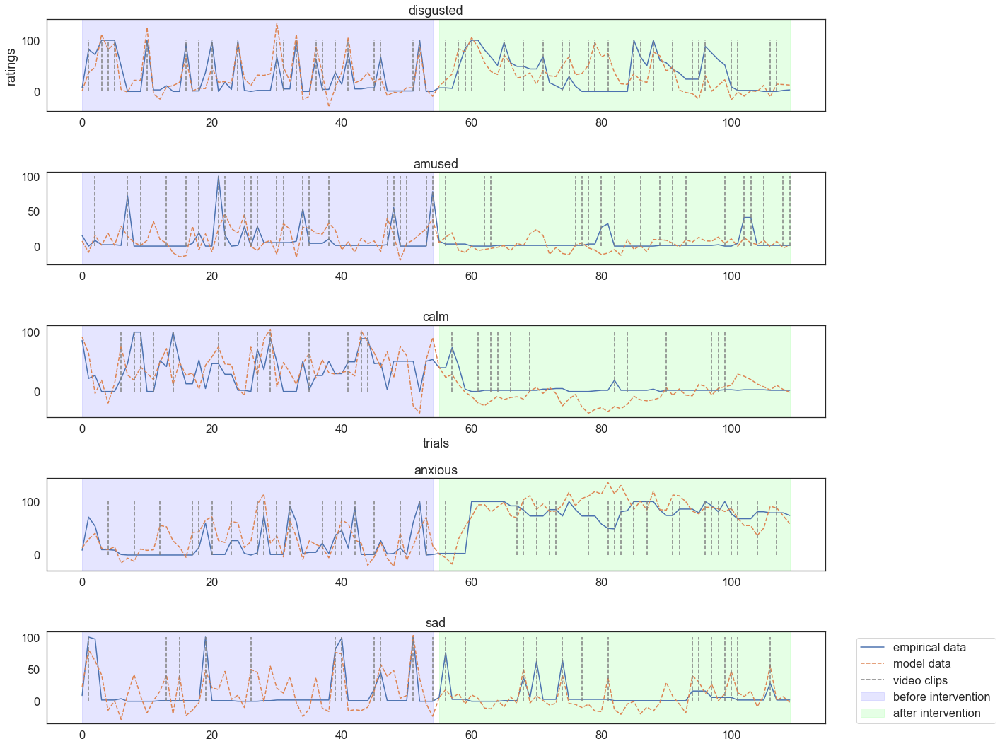

----------------------------------------------------------------------------------------------------
98 0.0


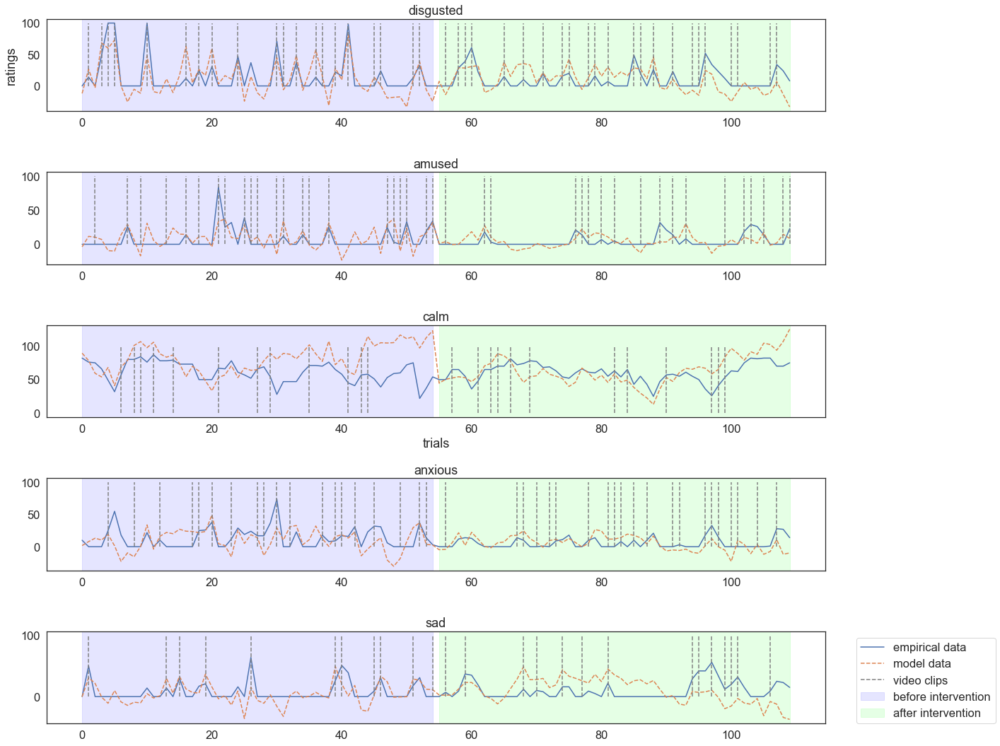

----------------------------------------------------------------------------------------------------
99 0.0


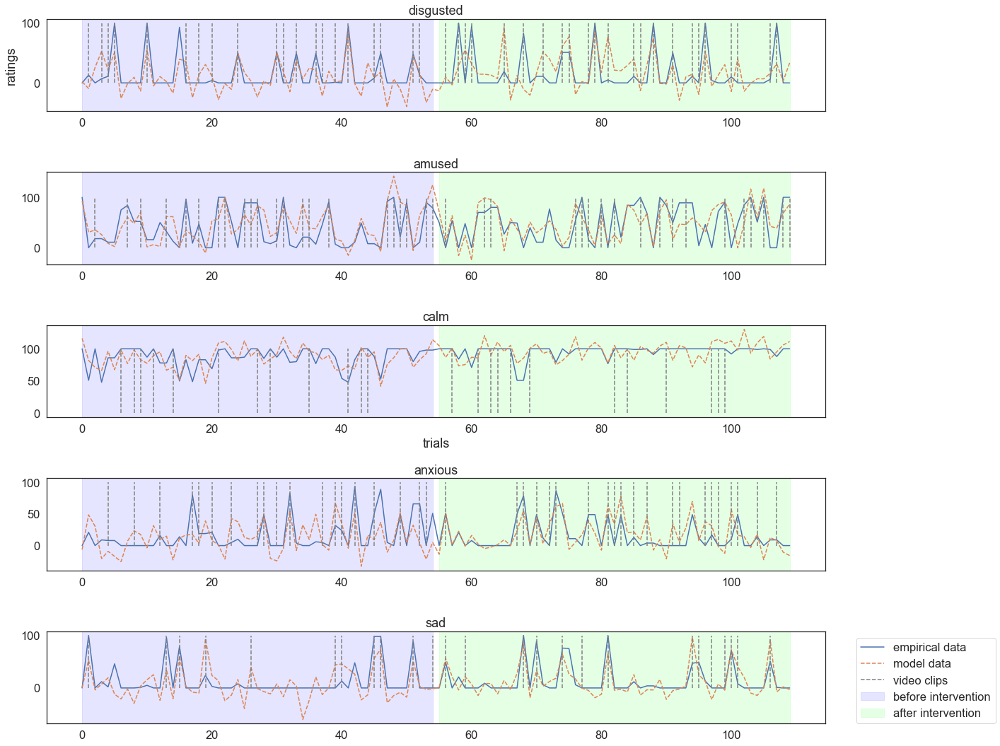

----------------------------------------------------------------------------------------------------
100 0.0


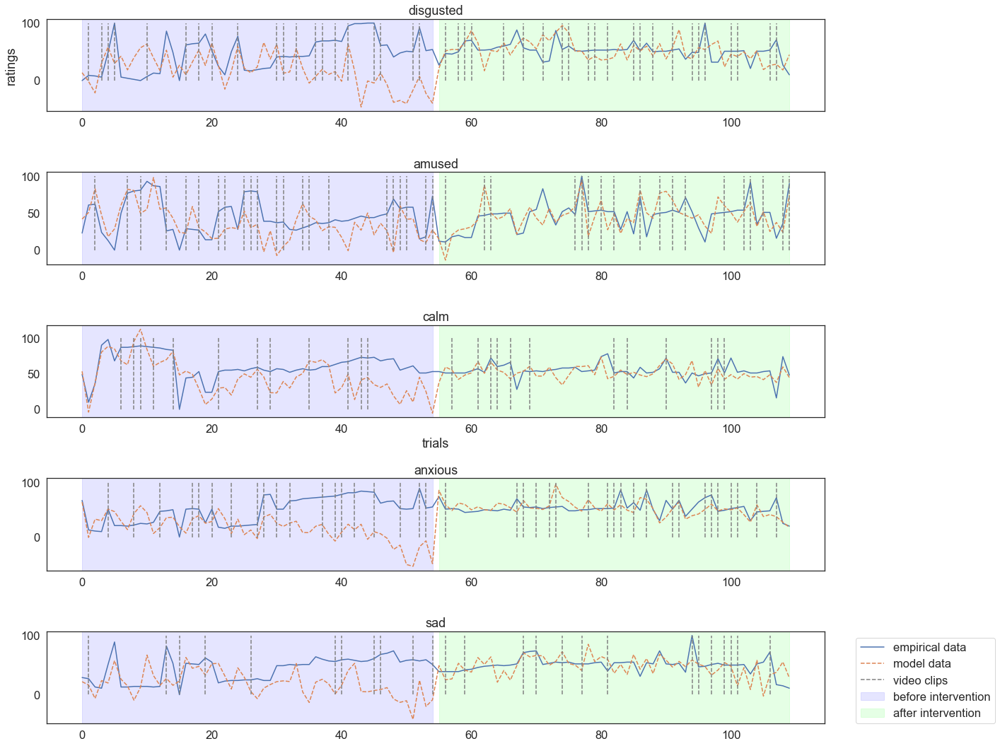

----------------------------------------------------------------------------------------------------
101 0.0


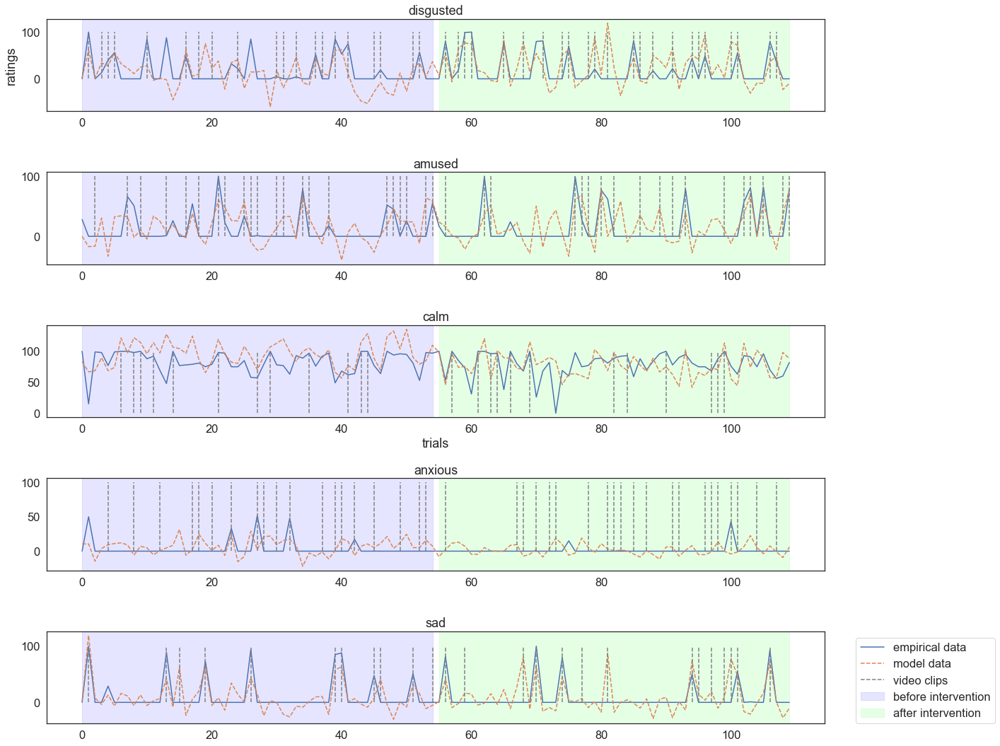

----------------------------------------------------------------------------------------------------
102 1.0


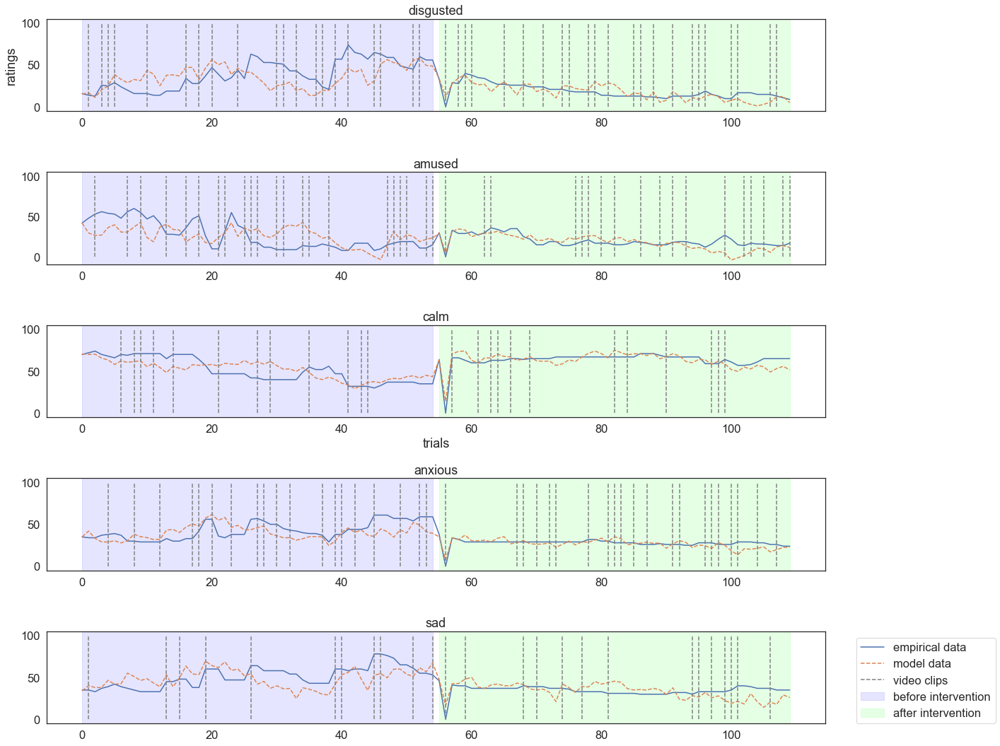

----------------------------------------------------------------------------------------------------
103 1.0


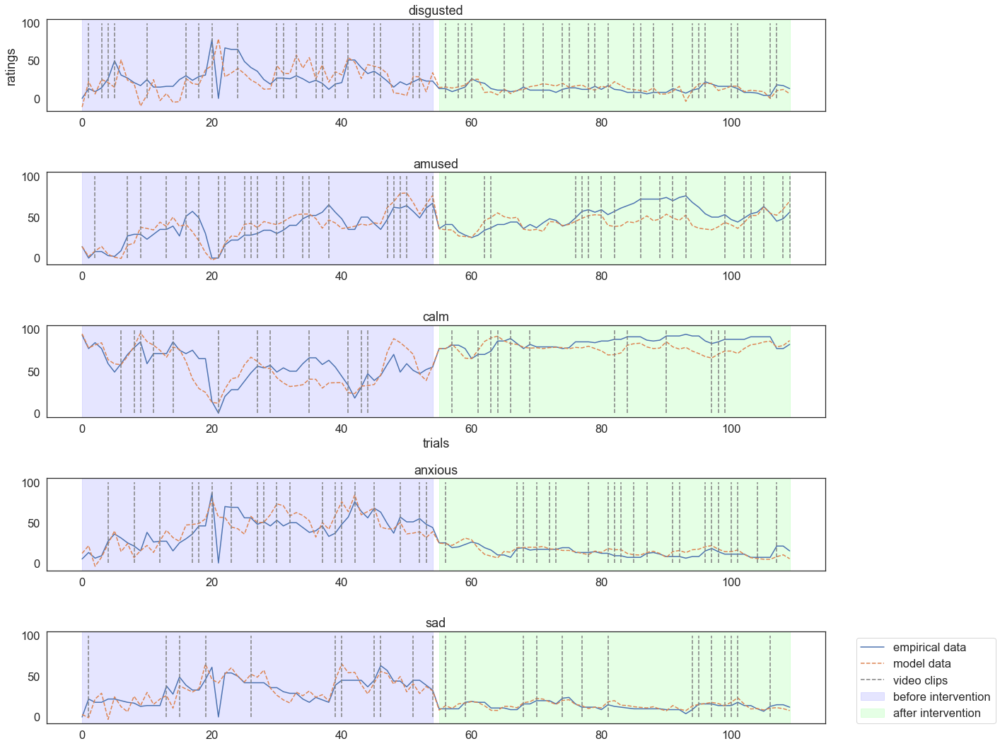

----------------------------------------------------------------------------------------------------
104 1.0


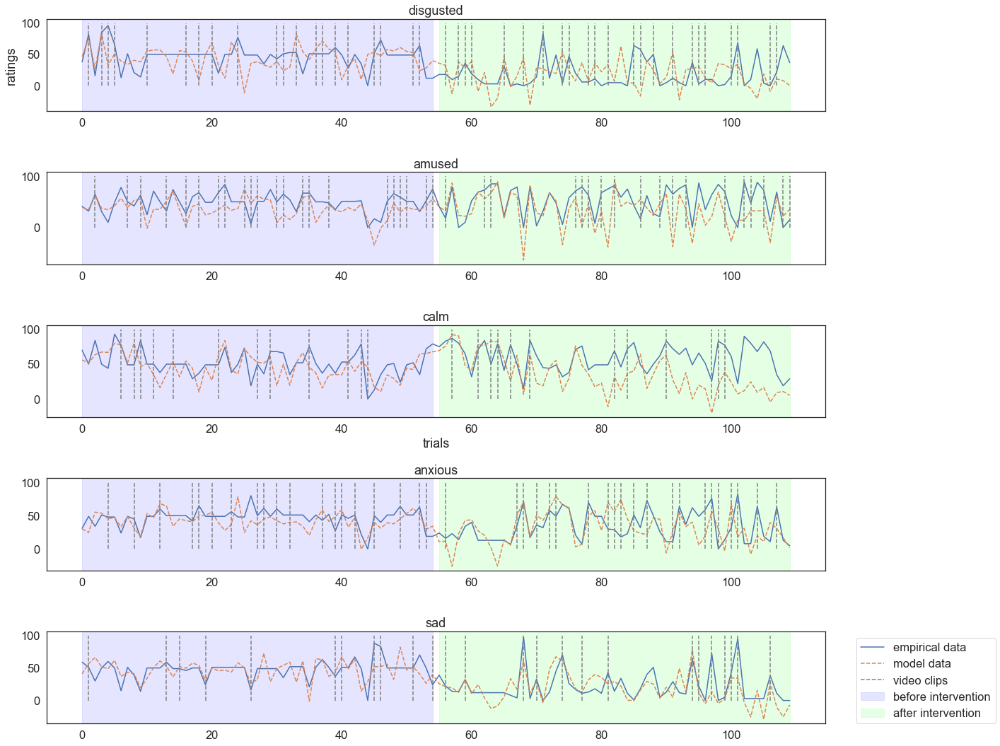

----------------------------------------------------------------------------------------------------
105 1.0


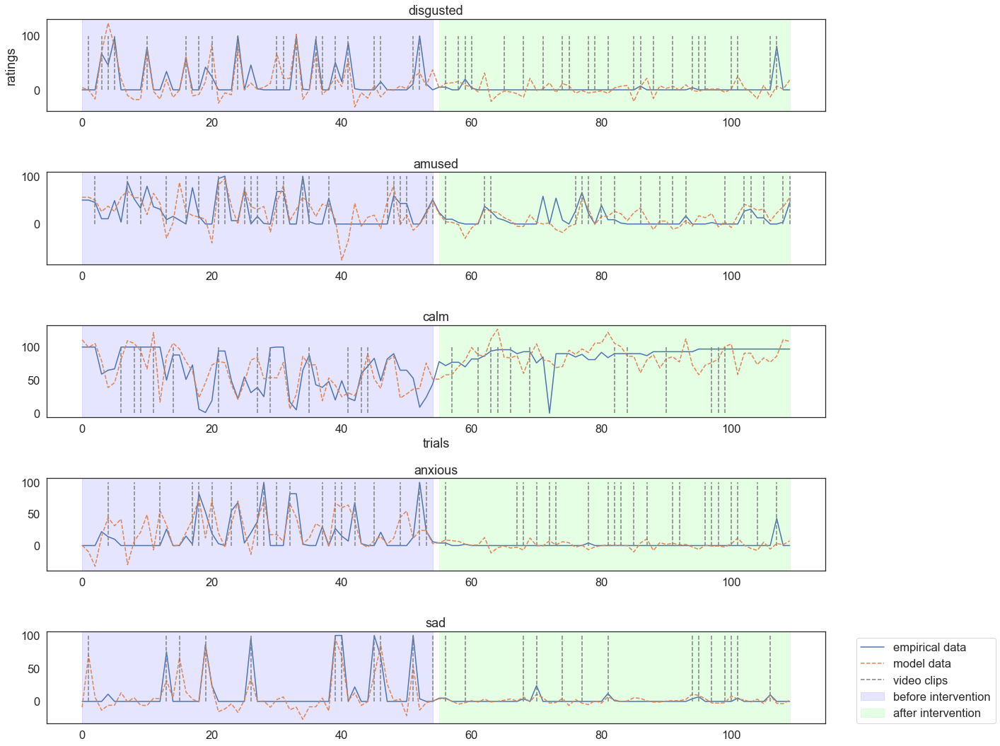

----------------------------------------------------------------------------------------------------
106 1.0


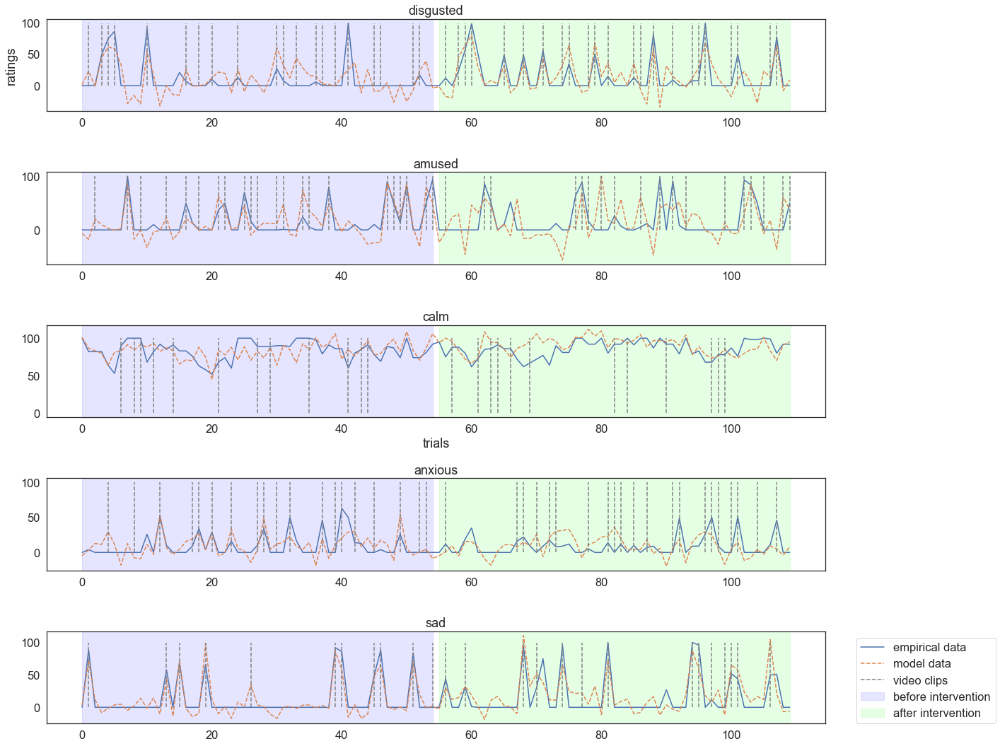

----------------------------------------------------------------------------------------------------
107 1.0


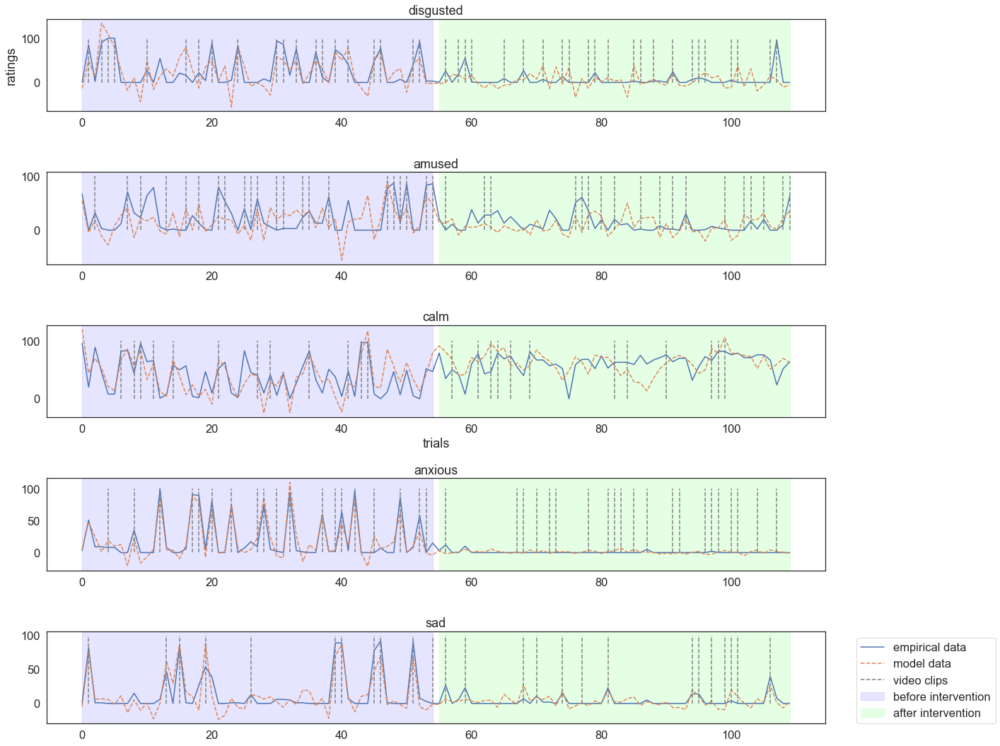

----------------------------------------------------------------------------------------------------


In [34]:
# show model fit
sns.set(style='white', font_scale=1.5)
# random_sub = np.random.randint(1,Nsj,3)
T = np.shape(data[0]['ratings'])[1]
for sj in range(Nsj):
    print(sj, df['randomized_condition'][sj])
    fig, axs = plt.subplots(len(mood_categories),1,figsize=[20,15])
    x = np.empty((T,5))
    for t in range(2):
        inp_split = inp[t*int(T/2):t*int(T/2) + int(T/2),:]
        z, x[t*int(T/2):t*int(T/2) + int(T/2),:] = \
        data[sj]['results_split'][13+t].sample(int(T/2),  initial_state=data[sj]['ratings'][:,t*int(T/2)], \
                                                control_inputs=inp_split)
        
    for k in range(len(mood_categories)):
        axs[k].plot(mood_ratings[:,k,sj]);
        axs[k].plot(x[:,k], linestyle='--');
        axs[k].set_title(mood_categories[k]);
        if k == 0 : axs[k].set_ylabel('ratings');
        if k == 2: axs[k].set_xlabel('trials');
        axs[k].vlines(np.where(inp[:,k]), ymin=0, ymax=100, color='gray', linestyles = 'dashed')
        ylim = axs[k].get_ylim()
        axs[k].add_patch(plt.Rectangle((0, ylim[0]), 54, np.abs(ylim[0]) + ylim[1], edgecolor=(0, 0, 1, 0.1), facecolor=(0, 0, 1, 0.1)))
        axs[k].add_patch(plt.Rectangle((55, ylim[0]), 54, np.abs(ylim[0]) + ylim[1], edgecolor=(0, 1, 0, 0.1), facecolor=(0, 1, 0, 0.1)))
    plt.legend(['empirical data','model data', 'video clips','before intervention', 'after intervention'], loc=(1.04,0))
    plt.tight_layout()
#     plt.savefig(filepath + 'results/figures/modelfit_normalized' + str(sj) + '.png')
    plt.show()
    print(100*'-')

In [28]:
# investigate outlier in parameter estimates
cc, dd, ss, gg = [np.full((5,5,len(data)), np.nan) for i in range(4)]
for i in range(len(data)):
    cc[:,:,i] = data[i]['results_split'][-1].control_matrix
    dd[:,:,i] = data[i]['results_split'][-1].transition_matrices
    gg[:,:,i] = data[i]['results_split'][-1].observation_covariance
    ss[:,:,i] = data[i]['results_split'][-1].transition_covariance

A outliers: [66 91]
C outliers: []
S outliers: [ 5 14 21 32 72 78 82 92]
G outliers: [19 21 35 37 60 72 81]


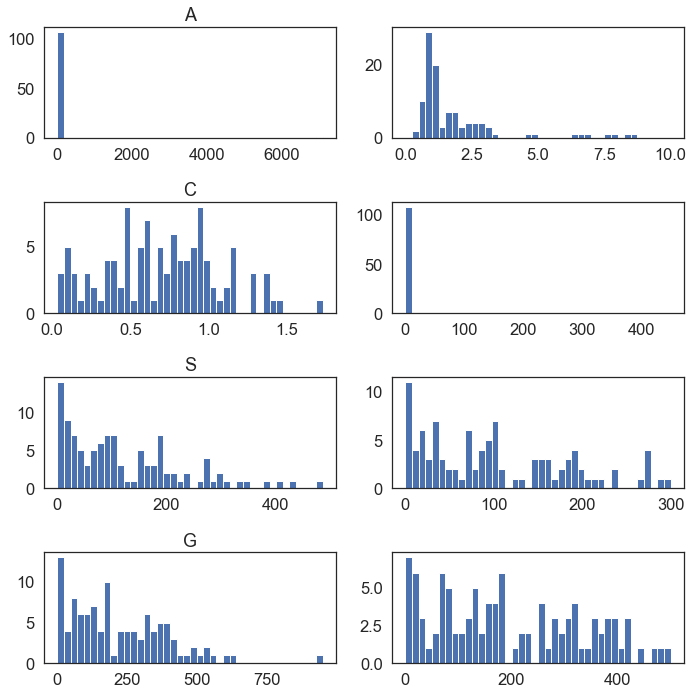

In [29]:
fig,ax = plt.subplots(4,2,figsize=(10,10))
cut = [10, 450, 300, 500]
label = ['A', 'C', 'S', 'G']
for j, i in enumerate([dd, cc, ss, gg]):
    ax[j, 0].hist(np.max(np.abs(i.reshape(25,Nsj)),axis=0), 40);
    ax[j, 0].set(title=label[j])
    ax[j, 1].hist(np.max(np.abs(i.reshape(25,Nsj)),axis=0), 40, range=(0,cut[j]));
    print(label[j] + ' outliers: ' + str(np.where(np.max(np.abs(i.reshape(25,Nsj)),axis=0)>cut[j])[0]))
fig.tight_layout()

In [30]:
np.save(filepath + 'results/fit_experiment_cowenratings.npy', data)